# Deep Learning With Pythong by Francois Chollet, second edition - Keras/JAX

# 0. Helper methods

In [93]:
# Check the number of GPUs, python, and keras version
import os
os.environ["KERAS_BACKEND"] = "jax"
# os.environ["JAX_DEBUG_NANS"] = "0"     # disables debugging NaNs
# os.environ["JAX_LOG_COMPILES"] = "0"   # disables logging of compilation details
# os.environ["JAX_SUPPRESS_WARNINGS"] = "1"  # suppresses non-critical warnings in JAX
import keras
print("Keras version:", keras.__version__)

import jax
print("Number of GPUs available:", jax.device_count())

import sys
print("Python version:", sys.version)

import numpy as np


# print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
# print("TensorFlow version:", tf.__version__)

# import tensorflow as tf
# from tensorflow import keras

# Check the current mixed_precision policy
# from tensorflow.keras import mixed_precision
# policy = mixed_precision.global_policy()
# print("Current mixed precision policy:", policy)

# Turn on mixed precision to speedup GPU training
# keras.mixed_precision.set_global_policy("mixed_float16")  

Keras version: 3.6.0
Number of GPUs available: 1
Python version: 3.10.15 | packaged by conda-forge | (main, Oct 16 2024, 01:24:20) [Clang 17.0.6 ]


In [94]:
# Encode the labels with one-hot encoding (categorical encoding), based on p107 function
# The labels is a list of integers, and each integer is converted to a one-hot vector
# labels : a list of integers, each one indicating its category
# dimension : the number of categories, max integer in the labels
# input (num_of_labels,) -> output of shape (num_of_labels, dimension)
def to_one_hot(labels, dimension=46):
    results = np.zeros((len(labels), dimension))
    for i, label in enumerate(labels):
        results[i, label] = 1.
    return results

def to_one_hot(labels, dimension=46):
    """Encodes labels into one-hot vectors, based on p107 function.

    Each integer (label) will be transformed into a vector of shape (dimension,)
    where only one index is 1.
    
    Args:
        labels: A list of integers of shape (num_labels,), where each integer represents a category.
        dimension: The number of categories.
    
    Returns:
        A numpy array of shape (num_labels, dimension) representing the one-hot encoded labels.
    """
    
    results = np.zeros((len(labels), dimension))
    for i, label in enumerate(labels):
      results[i, label] = 1.0
    return results

In [95]:
def vectorize_sequences_with_multi_hot(sequences, dimension=10000):
    """Converts a list of integer sequences into a multi-hot encoded 2D NumPy array, based on p98 function.

    Each sequence of varying length is transformed into a binary vector of fixed length (`dimension`), 
    where each index corresponds to whether a word (integer) is present in the sequence. 
    The ordering and the frequency information in the original sequence is lost in the output vector.

    Args:
        sequences : list of list of int of shape (num_of_sequences, varying_sequence_len)
            A list where each element is a sequence of integers (e.g., word indices).
        dimension : int, optional
            The size of the output vector, representing the maximum integer in the dict of the training data. 
            Default is 10000.

    Returns:
        np.ndarray
            A 2D array of shape (num_sequences, dimension), where each row is a 
            multi-hot encoded vector of a sequence.
    """
    results = np.zeros((len(sequences), dimension))  # Initialize 2D array
    for i, sequence in enumerate(sequences):         # Iterate over sequences
        for j in sequence:                           # Iterate over integers in the sequence
            results[i, j] = 1.                       # Mark the presence of the integer in the multi-hot vector
    return results


def to_multi_hot(sequence, dimension=10000):
    """Converts a single integer sequence into a multi-hot encoded 1D NumPy array.

    This function demonstrates the difference between one-hot encoding (vector of only one index being 1) 
    and multi-hot encoding (vector of multiple indices being 1). For an integer list, one-hot will generate
    a 2D array, but multi-hot will generate a 1D array. one-hot is typically used in categorical lables,
    multi-hot is used in encoding input tokens.

    Args:
        sequence : list of int
            A list of integers representing indices.
        dimension : int, optional
            The size of the output vector, representing the maximum index + 1. 
            Default is 10000.

    Returns:
        A 1D array of shape (dimension,) representing the multi-hot encoded sequence.
    """
    results = np.zeros((dimension,))  # Initialize 1D array
    for num in sequence:              # Iterate over integers in the sequence
        results[num] = 1.             # Mark the presence of the integer in the multi-hot vector
    return results


def vectorize_sequences_with_multi_hot2(sequences, dimension=10000):
    """Converts a list of integer sequences into a multi-hot encoded 2D NumPy array 
    using the `to_multi_hot` helper function.

    Args:
        sequences : list of list of int
            A list where each element is a sequence of integers (e.g., word indices).
        dimension : int, optional
            The size of the output vector, representing the maximum index + 1. 
            Default is 10000.

    Returns:
        np.ndarray
            A 2D array of shape (num_sequences, dimension), where each row is a 
            multi-hot encoded vector of a sequence.
    """
    results = np.zeros((len(sequences), dimension))  # Initialize 2D array
    for i, sequence in enumerate(sequences):         # Iterate over sequences
        results[i] = to_multi_hot(sequence, dimension)  # Use the helper function for multi-hot encoding
    return results


In [96]:
def decode_int_sequence_to_text(word_index_mapping, sequence):
    """Decodes a list of word indices back to words, based on p98 function.
    
    Args:
        word_index_mapping: A dictionary mapping words to their corresponding indices. It does NOT consider the 
                            three special tokens (0, 1, 2 for "padding", "start of sequence" and "unknown").
        sequence: A list of integers representing word indices, shifted by 3 (for 3 special tokens), 
                  compared with the corresponding int in the word_index_mapping.
    
    Returns:
        A string representing the decoded text.
    """
    
    reverse_word_index = {idx: word for word, idx in word_index_mapping.items()}
    
    # Indices are offset by 3 because 0, 1, 2 were used for "padding",
    # "start of sequence" and "unknown"
    return " ".join([reverse_word_index.get(i - 3, "?") for i in sequence]) # the sequence includes the 3 special tokens

In [97]:
import matplotlib.pyplot as plt
def plot_training_val_loss(history):
    """ Plot the training and validation loss, based on page 104 function

    Args:
        history: the History object, typically returned by model.fit()
    """
    plt.clf()
    history_dict = history.history
    loss_values = history_dict["loss"]
    val_loss_values = history_dict["val_loss"]
    epochs = range(1, len(loss_values) + 1)
    plt.plot(epochs, loss_values, "bo", label = "Training loss")
    plt.plot(epochs, val_loss_values, "b", label = "Validation loss")
    plt.title("Training and validation loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

In [98]:
def plot_training_val_accuracy(history):
    """Plot the training and validation accuracy, based on page 104 function

    Args:
        history: the History object, typically returned by model.fit()
    """
    plt.clf()
    history_dict = history.history
    acc = history_dict["accuracy"]
    val_acc = history_dict["val_accuracy"]
    epochs = range(1, len(acc) + 1)
    plt.plot(epochs, acc, "bo", label = "Training acc")
    plt.plot(epochs, val_acc, "b", label = "Validation acc")
    plt.title("Training and validation accuracy")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.show()

In [99]:
def plot_training_history(history, history_key1, history_key2=None):
    """Plot the training history for two keys, based on page 104 function

    Args:
        history: the History object, typically returned by model.fit()
        history_key1: one key in the history.hisotory dictionary
        history_key2: another key in the history.hisotory dictionary. The two keys can be a pair, such as "loss" and "val_loss",  "accuracy" and "val_accuracy" 
    
    """
    plt.clf()
    history_dict = history.history
    history_val1 = history_dict[history_key1]
    epochs = range(1, len(history_val1) + 1)
    plt.plot(epochs, history_val1, "bo", label = history_key1)
    if history_key2:
        history_val2 = history_dict[history_key2]
        plt.plot(epochs, history_val2, "b", label = history_key2)
    plt.title(f"Training {history_key1} and {history_key2}")
    plt.xlabel("Epochs")
    plt.ylabel(history_key1)
    plt.legend()
    plt.show()

# CH2 The mathematical building blocks of neural networks

In [11]:
# Loading the MNIST dataset in Keras
from keras.datasets import mnist

(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

print(f"image shape: {train_images.shape}")
print(f"num of train images: {len(train_images)}")
train_labels

image shape: (60000, 28, 28)
num of train images: 60000


array([5, 0, 4, ..., 5, 6, 8], dtype=uint8)

In [19]:
# A neural network architecture example for MNIST dataset
from keras import layers

model = keras.Sequential([
    layers.Dense(512, activation="relu"),
    layers.Dense(10, activation="softmax")
])

model.compile(optimizer="rmsprop",
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy"])

# prepare dataset
train_images = train_images.reshape((60000, 28 * 28)) # 3d to 2d
train_images = train_images.astype("float32") / 255   # normalization
test_images = test_images.reshape((10000, 28 * 28))
test_images = test_images.astype("float32") / 255

# train model
model.fit(train_images, train_labels, epochs=5, batch_size=128)

# evaluate the model on new data
test_loss, test_acc = model.evaluate(test_images, test_labels)
print(f"test accuray: {test_acc}")

# use the model for prediction
test_digits = test_images[0:10]
predictions = model.predict(test_digits)
predictions[0].argmax()

Epoch 1/5
110/469 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.1101 - loss: 2.3021

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]

469/469 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.1118 - loss: 2.3017
Epoch 2/5
107/469 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.1075 - loss: 2.3022

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]

469/469 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step - accuracy: 0.1104 - loss: 2.3018
Epoch 3/5
469/469 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.1128 - loss: 2.3016
Epoch 4/5
469/469 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.1123 - loss: 2.3013
Epoch 5/5
469/469 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.1124 - loss: 2.3012
225/313 ━━━━━━━━━━━━━━━━━━━━ 0s 694us/step - accuracy: 0.1172 - loss: 2.3009

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"


313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 771us/step - accuracy: 0.1160 - loss: 2.3010
test accuray: 0.11349999904632568
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[784,512]), ShapedArray(float32[512]), ShapedArray(float32[512,10]), ShapedArray(float32[10]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"


np.int64(1)

# CH3 Introduction to Keras and Tensorflow

## 3.5 Example: A linear classifier in pure JAX

In [20]:
# Generating two classes of random points in a 2D plane
num_samples_per_class = 1000

negative_samples = np.random.multivariate_normal(
    [0,3],  # mean
    [[1, 0.5], [0.5, 1]],  # cov
    num_samples_per_class) # size
    
positive_samples = np.random.multivariate_normal(
    [3,0],
    [[1, 0.5], [0.5, 1]],
    num_samples_per_class)

print(f'negative_samples.shape: {negative_samples.shape}')
print(f'positive_samples.shape: {positive_samples.shape}')

print(f'negative_samples[0]: {negative_samples[0]}')
print(f'positive_samples[0]: {positive_samples[0]}')

negative_samples.shape: (1000, 2)
positive_samples.shape: (1000, 2)
negative_samples[0]: [-0.39400163  1.25975649]
positive_samples[0]: [ 0.72665826 -0.80567854]


In [21]:
# Generates inputs and targets
inputs = np.vstack((negative_samples, positive_samples)).astype(np.float32)
targets = np.vstack((
    np.zeros((num_samples_per_class, 1), dtype="float32"),
    np.ones((num_samples_per_class, 1), dtype="float32")
))

print(f'inputs.shape: {inputs.shape}')
print(f'targets.shape: {targets.shape}')

inputs.shape: (2000, 2)
targets.shape: (2000, 1)


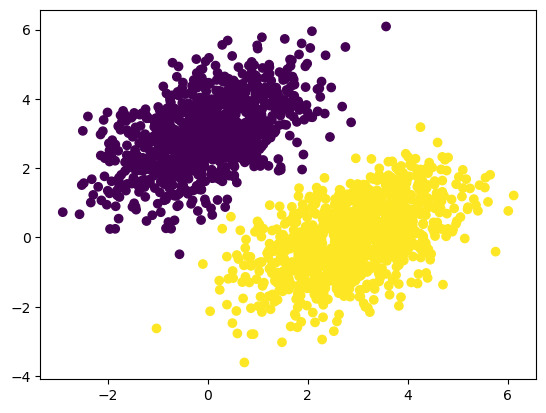

In [22]:
# Plot the two point classes
import matplotlib.pyplot as plt

plt.scatter(inputs[:, 0], inputs[:, 1], c=targets[:, 0])
plt.show()

In [30]:
## Creating the linear classifier using JAX
import jax
import jax.numpy as jnp
from jax import grad

input_dim = 2
output_dim = 1

# Initialize weights and biases
key = jax.random.PRNGKey(0)  # Initialize PRNG (pseudorandom number generator) key with seed 0
W = jax.random.uniform(key, (input_dim, output_dim))
b = jnp.zeros(output_dim)

# the forward pass function
def model(inputs, W, b):
    return jnp.dot(inputs, W) + b

# the loss function (mean squared error)
def square_loss(targets, predictions):
    return jnp.mean((targets - predictions) ** 2)

# the training step function
learning_rate = 0.1

def training_step(W, b, inputs, targets):
    loss_fn = lambda W, b : square_loss(targets, model(inputs, W, b))
    # argnums=(0, 1) tells grad to compute the gradient with respect to both the first argument (W) and the second argument (b) of loss_fn
    grad_loss_fn = grad(loss_fn, argnums=(0, 1))
    grads = grad_loss_fn(W, b)
    
    W -= learning_rate * grads[0]
    b -= learning_rate * grads[1]

    return W, b, loss_fn(W, b)

# the batch training loop (not mini-batch)
for step in range(40):
    W, b, loss = training_step(W, b, inputs, targets)
    print(f"Loss at step {step}: {loss:.4f}")

Loss at step 0: 0.3233
Loss at step 1: 0.1476
Loss at step 2: 0.1216
Loss at step 3: 0.1111
Loss at step 4: 0.1029
Loss at step 5: 0.0956
Loss at step 6: 0.0890
Loss at step 7: 0.0830
Loss at step 8: 0.0775
Loss at step 9: 0.0726
Loss at step 10: 0.0682
Loss at step 11: 0.0641
Loss at step 12: 0.0604
Loss at step 13: 0.0571
Loss at step 14: 0.0541
Loss at step 15: 0.0514
Loss at step 16: 0.0489
Loss at step 17: 0.0467
Loss at step 18: 0.0446
Loss at step 19: 0.0428
Loss at step 20: 0.0411
Loss at step 21: 0.0396
Loss at step 22: 0.0382
Loss at step 23: 0.0370
Loss at step 24: 0.0359
Loss at step 25: 0.0348
Loss at step 26: 0.0339
Loss at step 27: 0.0331
Loss at step 28: 0.0323
Loss at step 29: 0.0316
Loss at step 30: 0.0310
Loss at step 31: 0.0304
Loss at step 32: 0.0299
Loss at step 33: 0.0294
Loss at step 34: 0.0290
Loss at step 35: 0.0286
Loss at step 36: 0.0283
Loss at step 37: 0.0280
Loss at step 38: 0.0277
Loss at step 39: 0.0274


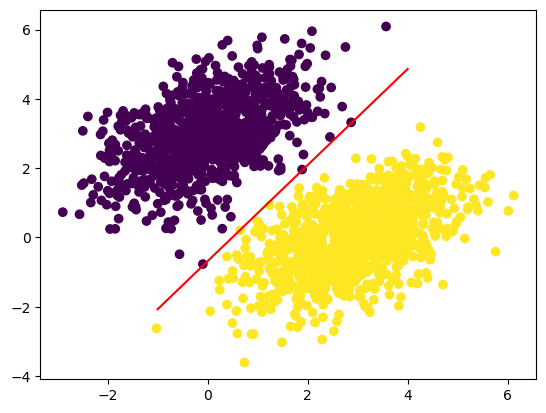

In [34]:
# Prediction and display the W and b as a line
predictions = model(inputs, W, b)

x = np.linspace(-1, 4, 100)             # x type is numpy.ndarray of shape (100,)
y = -W[0] / W[1] * x + (0.5 - b) / W[1] # W[0], W[1] and b have shape (1,), y has shape of (100,), broadcasting make them compatible
plt.plot(x, y, "-r")     # red line
plt.scatter(inputs[:, 0], inputs[:, 1], c=predictions[:, 0] > 0.5)
plt.show()

## 3.6 Anatomy of a neural network: understanding core Keras APIs

### 3.6.1 Layers: the building blocks of deep learning

In [37]:
# A dense layer implemented as a Layer subclass
class SimpleDense(keras.layers.Layer):
    def __init__(self, units, activation=None):
        super().__init__()
        self.units = units  # output units, the num of output dimensions
        self.activation = activation

    def build(self, input_shape):
        """weight creation takes place in build()
        """
        input_dim = input_shape[-1]
        self.W = self.add_weight(shape=(input_dim, self.units),  # add_weight is a method from parent class
                                initializer="random_normal")
        self.b = self.add_weight(shape=(self.units,),
                                initializer="zeros")

    def call(self, inputs):
        """define the forward pass computation in the call
        """
        y = jnp.dot(inputs, self.W) + self.b
        if self.activation is not None:
            y = self.activation(y)
        return y

my_dense = SimpleDense(units=32, activation=jax.nn.relu)
input_tensor = jnp.ones(shape=(2, 784))
output_tensor = my_dense(input_tensor)  # here it using __call__(), not call() to create the weights only first time. see page 86 for explanation
print(output_tensor.shape)

(2, 32)


# CH4 Classification and regression

## 4.1 Classifying movie reviews: A binary classification example (IMDB dataset)

In [51]:
# Each review example is associated with either a positive (integer 1) or negative result (integer 0)
from keras.datasets import imdb
(train_data, train_labels), (test_data, test_labels) = imdb.load_data(num_words=10000) # only keep the top 10000 most frequent words

print(f"type(train_data): {type(train_data)}")
print(f"train_data.dtype: {train_data.dtype}")        # this is not typical, its elements' type is list instead of numpy.ndarray
print(f"type(train_data[0]): {type(train_data[0])}")  # text is preprocessed into sequences of integers (word indices) based on a dictionary
print(f"type(train_labels): {type(train_labels)}")
print(f"train_labels.dtype: {train_labels.dtype}")
print()

print(f"train_data.shape: {train_data.shape}")
print(f"train_labels.shape: {train_labels.shape}")
print(f"test_data.shape: {test_data.shape}")
print(f"test_labels.shape: {test_labels.shape}")

type(train_data): <class 'numpy.ndarray'>
train_data.dtype: object
type(train_data[0]): <class 'list'>
type(train_labels): <class 'numpy.ndarray'>
train_labels.dtype: int64

train_data.shape: (25000,)
train_labels.shape: (25000,)
test_data.shape: (25000,)
test_labels.shape: (25000,)


In [53]:
# Different samples can have different length
print(f"train_data[0] length: {len(train_data[0])}")
print(f"train_data[1] length: {len(train_data[1])}")

# the train_data and test_data integers are increased by 3 to make room for special tokens, and they are not padded to be same length
print(f"First train data sequence: {train_data[0]}")
print(f"First train label: {train_labels[0]}")  # 0 for negative and 1 for positive

# decoding newswires back to text
word_index = imdb.get_word_index()
text = decode_int_sequence_to_text(word_index, train_data[0])
text

train_data[0] length: 218
train_data[1] length: 189
First train data sequence: [1, 14, 22, 16, 43, 530, 973, 1622, 1385, 65, 458, 4468, 66, 3941, 4, 173, 36, 256, 5, 25, 100, 43, 838, 112, 50, 670, 2, 9, 35, 480, 284, 5, 150, 4, 172, 112, 167, 2, 336, 385, 39, 4, 172, 4536, 1111, 17, 546, 38, 13, 447, 4, 192, 50, 16, 6, 147, 2025, 19, 14, 22, 4, 1920, 4613, 469, 4, 22, 71, 87, 12, 16, 43, 530, 38, 76, 15, 13, 1247, 4, 22, 17, 515, 17, 12, 16, 626, 18, 2, 5, 62, 386, 12, 8, 316, 8, 106, 5, 4, 2223, 5244, 16, 480, 66, 3785, 33, 4, 130, 12, 16, 38, 619, 5, 25, 124, 51, 36, 135, 48, 25, 1415, 33, 6, 22, 12, 215, 28, 77, 52, 5, 14, 407, 16, 82, 2, 8, 4, 107, 117, 5952, 15, 256, 4, 2, 7, 3766, 5, 723, 36, 71, 43, 530, 476, 26, 400, 317, 46, 7, 4, 2, 1029, 13, 104, 88, 4, 381, 15, 297, 98, 32, 2071, 56, 26, 141, 6, 194, 7486, 18, 4, 226, 22, 21, 134, 476, 26, 480, 5, 144, 30, 5535, 18, 51, 36, 28, 224, 92, 25, 104, 4, 226, 65, 16, 38, 1334, 88, 12, 16, 283, 5, 16, 4472, 113, 103, 32, 15, 16, 

"? this film was just brilliant casting location scenery story direction everyone's really suited the part they played and you could just imagine being there robert ? is an amazing actor and now the same being director ? father came from the same scottish island as myself so i loved the fact there was a real connection with this film the witty remarks throughout the film were great it was just brilliant so much that i bought the film as soon as it was released for ? and would recommend it to everyone to watch and the fly fishing was amazing really cried at the end it was so sad and you know what they say if you cry at a film it must have been good and this definitely was also ? to the two little boy's that played the ? of norman and paul they were just brilliant children are often left out of the ? list i think because the stars that play them all grown up are such a big profile for the whole film but these children are amazing and should be praised for what they have done don't you th

In [54]:
## Data preparation
# Vectorization via multi_hot encoding, all samples will be converted into a vector of the same shape
x_train = vectorize_sequences_with_multi_hot(train_data, dimension=10000)
x_test = vectorize_sequences_with_multi_hot(test_data, dimension=10000)
print(f"x_train[0]: {x_train[0]}")
print(f"x_train.dtype: {x_train.dtype}")
print(f"x_test.dtype: {x_test.dtype}")
print(f"train_data[0].shape: {x_train[0].shape}")  # now each sample is a ndarray instead of list in original train_data
print(f"train_data[1].shape: {x_train[1].shape}")

# Convet labels' datatype from int64 to float32
y_train = train_labels.astype("float32")
y_test = test_labels.astype("float32")

# Split the train data into partial_train and valuation data
partial_x_train = x_train[10000:]
x_val = x_train[:10000]

partial_y_train = y_train[10000:]
y_val = y_train[:10000]

x_train[0]: [0. 1. 1. ... 0. 0. 0.]
x_train.dtype: float64
x_test.dtype: float64
train_data[0].shape: (10000,)
train_data[1].shape: (10000,)


In [60]:
# Build the model
from keras import layers

model = keras.Sequential([
    layers.Dense(16, activation="relu"),
    layers.Dense(16, activation="relu"),
    layers.Dense(1, activation="sigmoid")
])

model.compile(
    optimizer="rmsprop",
    loss="binary_crossentropy", 
    metrics=["accuracy"]
)

In [56]:
# Train the model
history = model.fit(
    partial_x_train,
    partial_y_train,
    epochs=20,
    batch_size=512,
    validation_data=(x_val, y_val)
)

Epoch 1/20
14/30 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6442 - loss: 0.6511 

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"


30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.7024 - loss: 0.6059

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"


30/30 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.7049 - loss: 0.6037 - val_accuracy: 0.8628 - val_loss: 0.4148
Epoch 2/20


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), Shape

27/30 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8887 - loss: 0.3639

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[10000,16]), ShapedArray(float32[16]), ShapedArray(float32[16,16]), ShapedArray(float32[16]), ShapedArray(float32[16,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"


30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.8888 - loss: 0.3610 - val_accuracy: 0.8584 - val_loss: 0.3530
Epoch 3/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9168 - loss: 0.2548 - val_accuracy: 0.8851 - val_loss: 0.2943
Epoch 4/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.9319 - loss: 0.2037 - val_accuracy: 0.8692 - val_loss: 0.3185
Epoch 5/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9458 - loss: 0.1684 - val_accuracy: 0.8867 - val_loss: 0.2831
Epoch 6/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.9598 - loss: 0.1378 - val_accuracy: 0.8774 - val_loss: 0.3080
Epoch 7/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9615 - loss: 0.1260 - val_accuracy: 0.8853 - val_loss: 0.2927
Epoch 8/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9739 - loss: 0.0991 - val_accuracy: 0.8836 - val_loss: 0.3052
Epoch 9/20
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.9771 - loss: 0.0839 - val_accuracy: 0.8752 - val_loss: 0.3411
Ep

In [58]:
# Evaluate model performance and use it for inference
results = model.evaluate(x_test, y_test)    # [val_loss, val_accuracy]
model.predict(x_test)

782/782 ━━━━━━━━━━━━━━━━━━━━ 1s 731us/step - accuracy: 0.8508 - loss: 0.6123
782/782 ━━━━━━━━━━━━━━━━━━━━ 0s 417us/step


array([[0.00920029],
       [0.9999951 ],
       [0.7967851 ],
       ...,
       [0.00233134],
       [0.005691  ],
       [0.7960429 ]], dtype=float32)

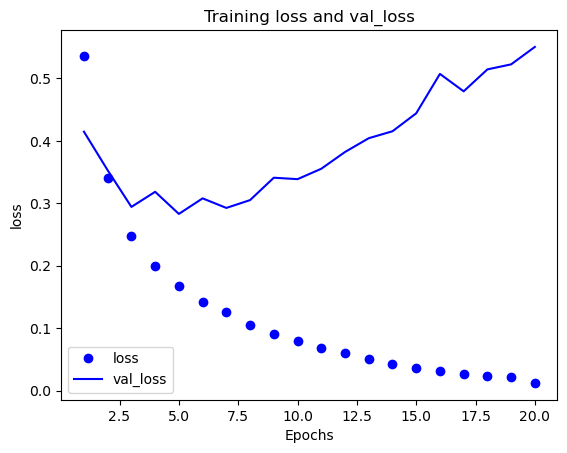

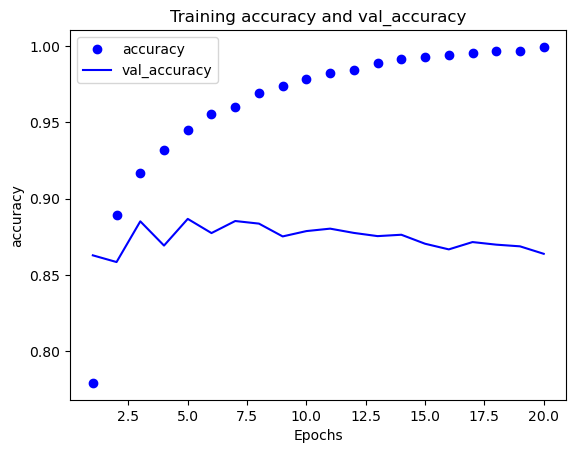

In [59]:
# Plot loss and accuracy from history
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

## 4.2 Classifying newswires: A single-label multiclass classification example

In [79]:
# There are 46 different topics/labels, each example is associated with only one topic
from keras.datasets import reuters
(train_data, train_labels), (test_data, test_labels) = reuters.load_data(num_words=10000)

print(f"train_data.shape: {train_data.shape}")
print(f"train_labels.shape: {train_labels.shape}")
print(f"test_data.shape: {test_data.shape}")
print(f"test_labels.shape: {test_labels.shape}")   # label is an integer from 0 to 45, totaling 46 classes


train_data.shape: (8982,)
train_labels.shape: (8982,)
test_data.shape: (2246,)
test_labels.shape: (2246,)


In [80]:
# Sampels have different length
print(f"train_data[0] length: {len(train_data[0])}")
print(f"train_data[1] length: {len(train_data[1])}")

# Decode newswires back to text
word_index = reuters.get_word_index()

text = decode_int_sequence_to_text(word_index, train_data[0])
print(f"train_data[0]: {train_data[0]}")
print(f"train_data[0] text: {text}")
print(f"train_labels[0]: {train_labels[0]}")

train_data[0] length: 87
train_data[1] length: 56
train_data[0]: [1, 2, 2, 8, 43, 10, 447, 5, 25, 207, 270, 5, 3095, 111, 16, 369, 186, 90, 67, 7, 89, 5, 19, 102, 6, 19, 124, 15, 90, 67, 84, 22, 482, 26, 7, 48, 4, 49, 8, 864, 39, 209, 154, 6, 151, 6, 83, 11, 15, 22, 155, 11, 15, 7, 48, 9, 4579, 1005, 504, 6, 258, 6, 272, 11, 15, 22, 134, 44, 11, 15, 16, 8, 197, 1245, 90, 67, 52, 29, 209, 30, 32, 132, 6, 109, 15, 17, 12]
train_data[0] text: ? ? ? said as a result of its december acquisition of space co it expects earnings per share in 1987 of 1 15 to 1 30 dlrs per share up from 70 cts in 1986 the company said pretax net should rise to nine to 10 mln dlrs from six mln dlrs in 1986 and rental operation revenues to 19 to 22 mln dlrs from 12 5 mln dlrs it said cash flow per share this year should be 2 50 to three dlrs reuter 3
train_labels[0]: 3


In [87]:
## Data preparation
# Encode the input data by vectorizing the data using multi-hot encoding, each sample of int sequence is converted to a multi-hop vector
x_train = vectorize_sequences_with_multi_hot(train_data, dimension=10000)
x_test = vectorize_sequences_with_multi_hot(test_data, dimension=10000)

# Encode the labels with one-hot encoding (categorical encoding), each integer in the sequence is converted to a vector
y_train = to_one_hot(train_labels, dimension=46)
y_test = to_one_hot(test_labels, dimension=46)

# Split data
partial_x_train = x_train[1000:]
x_val = x_train[:1000]

partial_y_train = y_train[1000:]
y_val = y_train[:1000]

In [88]:
# Build model
model = keras.Sequential([
    layers.Dense(64, activation="relu"),
    layers.Dense(64, activation="relu"),
    layers.Dense(46, activation="softmax")  # 46 is the num of classification classes
])

model.compile(optimizer="rmsprop",
              loss="categorical_crossentropy",
              metrics=["accuracy"])

In [89]:
# Train the model
history = model.fit(partial_x_train,
                    partial_y_train,
                    epochs=20,
                    batch_size=512,
                    validation_data=(x_val, y_val))

# test data evaluation
results = model.evaluate(x_test, y_test)
results

Epoch 1/20
15/16 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.3318 - loss: 3.3801 

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: Sha

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.3486 - loss: 3.3204 - val_accuracy: 0.5970 - val_loss: 1.9525
Epoch 2/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6243 - loss: 1.7571 - val_accuracy: 0.6570 - val_loss: 1.4613
Epoch 3/20


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(int32[]), ShapedArray(float32[]), Sha

16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.7174 - loss: 1.2820 - val_accuracy: 0.7300 - val_loss: 1.2505
Epoch 4/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7692 - loss: 1.0417 - val_accuracy: 0.7460 - val_loss: 1.1526
Epoch 5/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8058 - loss: 0.8821 - val_accuracy: 0.7670 - val_loss: 1.0687
Epoch 6/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8342 - loss: 0.7646 - val_accuracy: 0.7770 - val_loss: 1.0079
Epoch 7/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8621 - loss: 0.6357 - val_accuracy: 0.7880 - val_loss: 0.9543
Epoch 8/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8923 - loss: 0.5227 - val_accuracy: 0.7800 - val_loss: 0.9320
Epoch 9/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9054 - loss: 0.4592 - val_accuracy: 0.7950 - val_loss: 0.8949
Epoch 10/20
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9212 - loss: 0.3805 - val_accuracy: 0.8050 - val_loss: 0.8903
Ep

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), S

[1.024885892868042, 0.7871772050857544]

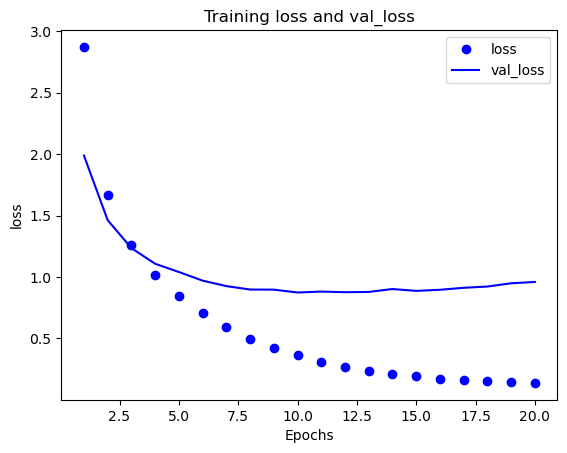

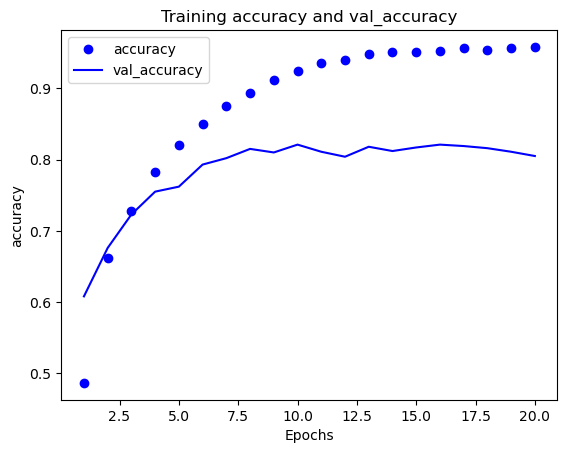

In [70]:
# Plot loss and accuracy from history
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [71]:
# Retraining a model from scratch using all training data
model = keras.Sequential([
    layers.Dense(64, activation="relu"),
    layers.Dense(64, activation="relu"),
    layers.Dense(46, activation="softmax")
])

model.compile(optimizer="rmsprop",
              loss="categorical_crossentropy",
              metrics=["accuracy"])

history = model.fit(x_train,
                    y_train,
                    epochs=9,
                    batch_size=512)

results = model.evaluate(x_test, y_test)
results

Epoch 1/9
15/18 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.3879 - loss: 3.1594 

/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: Sha

18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 22ms/step - accuracy: 0.4143 - loss: 3.0297
Epoch 2/9
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.6773 - loss: 1.5298
Epoch 3/9


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"


18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7463 - loss: 1.1486
Epoch 4/9
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.7949 - loss: 0.9302
Epoch 5/9
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8302 - loss: 0.7881
Epoch 6/9
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8616 - loss: 0.6353 
Epoch 7/9
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8932 - loss: 0.5127
Epoch 8/9
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.9055 - loss: 0.4427
Epoch 9/9
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9209 - loss: 0.3594
71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8031 - loss: 0.8772  


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[10000,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,46]), ShapedArray(float32[46]), ShapedArray(float32[]), ShapedArray(float32[]), S

[0.9092848300933838, 0.790739119052887]

In [72]:
# generate predictions on new data
predictions = model.predict(x_test)

print(predictions[0].shape)

print(f"Predicted class for first sample: {np.argmax(predictions[0])}")
print(f"Actual label for first sample: {test_labels[0]}")

71/71 ━━━━━━━━━━━━━━━━━━━━ 0s 525us/step
(46,)
Predicted class for first sample: 3
Actual label for first sample: 3


## 4.3 Predicting house prices: A regression example

In [100]:
# Predict house price using 13 features
from keras.datasets import boston_housing
(train_data, train_targets), (test_data, test_targets) = (boston_housing.load_data())

# There are relatively few data points : 404 training samples and 102 test samples
print(f"train_data.shape: {train_data.shape}")
print(f"train_targets.shape: {train_targets.shape}")
print(f"test_data.shape: {test_data.shape}")
print(f"test_targets.shape: {test_targets.shape}")   

# The prices are in thousand $
train_targets[:10]

train_data.shape: (404, 13)
train_targets.shape: (404,)
test_data.shape: (102, 13)
test_targets.shape: (102,)


array([15.2, 42.3, 50. , 21.1, 17.7, 18.5, 11.3, 15.6, 15.6, 14.4])

In [101]:
# Preparing data by feature-wise normalization to avoid feeding data of widely different ranges
mean = train_data.mean(axis=0)
train_data -= mean
std = train_data.std(axis=0)
train_data /= std

test_data -= mean    # test data normalization using train data mean and std
test_data /= std

In [102]:
# Build model, a small model of one or two layers helps mitigate overfitting for less training data
from keras import layers

def build_boston_model():
    """construct a fresh dense model for regression

    Returns:
        the model object with three dense layers
    """
    model = keras.Sequential([
      layers.Dense(64, activation="relu"),
      layers.Dense(64, activation="relu"),
      layers.Dense(1),
    ])
    
    model.compile(
      optimizer="rmsprop",
      loss="mse",
      metrics=["mae"])
    
    return model

In [99]:
# Clear any logs from previous runs
!rm -rf ./tensorflowlog/

# Create log directory
log_dir="./tensorflowlog/ch4"
!mkdir -p {log_dir}   # create the log dir if it doesn't exist

In [91]:
# Use TensorBoard to monitor training progress
%load_ext tensorboard

In [100]:
# Cannot use variable log_dir, have to use the exact name ./tensorflowlog; if start with empty log folder, may not display?
%tensorboard --logdir ./tensorflowlog --bind_all  

Reusing TensorBoard on port 6006 (pid 21128), started 0:32:42 ago. (Use '!kill 21128' to kill it.)

In [105]:
# K-fold validation with W&B
import datetime
import wandb

# Initialize W&B project
wandb.init(project="house-prices-k-fold-validation", name="boston-housing")

# Custom callback for W&B logging
class WandbCallback(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        wandb.log({
            "train_loss": logs.get('loss'),
            "train_accuracy": logs.get('accuracy'),
            "val_loss": logs.get('val_loss'),
            "val_accuracy": logs.get('val_accuracy')
        })

k = 4
num_val_samples = len(train_data) // k
num_epochs = 500
all_mae_histories = []

for i in range(k):
    print(f"Processing fold #{i}")
    
    # Log fold info
    wandb.run.name = f"fold_{i}_{datetime.datetime.now().strftime('%Y%m%d-%H%M%S')}"
    wandb.config.fold_number = i
    
    val_data = train_data[i * num_val_samples : (i + 1) * num_val_samples]
    val_targets = train_targets[i * num_val_samples : (i + 1) * num_val_samples]
    partial_train_data = np.concatenate(
      [train_data[:i * num_val_samples], 
       train_data[(i + 1) * num_val_samples:]],
      axis=0
    )
    partial_train_targets = np.concatenate(
      [train_targets[:i * num_val_samples], 
       train_targets[(i + 1) * num_val_samples:]],
      axis=0
    )
    
    model = build_boston_model()
        
    history = model.fit(
      partial_train_data,
      partial_train_targets,
      epochs=num_epochs,
      batch_size=16,
      verbose=0,   # train in silent mode
      validation_data=(val_data, val_targets),
      callbacks=[WandbCallback()]  # W&B Callback to log metrics
    )
    
    mae_history = history.history["val_mae"]  # a list of val_mae for each epoch
    all_mae_histories.append(mae_history)

wandb.finish()  # Finish the W&B run after training

avg_mae_history = [
    np.mean([one_fold_history[i] for one_fold_history in all_mae_histories]) 
    for i in range(num_epochs)
]

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········


wandb: Appending key for api.wandb.ai to your netrc file: /Users/guang/.netrc


Processing fold #0


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(f

Processing fold #1


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(f

Processing fold #2


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(f

Processing fold #3


/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(int32[]), ShapedArray(float32[]), ShapedArray(float32[13,64]), ShapedArray(float32[64]), ShapedArray(float32[64,64]), ShapedArray(float32[64]), ShapedArray(float32[64,1]), ShapedArray(float32[1]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]), ShapedArray(float32[]).
Donation is not implemented for ('METAL',).
See an explanation at https://jax.readthedocs.io/en/latest/faq.html#buffer-donation.
  warnings.warn("Some donated buffers were not usable:"
/Volumes/App/micromamba/envs/jupyter_py310_jax_GPU/lib/python3.10/site-packages/jax/_src/interpreters/mlir.py:1114: UserWarning: Some donated buffers were not usable: ShapedArray(f

train_loss,▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃▂▁▁▁▁▁▁▁▁▁█▂▂▁▁▁▁▁
val_loss,▁▁▁▁▁▆▃▄▄▅▄▅▅▆▅▇█▆▆▆▆▆▆▆▆▆▆▆▅▅▅▅▅▄▄▄▅▅▆▆
train_loss,1.26532
val_loss,12.45741


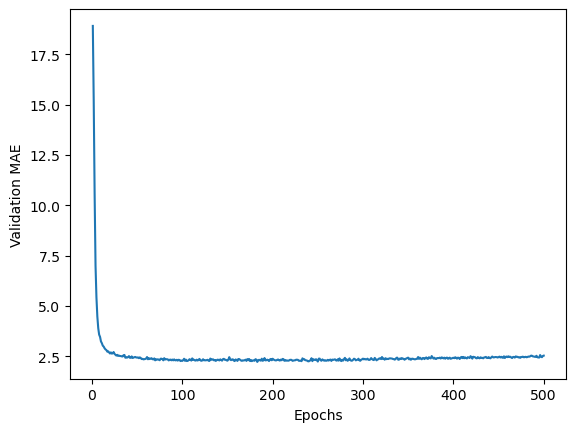

In [106]:
# Plot validation scores of mae (metrics) for each epoch across all folds
plt.clf()
plt.plot(range(1, len(avg_mae_history) + 1), avg_mae_history)
plt.xlabel("Epochs")
plt.ylabel("Validation MAE")
plt.show()

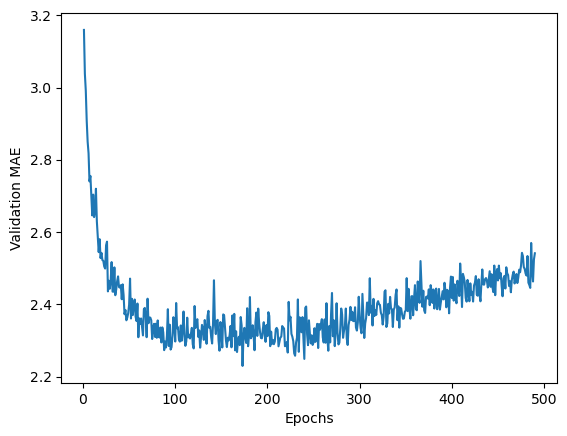

In [107]:
# Plot validation scores, excluding the first 10 data points
truncated_mae_history = avg_mae_history[10:]
plt.clf()
plt.plot(range(1, len(truncated_mae_history) + 1), truncated_mae_history)
plt.xlabel("Epochs")
plt.ylabel("Validation MAE")
plt.show()

In [104]:
# Train the final model with all train data
model = build_boston_model()

model.fit(
    train_data,
    train_targets,
    epochs=130,   # this is selected based on previous training results
    batch_size=16,
    verbose=0
)

test_mse_score, test_mae_score = model.evaluate(test_data, test_targets)
test_mse_score, test_mae_score

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 12.5296 - mae: 2.4635


(16.65731430053711, 2.6336400508880615)

In [105]:
# Generate predictions
predictions = model.predict(test_data)
print(f"model predictions[0]: {predictions[0]}")
print(f"test_targets[0]: {test_targets[0]}")

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
model predictions[0]: [8.904477]
test_targets[0]: 7.2


# CH7 Working with Keras: A deep drive

## 7.2 Different ways to build Keras models 

### 7.2.1 The Sequential model

In [10]:
# The Sequantial cclass
from tensorflow import keras
from tensorflow.keras import layers

model = keras.Sequential([
    layers.Dense(64, activation="relu"),
    layers.Dense(10, activation="softmax")
])

# incrementally build a Sequantial model
model = keras.Sequential(name="my_example_model")
model.add(layers.Dense(64, activation="relu", name="my_first_layer"))
model.add(layers.Dense(10, activation="softmax", name="my_second_layer"))

model.build(input_shape=(None, 3))
model.summary()

Model: "my_example_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ my_first_layer (Dense)          │ (None, 64)             │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ my_second_layer (Dense)         │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 906 (3.54 KB)

 Trainable params: 906 (3.54 KB)

 Non-trainable params: 0 (0.00 B)

In [123]:
# specify the model input shape in advance
model = keras.Sequential()
model.add(keras.Input(shape=(3,)))
model.add(layers.Dense(64, activation="relu", name="my_first_layer"))
model.summary()
model.add(layers.Dense(10, activation="softmax", name="my_second_layer"))
model.summary()

Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ my_first_layer (Dense)          │ (None, 64)             │           256 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 256 (1.00 KB)

 Trainable params: 256 (1.00 KB)

 Non-trainable params: 0 (0.00 B)

Model: "sequential_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ my_first_layer (Dense)          │ (None, 64)             │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ my_second_layer (Dense)         │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 906 (3.54 KB)

 Trainable params: 906 (3.54 KB)

 Non-trainable params: 0 (0.00 B)

### 7.2.2 The Functional API

In [11]:
# A simple Functional model with two Dense layers
inputs = keras.Input(shape=(3,), name="my_input")
features = layers.Dense(64, activation="relu")(inputs)
outputs = layers.Dense(10, activation="softmax")(features)
model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ my_input (InputLayer)           │ (None, 3)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 906 (3.54 KB)

 Trainable params: 906 (3.54 KB)

 Non-trainable params: 0 (0.00 B)

In [30]:
# A multi-input, multi-output Functional model for customer support ticket
vocabulary_size = 10_000   # max vocabs for the text (title and body of ticket)
num_tags = 100       # tag is added to the ticket by the user, categorical input and can be represented by one-hot
num_deparments = 4   # approprirate department to process the ticket

# define model inputs
title = keras.Input(shape=(vocabulary_size,), name="title")
text_body = keras.Input(shape=(vocabulary_size,), name="text_body")
tags = keras.Input(shape=(num_tags,), name="tags")

# combine input features into a single tensor by concatenating them
features = layers.Concatenate()([title, text_body, tags])  

# intermediate layer to recombine input features into richer representations
features = layers.Dense(64, activation="relu")(features)

# define model outputs
priority = layers.Dense(1, activation="sigmoid", name="priority")(features)
department = layers.Dense(num_deparments, activation="softmax", name="department")(features)

model = keras.Model(inputs=[title, text_body, tags], outputs=[priority, department])

model.summary()

Model: "functional_13"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ title (InputLayer)  │ (None, 10000)     │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ text_body           │ (None, 10000)     │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ tags (InputLayer)   │ (None, 100)       │          0 │ -                 │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_2       │ (None, 20100)     │          0 │ title[0][0],      │
│ (Concatenate)       │                   │            │ text_body[0][0],  │
│                     │                   │            │ tags[0][0]        │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_8 (Dense)     │ (None, 64)        │  1,286,464 │ concatenate_2[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ priority (Dense)    │ (None, 1)         │         65 │ dense_8[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ department (Dense)  │ (None, 4)         │        260 │ dense_8[0][0]     │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 1,286,789 (4.91 MB)

 Trainable params: 1,286,789 (4.91 MB)

 Non-trainable params: 0 (0.00 B)

In [34]:
# Training a model by providing lists of input and target arrays
import numpy as np

num_samples = 1200

# dummy input data
title_data = np.random.randint(0, 2, size=(num_samples, vocabulary_size))
text_body_data = np.random.randint(0, 2, size=(num_samples, vocabulary_size))
tags_data = np.random.randint(0, 2, size=(num_samples, num_tags))

# dummy target data
priority_data = np.random.random(size=(num_samples, 1))
department_data = np.random.randint(0, 2, size=(num_samples, num_deparments))

# compile model
model.compile(optimizer="rmsprop",
             loss=["mean_squared_error", "categorical_crossentropy"],  # one for each output, order matches to the order in keras.Model
             metrics=[["mean_absolute_error"], ["accuracy"]])          # one for each output

# train model
model.fit([title_data, text_body_data, tags_data],
          [priority_data, department_data],
           epochs=2)

model.evaluate([title_data, text_body_data, tags_data],
              [priority_data, department_data])

priority_preds, department_preds = model.predict([title_data, text_body_data, tags_data])

Epoch 1/2
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - department_accuracy: 0.2309 - loss: 32.7818 - priority_mean_absolute_error: 0.4872
Epoch 2/2
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - department_accuracy: 0.2353 - loss: 25.1858 - priority_mean_absolute_error: 0.5003
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - department_accuracy: 0.1131 - loss: 43.5298 - priority_mean_absolute_error: 0.4917
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


In [127]:
# Training a model by providing dicts of input and target arrays
# using the names given to the Input objects and the output layers
# - three Inputs names: title, text_body, tags
# - two output layers names: priority, department
model.compile(optimizer="rmsprop",
             loss={"priority": "mean_squared_error", "department": "categorical_crossentropy"},
             metrics={"priority": ["mean_absolute_error"], "department": ["accuracy"]})

model.fit({"title": title_data, "text_body": text_body_data, "tags": tags_data},
          {"priority": priority_data, "department": department_data},
          epochs=2)

model.evaluate({"title": title_data, "text_body": text_body_data, "tags": tags_data},
           {"priority": priority_data, "department": department_data})

priority_preds, department_preds = model.predict(
    {"title": title_data, "text_body": text_body_data, "tags": tags_data})

Epoch 1/2
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - department_accuracy: 0.2949 - loss: 36.9400 - priority_mean_absolute_error: 0.4801
Epoch 2/2
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - department_accuracy: 0.2923 - loss: 33.1344 - priority_mean_absolute_error: 0.4696
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - department_accuracy: 0.1125 - loss: 45.5322 - priority_mean_absolute_error: 0.4881
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


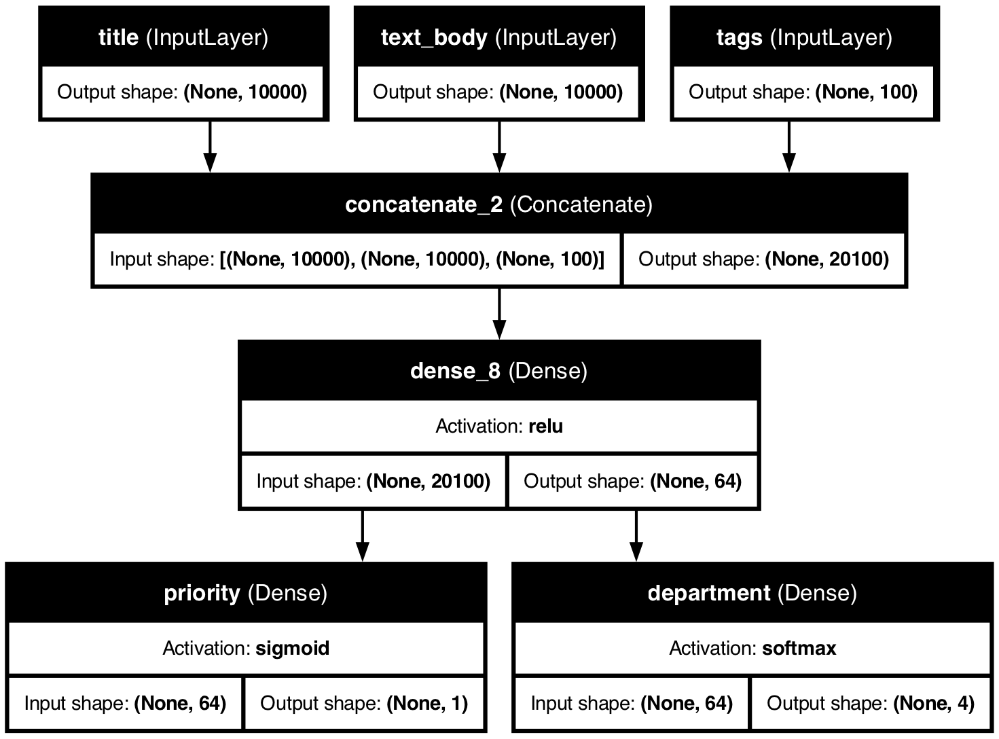

In [31]:
# model visualization
# keras.utils.plot_model(model, "ticket_classifier.png")
keras.utils.plot_model(model, "ch7_ticket_classifier_with_info.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [27]:
# Retrieving the inputs or outputs of a layer in a Functional model
print(f"all layers: {model.layers}\n")
print(f"layers[3] input: {model.layers[3].input}\n")
print(f"layers[3] output: {model.layers[3].output}")

all layers: [<InputLayer name=title, built=True>, <InputLayer name=text_body, built=True>, <InputLayer name=tags, built=True>, <Concatenate name=concatenate_1, built=True>, <Dense name=dense_7, built=True>, <Dense name=priority, built=True>, <Dense name=department, built=True>]

layers[3] input: [<KerasTensor shape=(None, 10000), dtype=float32, sparse=None, name=title>, <KerasTensor shape=(None, 10000), dtype=float32, sparse=None, name=text_body>, <KerasTensor shape=(None, 100), dtype=float32, sparse=None, name=tags>]

layers[3] output: <KerasTensor shape=(None, 20100), dtype=float32, sparse=False, name=keras_tensor_12>


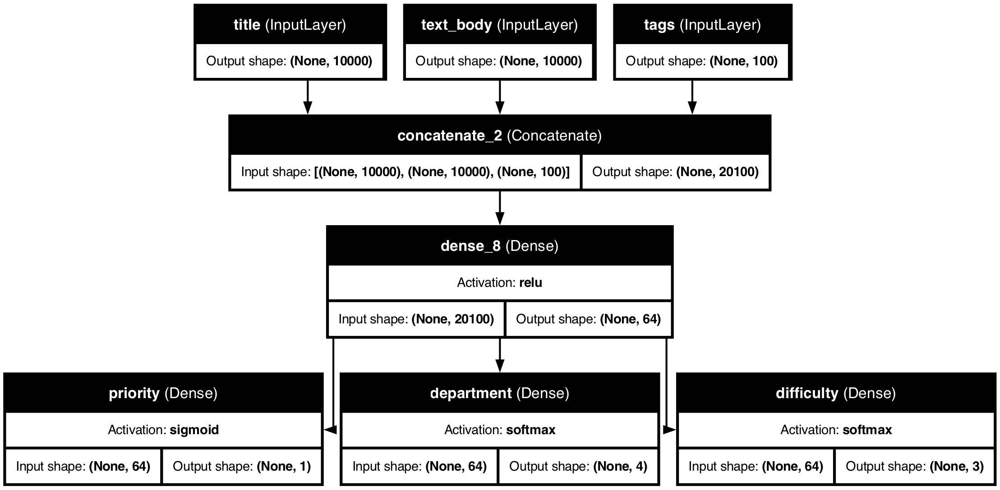

In [32]:
# Creating a new model by reusing intermediate layer outputs
# - the new model estimates the ticket difficulty over three categories: "quick", "medium", and "diffucult"
features = model.layers[4].output   # the intermediate Dense layer after concatenation layer
difficulty = layers.Dense(3, activation="softmax", name="difficulty")(features)

new_model = keras.Model(inputs=[title, text_body, tags],
                       outputs=[priority, department, difficulty])

keras.utils.plot_model(new_model, "ch7_updated_ticket_classifier_with_info.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

### 7.2.3 Subclassing the Model class

Model: "customer_ticket_model_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ concatenate_13 (Concatenate)    │ ?                      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ ?                      │     1,286,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ ?                      │            65 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ ?                      │           260 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,286,789 (4.91 MB)

 Trainable params: 1,286,789 (4.91 MB)

 Non-trainable params: 0 (0.00 B)

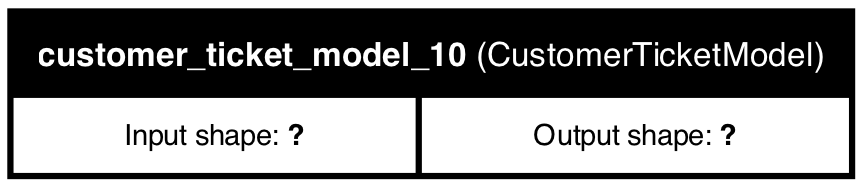

In [48]:
# A simple subclassed model for previous ticket classification task
class CustomerTicketModel(keras.Model):
    def __init__(self, num_departments):
        super().__init__()
        # define sublayers in the constructor
        self.concat_layer = layers.Concatenate()
        self.mixing_layer = layers.Dense(64, activation="relu")
        self.priority_score = layers.Dense(1, activation="sigmoid")
        self.department_classifier = layers.Dense(num_deparments, activation="softmax")

    def call(self, inputs):
        """
        define foward pass in call() method
        """
        # inputs is a dict of name: tensor_data
        title = inputs["title"]
        text_body = inputs["text_body"]
        tags = inputs["tags"]

        features = self.concat_layer([title, text_body, tags])
        features = self.mixing_layer(features)
        priority = self.priority_score(features)
        department = self.department_classifier(features)
        return priority, department

model = CustomerTicketModel(num_departments=4)

# the model only creates weights the first time you call it on some data, similar as the Layer subclass
# below line will create weights, and run forward pass with initial weights and input data
priority, department = model(
    {"title": title_data, "text_body": text_body_data, "tags": tags_data}
)

# for subclassed model will not show layer connectivity under model.summary()
# we also do not have access to the nodes of layers to do feature extraction because there is no graph
model.summary()

# we also cannot use plot_model() for subclassed model
keras.utils.plot_model(model, "ch7_modelsubclass_ticket_classifier_with_info.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [44]:
# Custome model has the same comiple and train steps as Sequential or Functional model
model.compile(optimizer="rmsprop",
             loss=["mean_squared_error", "categorical_crossentropy"],
             metrics=[["mean_absolute_error"], ["accuracy"]])
# the input date structure has to match the call() method inputs structure, here it is a dict
model.fit({"title": title_data,
          "text_body": text_body_data,
          "tags": tags_data},
          [priority_data, department_data],  # this must match the returns in call() method
          epochs=2)
model.evaluate({"title": title_data,
          "text_body": text_body_data,
          "tags": tags_data},
          [priority_data, department_data])
priority_preds, department_preds = model.predict({"title": title_data,
          "text_body": text_body_data,
          "tags": tags_data})

Epoch 1/2
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.2415 - loss: 34.7215 - mean_absolute_error: 0.4763
Epoch 2/2
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.2363 - loss: 29.0338 - mean_absolute_error: 0.4936
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.2792 - loss: 30.5096 - mean_absolute_error: 0.5083
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


### 7.2.4 Mixing and matching different components

In [49]:
## Use a subclassed model inside a Functional model

# Define a subclassed model
class Classifier(keras.Model):

    def __init__(self, num_classes=2):
        super().__init__()
        if num_classes == 2:
            num_units = 1
            activation="sigomid"
        else:
            num_units = num_classes
            activation = "softmax"

        self.dense = layers.Dense(num_classes, activation=activation)


    def call(self, inputs):
        return self.dense(inputs)
        
# A functional model which uses previous subclassed model
inputs = keras.Input(shape=(3,))
features = layers.Dense(64, activation="relu")(inputs)
outputs = Classifier(num_classes=10)(features)   # use subclassed model as a layer
model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

Model: "functional_17"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 3)              │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 64)             │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ classifier (Classifier)         │ (None, 10)             │           650 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 906 (3.54 KB)

 Trainable params: 906 (3.54 KB)

 Non-trainable params: 0 (0.00 B)

In [50]:
## Use a Functional model inside a subclassed model

# define a Functional model
inputs = keras.Input(shape=(64,))
outputs = layers.Dense(1, activation="sigmoid")(inputs)
binary_classifier = keras.Model(inputs=inputs, outputs=outputs)

# define a subcalssed mode and use the functional model inside
class MyModel(keras.Model):
    def __init__(self, num_classes=2):
        super().__init__()
        self.dense = layers.Dense(64, activation='relu')
        self.classifier = binary_classifier    # the functional model as a layer

    def call(self, inputs):
        featuers = self.dense(inputs)
        return self.classifier(fetatures)

model = MyModel()

model.summary()

Model: "my_model"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_45 (Dense)                │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ functional_19 (Functional)      │ ?                      │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 65 (260.00 B)

 Trainable params: 65 (260.00 B)

 Non-trainable params: 0 (0.00 B)

## 7.3 Using built-in training and evaluation loops

In [10]:
# The standard workflow: compile(), fit(), evaluate(), predict()
from tensorflow.keras.datasets import mnist
from tensorflow.keras import layers

def get_mnist_model():
    """create a Functional model for MNIST"""
    inputs = keras.Input(shape=(28 * 28,))
    features = layers.Dense(512, activation="relu")(inputs)
    features = layers.Dropout(0.5)(features)
    outputs = layers.Dense(10, activation="softmax")(features)
    return keras.Model(inputs=inputs, outputs=outputs)

# load data, split it into train, val, and test
(images, labels), (test_images, test_labels) = mnist.load_data()
images = images.reshape((60000, 28 * 28)).astype("float32") / 255
test_images = test_images.reshape((10000, 28 * 28)).astype("float32") / 255
train_images, val_images = images[10000:], images[:10000]
train_labels, val_labels = labels[10000:], labels[:10000]

model = get_mnist_model()
model.compile(optimizer="rmsprop",
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy"])
model.fit(train_images, train_labels,
         epochs=3,
         validation_data=(val_images, val_labels))
# use evaluate() to compute the loss and metrics on new data
test_metrics = model.evaluate(test_images, test_labels)
predictions = model.predict(test_images)

Epoch 1/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.8659 - loss: 0.4466 - val_accuracy: 0.9557 - val_loss: 0.1515
Epoch 2/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9514 - loss: 0.1625 - val_accuracy: 0.9699 - val_loss: 0.1075
Epoch 3/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9630 - loss: 0.1279 - val_accuracy: 0.9728 - val_loss: 0.1001
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9700 - loss: 0.1062
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 759us/step


### 7.3.1 Writing your own metrics by subclassing Metric class

In [61]:
# Implementing a custom metric by subclassing the Metric class
import tensorflow as tf

class RootMeanSquaredError(keras.metrics.Metric):
    def __init__(self, name="rmse", **kwargs):
        """Define the state variables"""
        super().__init__(name=name, **kwargs)
        # accumualte the mse of each batch through one epoch
        self.mse_sum = self.add_weight(name="mse_sum", initializer="zeros")
        # the num of samples, this will accumulate for each batch through one epoch
        self.total_samples = self.add_weight(
            name="total_samples", initializer="zeros", dtype="int32")  

    def update_state(self, y_true, y_pred, sample_weight=None):
        # to match MNIST model, we expect categorical predictions and integer labels
        y_true = tf.one_hot(y_true, depth=tf.shape(y_pred)[1])
        mse = tf.reduce_sum(tf.square(y_true - y_pred))
        self.mse_sum.assign_add(mse)
        num_samples = tf.shape(y_pred)[0]
        self.total_samples.assign_add(num_samples)

    def result(self):
        """return the current value of the metric, at the end of one epoch"""
        return tf.sqrt(self.mse_sum / tf.cast(self.total_samples, tf.float32))

    def reset_state(self):
        """reset the metric state so they can be used across different epochs or across training and evaluation"""
        self.mse_sum.assign(0.)
        self.total_samples.assign(0)

# Custom metrics can be used just like built-in ones
model = get_mnist_model()
model.compile(optimizer="rmsprop",
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy", RootMeanSquaredError()])

history = model.fit(train_images, train_labels,
         epochs=3,
         validation_data=(val_images, val_labels))
print(history.history)

test_metrics = model.evaluate(test_images, test_labels)  # loss, metrics (accuracy, rmse)
test_metrics

Epoch 1/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.8657 - loss: 0.4450 - rmse: 0.4371 - val_accuracy: 0.9592 - val_loss: 0.1421 - val_rmse: 0.2490
Epoch 2/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.9520 - loss: 0.1638 - rmse: 0.2694 - val_accuracy: 0.9681 - val_loss: 0.1135 - val_rmse: 0.2216
Epoch 3/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.9646 - loss: 0.1270 - rmse: 0.2350 - val_accuracy: 0.9724 - val_loss: 0.1001 - val_rmse: 0.2050
{'accuracy': [0.912559986114502, 0.953980028629303, 0.9645400047302246], 'loss': [0.293328195810318, 0.15901097655296326, 0.13002119958400726], 'rmse': [0.3630707561969757, 0.2647293210029602, 0.23616914451122284], 'val_accuracy': [0.9592000246047974, 0.9681000113487244, 0.9724000096321106], 'val_loss': [0.1421075463294983, 0.11348699778318405, 0.10005610436201096], 'val_rmse': [0.24900475144386292, 0.22162707149982452, 0.2049979418516159]}
313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9685 - loss

[0.09410186111927032, 0.9732999801635742, 0.20143631100654602]

### 7.3.2 Using callbacks to take actions during training

In [13]:
# Using EarlyStopping and ModelCheckpoint callbacks in the fit() method
callbacks_list = [
    keras.callbacks.EarlyStopping(  # interrupts training when improvements stops
        monitor="val_accuracy",     # use validation accuracy as monitor variable
        patience=2,  # interrupts training when accuracy has stopped improving for 2 epochs
    ),
    keras.callbacks.ModelCheckpoint( # save the weights after every epoch
        filepath="ch7_model_test_checkpoint_model_file.keras",
        # why use val_loss here instead of val_accuracy
        # - Small improvements in loss can indicate better generalization even when accuracy doesn't change significantly.
        # - By saving models based on val_loss, you ensure that the checkpoint corresponds to the model that generalizes best to the validation data, 
        # - even if accuracy isn't the highest.
        # - Accuracy is a discrete metric and can be less sensitive to small improvements or degradations compared to loss. 
        # - if we use val_accurcy here, this might lead to less frequent model saving or premature stopping if accuracy plateaus while loss continues to improve slightly.
        monitor="val_loss",    # monitor variable
        save_best_only=True,  # overwrite the model file only when val_loss has improved
    )
]

model = get_mnist_model()
model.compile(optimizer="rmsprop",
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy"])
model.fit(train_images, train_labels,
         epochs=5,
         callbacks=callbacks_list,
         validation_data=(val_images, val_labels))

# save model manually
model.save("test_manual_model_file.keras")

# load previously saved model
model = keras.models.load_model("test_checkpoint_model_file.keras")
predictions = model.predict(test_images)

Epoch 1/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - accuracy: 0.8678 - loss: 0.4442 - val_accuracy: 0.9592 - val_loss: 0.1418
Epoch 2/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9527 - loss: 0.1605 - val_accuracy: 0.9673 - val_loss: 0.1177
Epoch 3/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9639 - loss: 0.1273 - val_accuracy: 0.9712 - val_loss: 0.1128
Epoch 4/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9690 - loss: 0.1078 - val_accuracy: 0.9750 - val_loss: 0.0969
Epoch 5/5
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9713 - loss: 0.1002 - val_accuracy: 0.9767 - val_loss: 0.0956
313/313 ━━━━━━━━━━━━━━━━━━━━ 0s 780us/step


Epoch 1/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.8681 - loss: 0.4406 - val_accuracy: 0.9570 - val_loss: 0.1468
Epoch 2/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9511 - loss: 0.1691 - val_accuracy: 0.9658 - val_loss: 0.1168
Epoch 3/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9629 - loss: 0.1285 - val_accuracy: 0.9694 - val_loss: 0.1069
Epoch 4/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9666 - loss: 0.1151 - val_accuracy: 0.9738 - val_loss: 0.1001
Epoch 5/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9713 - loss: 0.1051 - val_accuracy: 0.9767 - val_loss: 0.0915
Epoch 6/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9745 - loss: 0.0940 - val_accuracy: 0.9752 - val_loss: 0.1008
Epoch 7/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9767 - loss: 0.0855 - val_accuracy: 0.9771 - val_loss: 0.0918
Epoch 8/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9781 - loss: 0.0787 - 

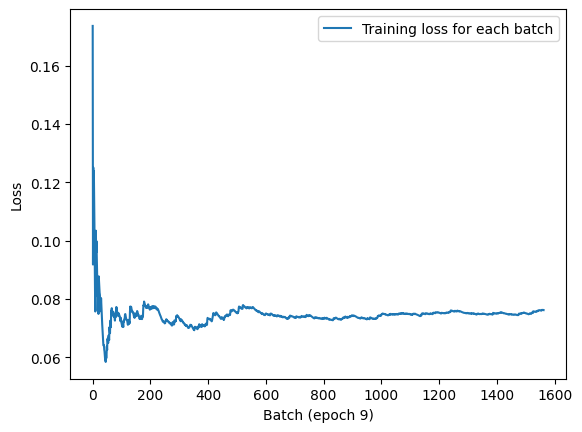

In [16]:
# Creating a custom callback by subclassing Callback class
from matplotlib import pyplot as plt

class LossHistory(keras.callbacks.Callback):
    # the logs argument is a dict containing information about the previous batch, epoch, or training run, etc.
    def on_train_begin(self, logs):
        self.per_batch_losses = []

    def on_batch_end(self, batch, logs):
        # batch is the index of the batch
        self.per_batch_losses.append(logs.get("loss"))

    def on_epoch_end(self, epoch, logs):
        """plot the loss vs batch at the end of one epoch"""
        # epoch is the index of the epoch
        plt.clf()
        plt.plot(range(len(self.per_batch_losses)), self.per_batch_losses,
                label="Training loss for each batch")
        plt.xlabel(f"Batch (epoch {epoch})")
        plt.ylabel("Loss")
        plt.legend()
        plt.savefig(f"plot_at_epoch_{epoch}")
        self.per_batch_losses = []

model = get_mnist_model()
model.compile(optimizer="rmsprop",
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy"])
model.fit(train_images, train_labels,
         epochs=10,
         callbacks=[LossHistory()],  # the custom callback is used here
         validation_data=(val_images, val_labels))

### 7.3.3 Using your own callbacks by subclassing keras.callbacks.Callback

### 7.3.4 Monitoring and visualizing with TensorBoard

In [87]:
# Create log directory
log_dir="./tensorflowlog/ch7"
!mkdir -p {log_dir}   # create the log dir if it doesn't exist

# Clear any logs from previous runs
!rm -rf ./tensorflowlog/ch7

# load TensorBoard to monitor training progress
%load_ext tensorboard

# Cannot use variable log_dir, have to use the exact name ./tensorflowlog/ch7
%tensorboard --logdir ./tensorflowlog/ch7 --bind_all  

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 93779), started 1 day, 2:49:24 ago. (Use '!kill 93779' to kill it.)

In [21]:
# Train a model using tensorboard callback
model = get_mnist_model()
model.compile(optimizer="rmsprop",
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy"])

tensorboard = keras.callbacks.TensorBoard(
    log_dir=log_dir,
)

model.fit(train_images, train_labels,
         epochs=10,
         validation_data=(val_images, val_labels),
         callbacks=[tensorboard])

Epoch 1/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.8654 - loss: 0.4457 - val_accuracy: 0.9546 - val_loss: 0.1471
Epoch 2/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - accuracy: 0.9498 - loss: 0.1693 - val_accuracy: 0.9673 - val_loss: 0.1183
Epoch 3/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.9615 - loss: 0.1311 - val_accuracy: 0.9707 - val_loss: 0.1024
Epoch 4/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.9691 - loss: 0.1085 - val_accuracy: 0.9740 - val_loss: 0.1003
Epoch 5/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.9719 - loss: 0.0993 - val_accuracy: 0.9750 - val_loss: 0.0942
Epoch 6/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 5ms/step - accuracy: 0.9749 - loss: 0.0913 - val_accuracy: 0.9759 - val_loss: 0.1044
Epoch 7/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.9750 - loss: 0.0906 - val_accuracy: 0.9773 - val_loss: 0.0963
Epoch 8/10
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.9788 - loss: 0.0718 - 

## 7.4 Writing your own training and evaluation loops, custom fit()

### 7.4.1 Training versus inference

In [ ]:
# typical supervised-learning trining step
def train_step(inputs, targets):
    with tf.GradientTape() as tape:
        # Some layers have different behavior for training vs inference, such as Dropout
        # by extension, Functional and Sequential model also expose training variable
        predictions = model(inputs, training=True)
        loss = loss_fn(targets, predictions)
        # only trainable_weights will be updated via backpropagation
        # non-trainable weights, such as counter of batches, will be updated during forward pass
        gradients = tape.gradients(loss, model.trainable_weights)
        optimizer.apply_gradients(zip(model.trainable_weights, gradients))

### 7.4.2 Low-level usage of metrics

In [25]:
# for each batch, call update_state() and result() 
metric = keras.metrics.SparseCategoricalAccuracy()
targets = tf.convert_to_tensor([0, 1, 2])
predictions = [[1, 0, 0], [0, 1, 0], [0, 0, 1]]
metric.update_state(targets, predictions)  # update metric variable
current_result = metric.result()           # return metric result
print(f"result: {current_result:.2f}")

result: 1.00


In [26]:
# track teh average of a scalar value, such as teh model's loss
values = [0, 1, 2, 3, 4]
mean_tracker = keras.metrics.Mean()
for value in values:
    mean_tracker.update_state(value)
print(f"Mean of values: {mean_tracker.result()}")

Mean of values: 2.0


### 7.4.3 A complete training and evaluation loop

In [28]:
## Writeing a step-by-step training loop
model = get_mnist_model()

# the training step function
loss_fn = keras.losses.SparseCategoricalCrossentropy()
optimizer = keras.optimizers.RMSprop()
metrics = [keras.metrics.SparseCategoricalAccuracy()]
loss_tracking_metric = keras.metrics.Mean()  # track loss average

def train_step(inputs, targets):
    """
    fit()-like training step function,
    which takes a batch of data and targets and return the logs that would get displayed by the fit() progress bar
    """
    # run the forward pass
    with tf.GradientTape() as tape:
        predictions = model(inputs, training=True)
        loss = loss_fn(targets, predictions)
    # run the backward pass
    gradients = tape.gradient(loss, model.trainable_weights)
    optimizer.apply_gradients(zip(gradients, model.trainable_weights))

    # keep track of all metrics
    logs = {}
    for metric in metrics:
        metric.update_state(targets, predictions)
        logs[metric.name] = metric.result()

    # keep track of loss average
    loss_tracking_metric.update_state(loss)
    logs["loss"] = loss_tracking_metric.result()
    return logs

# resetting the metrics function
def reset_metrics():
    for metric in metrics:
        metric.reset_state()
    loss_tracking_metric.reset_state()

# the actual training loop
training_dataset = tf.data.Dataset.from_tensor_slices((train_images, train_labels)) # turn into Dataset then iterator of batches
training_dataset = training_dataset.batch(32)
epochs = 3

for epoch in range(epochs):
    reset_metrics()  # we need to reset the metrics for each epoch
    for inputs_batch, targets_batch in training_dataset:
        logs = train_step(inputs_batch, targets_batch)  # use the above defined function to do the training
    print(f"Results at the end of epoch {epoch}")
    for key, value in logs.items():
        print(f"...{key}: {value:.4f}")

2024-06-01 20:33:50.558553: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Results at the end of epoch 0
...sparse_categorical_accuracy: 0.9136
...loss: 0.2904


2024-06-01 20:34:09.054293: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Results at the end of epoch 1
...sparse_categorical_accuracy: 0.9538
...loss: 0.1610
Results at the end of epoch 2
...sparse_categorical_accuracy: 0.9633
...loss: 0.1296


2024-06-01 20:34:27.591300: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [32]:
# the evaluation loop
def test_step(inputs, targets):
    """
    evaluate()-like custom function, it is similar as previous train_step(),
    here we do not need to track gradients and run backward pass.
    """
    predictions = model(inputs, training=False)
    loss = loss_fn(targets, predictions)

    logs = {}
    for metric in metrics:
        metric.update_state(targets, predictions)
        logs["val_" + metric.name] = metric.result()
        loss_tracking_metric.update_state(loss)
        logs["val_loss"] = loss_tracking_metric.result()
    return logs

val_dataset = tf.data.Dataset.from_tensor_slices((val_images, val_labels))
val_dataset = val_dataset.batch(32)

reset_metrics()
for inputs_batch, targets_batch in val_dataset:
    logs = test_step(inputs_batch, targets_batch)
print("Evaluation results:")
for key, value in logs.items():
    print(f"...{key}: {value:.4f}")

Evaluation results:
...val_sparse_categorical_accuracy: 0.9694
...val_loss: 0.1172


2024-06-01 20:38:58.516183: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


### 7.4.5 Leveraging fit() with a custom Model using a new training loop

In [60]:
# Implementing a custom training step to use with fit()
loss_tracker = keras.metrics.Mean(name="loss_tracker")

class CustomModel(keras.Model):
    # override the train_step method
    # no need to add @tf.function decorator, the framework does it implicitly
    def train_step(self, data):
        inputs, targets = data
        with tf.GradientTape() as tape:
            # we use self() instead of model() because the model is the calss itself
            predictions = self(inputs, training=True)
            loss = self.compiled_loss(targets, predictions) # the loss function passed to compile()
        gradients = tape.gradient(loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.trainable_weights))

        # a wrapper for the list of metrics passed to compile(), this wrapper can update_state for all metrics
        self.compiled_metrics.update_state(targets, predictions)
        loss_tracker.update_state(loss)
        # return a dict mapping metric names to their current value
        # the self.metrics is the actual list of metrics passed to compile() + any other custom metrics
        return {m.name : m.result() for m in self.metrics}

    # this enables the model to automatically call reset_state() on the model's metrics
    # at the start of each epoch and at the start of a call to evaluate()
    @property
    def metrics(self):
        return super().metrics + [loss_tracker]

# instantiate the custom model, compile it and train it using fit()
inputs = keras.Input(shape=(28 * 28,))
features = layers.Dense(512, activation="relu")(inputs)
features = layers.Dropout(0.5)(features)
outputs = layers.Dense(10, activation="softmax")(features)
model = CustomModel(inputs, outputs)  # use the custom model with overridden train_step()

model.compile(optimizer=keras.optimizers.RMSprop(),
             loss=keras.losses.SparseCategoricalCrossentropy(),
             metrics=[keras.metrics.SparseCategoricalAccuracy()])
model.fit(train_images, train_labels, epochs=3)

Epoch 1/3


/Volumes/App/micromamba/envs/jupyter_py31014_tf2161_GPU/lib/python3.10/site-packages/keras/src/backend/tensorflow/trainer.py:603: UserWarning: `model.compiled_loss()` is deprecated. Instead, use `model.compute_loss(x, y, y_pred, sample_weight)`.
  warnings.warn(
/Volumes/App/micromamba/envs/jupyter_py31014_tf2161_GPU/lib/python3.10/site-packages/keras/src/backend/tensorflow/trainer.py:578: UserWarning: `model.compiled_metrics()` is deprecated. Instead, use e.g.:
```
for metric in self.metrics:
    metric.update_state(y, y_pred)
```

  return self._compiled_metrics_update_state(


1563/1563 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - sparse_categorical_accuracy: 0.8655 - loss: 0.1000 - loss_tracker: 0.1105
Epoch 2/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - sparse_categorical_accuracy: 0.9527 - loss: 0.1000 - loss_tracker: 0.1018
Epoch 3/3
1563/1563 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - sparse_categorical_accuracy: 0.9623 - loss: 0.1000 - loss_tracker: 0.1009


# CH8 Introduction to deep learning for computer vision

## 8.1 Introduction to convnets: convnet for MNIST

Model: "functional_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_43 (InputLayer)     │ (None, 28, 28, 1)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 26, 26, 32)     │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 13, 13, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 11, 11, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_7 (MaxPooling2D)  │ (None, 5, 5, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_11 (Conv2D)              │ (None, 3, 3, 128)      │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_3 (Flatten)             │ (None, 1152)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_81 (Dense)                │ (None, 10)             │        11,530 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 104,202 (407.04 KB)

 Trainable params: 104,202 (407.04 KB)

 Non-trainable params: 0 (0.00 B)

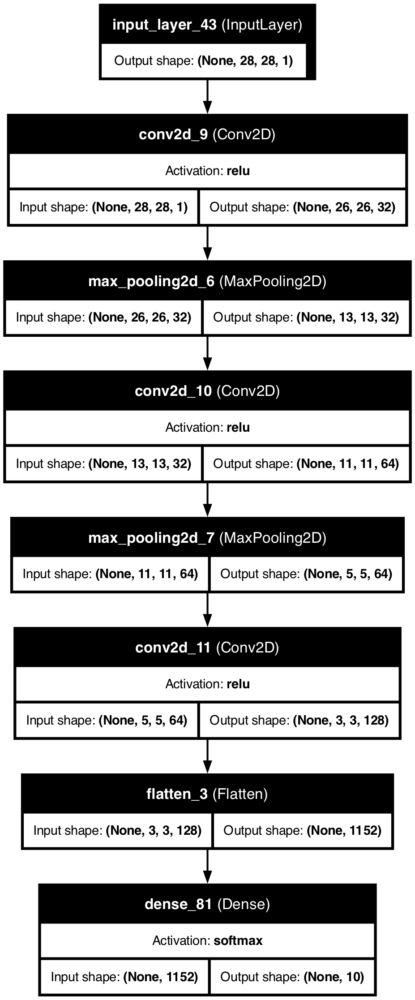

In [64]:
# Convnet for MNIST dataset
# ch2.1 and ch7.3 used Dense nn for MNIST, which acieved 97% accuracy
from tensorflow import keras
from tensorflow.keras import layers

inputs = keras.Input(shape=(28, 28, 1))
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu")(inputs)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation="relu")(x)
x = layers.Flatten()(x)
outputs = layers.Dense(10, activation="softmax")(x)
model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

keras.utils.plot_model(model, "ch8convnet_mnist.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [69]:
# train the convnet for MNIST
from tensorflow.keras.datasets import mnist

(train_images, train_labels), (test_images, test_labels) = mnist.load_data()
# original shape is (60000, 28, 28), in dense network we reshape to (60000, 28 * 28)
train_images = train_images.reshape((60000, 28, 28, 1))   
train_images = train_images.astype("float32") / 255
test_images = test_images.reshape((10000, 28, 28, 1))
test_images = test_images.astype("float32") / 255

model.compile(optimizer="rmsprop",
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy"])
history = model.fit(train_images, train_labels, epochs=5, batch_size=64)

# plot loss and accuracy 
plot_training_history(history, "loss")
plot_training_history(history, "accuracy")

Epoch 1/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 7s 7ms/step - accuracy: 0.9961 - loss: 0.0132
Epoch 2/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - accuracy: 0.9968 - loss: 0.0113
Epoch 3/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - accuracy: 0.9977 - loss: 0.0075
Epoch 4/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - accuracy: 0.9983 - loss: 0.0073
Epoch 5/5
938/938 ━━━━━━━━━━━━━━━━━━━━ 6s 7ms/step - accuracy: 0.9981 - loss: 0.0059


In [67]:
# evaluating the convert
test_loss, test_acc = model.evaluate(test_images, test_labels)
print(f"Test accuracy: {test_acc:.3f}.")

313/313 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9891 - loss: 0.0329
Test accuracy: 0.992.


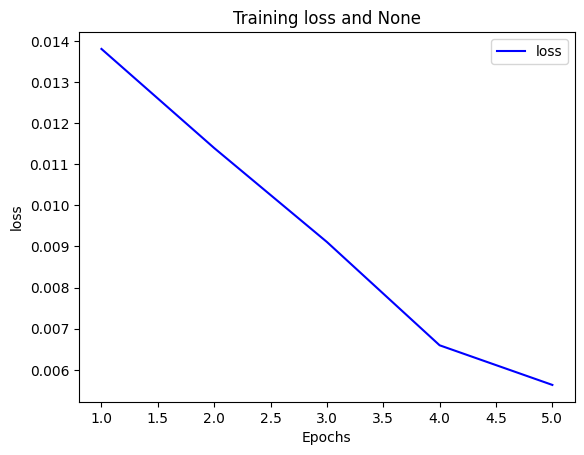

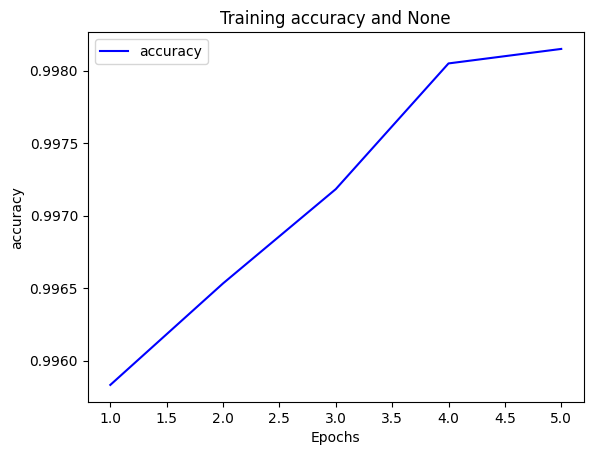

In [77]:
# plot loss and accuracy 
plot_training_history(history, "loss")
plot_training_history(history, "accuracy")

## 8.2 Training a convnet form scratch on a small dataset (dogs vs cats classification)

### 8.2.2 Create a small subset dataset and data preprocessing

In [79]:
# Create the data directories
import os, shutil, pathlib

original_dir = pathlib.Path("../datasets/dogs_vs_cats/train")
new_base_dir = pathlib.Path("../datasets/dogs_vs_cats_small")

# Check if the directory exists, if not create it
if not os.path.exists(new_base_dir):
    os.makedirs(new_base_dir)
    print("Directory created:", new_base_dir)
else:
    print("Directory already exists.")

Directory created: ../datasets/dogs_vs_cats_small


In [80]:
# A function to make subset data
def make_subset(subset_name, start_index, end_index):
  for category in ("cat", "dog"):
    target_dir = new_base_dir / subset_name / category

    if not os.path.exists(target_dir):
      os.makedirs(target_dir)

    # original file name format such as cat.12.jpg
    fnames = [f"{category}.{i}.jpg" for i in range(start_index, end_index)]

    for fname in fnames:
      shutil.copyfile(src=original_dir/fname, dst=target_dir/fname)

# Create small datasets from the original data
make_subset("train", start_index=0, end_index=1000)
make_subset("validation", start_index=1000, end_index=1500)
make_subset("test", start_index=1500, end_index=2500)

In [85]:
# Using image_dataset_from_directory to read images to Dataset object
from tensorflow.keras.utils import image_dataset_from_directory

train_dataset = image_dataset_from_directory(
    new_base_dir / "train",
    image_size=(180, 180),
    batch_size=32
)
validation_dataset = image_dataset_from_directory(
    new_base_dir / "validation",
    image_size=(180, 180),
    batch_size=32
)
test_dataset = image_dataset_from_directory(
    new_base_dir / "test",
    image_size=(180, 180),
    batch_size=32
)

for one_data_batch, one_labels_batch in train_dataset:
    print(f"one_data_batch.shape: {one_data_batch.shape}")
    print(f"one_labels_batch.shape: {one_labels_batch.shape}")
    print(f"one_labels_batch[:2]: {one_labels_batch[:2]}")
    break

Found 2000 files belonging to 2 classes.
Found 1000 files belonging to 2 classes.
Found 2000 files belonging to 2 classes.
one_data_batch.shape: (32, 180, 180, 3)
one_labels_batch.shape: (32,)
one_labels_batch[:2]: [1 0]


### 8.2.3 Build and train the convnet model

Model: "functional_51"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_53 (InputLayer)     │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling_6 (Rescaling)         │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 178, 178, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_32 (MaxPooling2D) │ (None, 89, 89, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 87, 87, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_33 (MaxPooling2D) │ (None, 43, 43, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_44 (Conv2D)              │ (None, 41, 41, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_34 (MaxPooling2D) │ (None, 20, 20, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 18, 18, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_35 (MaxPooling2D) │ (None, 9, 9, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 7, 7, 256)      │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_10 (Flatten)            │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_88 (Dense)                │ (None, 1)              │        12,545 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 991,041 (3.78 MB)

 Trainable params: 991,041 (3.78 MB)

 Non-trainable params: 0 (0.00 B)

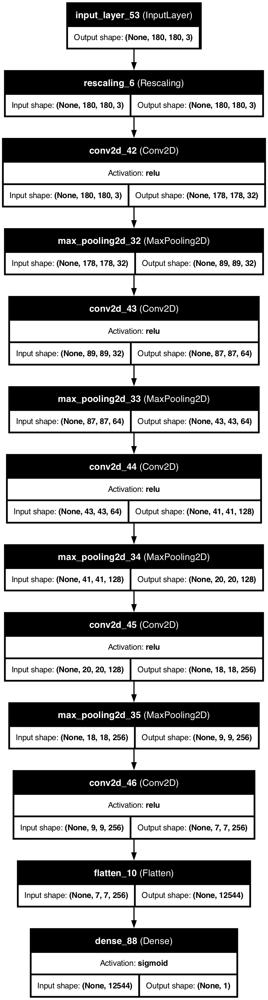

In [143]:
# Build the convnet model
from tensorflow import keras
from tensorflow.keras import layers

inputs = keras.Input(shape=(180, 180, 3))
x = layers.Rescaling(1./255)(inputs)    # from [0, 255] to [0, 1]
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
# If the input shape is (batch_size, height, width, channels), Flatten will convert it to (batch_size, height * width * channels).
x = layers.Flatten()(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

keras.utils.plot_model(model, "ch8_convnet_dog_vs_cat.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [147]:
# setup tensorboard
log_dir = "./tensorflowlog/ch8/convnet_from_scratch"
setup_tensorboard(log_dir)

Reusing TensorBoard on port 6006 (pid 27392), started 0:04:28 ago. (Use '!kill 27392' to kill it.)

In [148]:
# Train the model
model.compile(optimizer="rmsprop",
              loss="binary_crossentropy",
              metrics=["accuracy"])

callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="ch8_model_convnet_from_scratch.keras",
        save_best_only=True,
        monitor="val_loss"
    ),
    keras.callbacks.TensorBoard(log_dir=log_dir)
]

history = model.fit(
    train_dataset,   # tf Dataset object directly, different than pair of train_images, train_labels
    epochs=30,
    validation_data=validation_dataset,  # tf Dataset object
    callbacks=callbacks,
    verbose=0
)

# plot loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

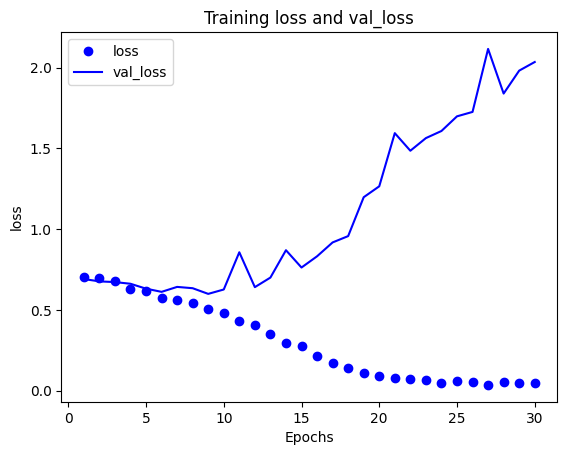

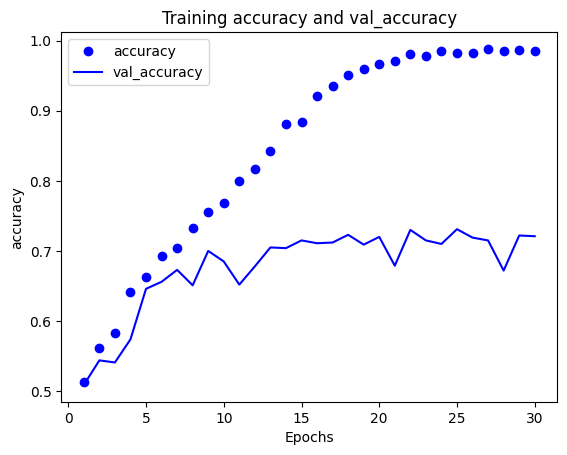

In [149]:
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [150]:
# evaluate the model performance with test data
test_model = keras.models.load_model("ch8_model_convnet_from_scratch.keras")
test_loss, test_acc = test_model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc*100:.1f}%")

63/63 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.7024 - loss: 0.6100
Test accuracy: 71.6%


### 8.2.5 Using data augmentation to mitigate overfitting in computer vision (other than regulariztion and dropouts)

In [127]:
# definie a data augmentation layer, which will be used at the start of the model
data_augmentation = keras.Sequential(
    [
        layers.RandomFlip("horizontal"),  # horizontal flipping to a random 50% images
        layers.RandomRotation(0.1),       # rotate input image by a random value in the range [-10%, +10%], i.e. [-36 degrees, + 36 degrees]
        layers.RandomZoom(0.2),           # zoom in or out by a random factor in the range [-20%, +20%]
    ],
    name="data_augmentation_layer"
)

2024-06-03 10:17:07.999505: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


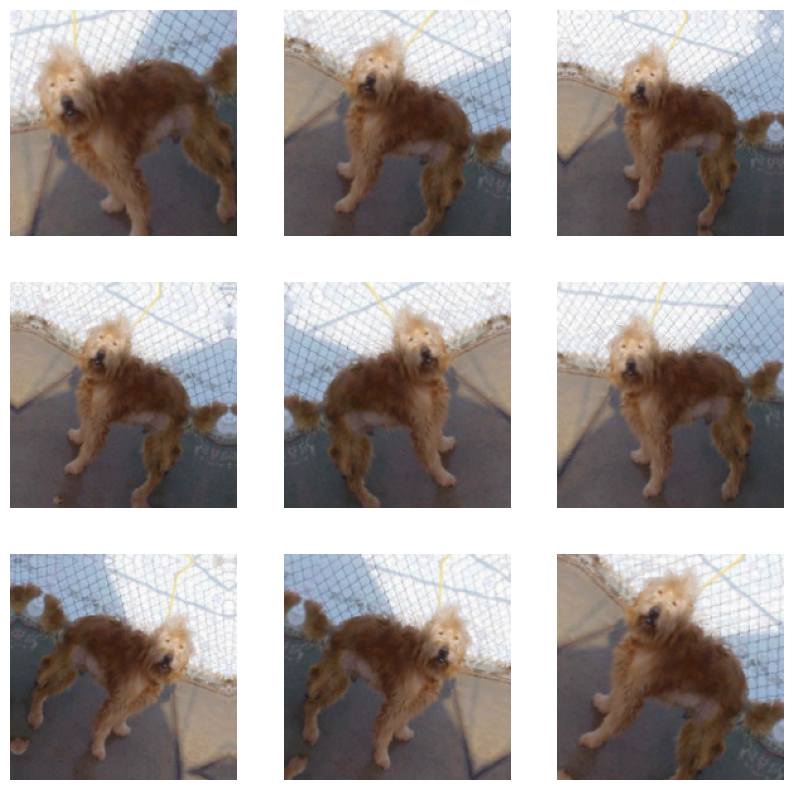

In [128]:
# Display some randomly augmented images for one original image
# - we need to pass a dataset batch to the augmentation layer 
plt.figure(figsize=(10, 10))
for images, _ in train_dataset.take(1):
    # process the same batch 9 times, display the augmented first image every time,
    # they are different augmentations of the same original image
    for i in range(9):
        augmented_images = data_augmentation(images)  # images shape (32, 180, 180, 3)
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(augmented_images[0].numpy().astype("uint8"))
        plt.axis("off")

## The below doesn't work, giving error "Invalid input shape for input"
# plt.figure(figsize=(10, 10))
# for images, _ in train_dataset.take(1):
#     image = images[0]
#     for i in range(9):
#         augmented_image = data_augmentation(image)  
#         ax = plt.subplot(3, 3, i + 1)
#         plt.imshow(augmented_image.numpy().astype("uint8"))
#         plt.axis("off")

## This work by reshaping the input image from (180, 180, 3) to (1, 180, 180, 3)
# plt.figure(figsize=(10, 10))
# for images, _ in train_dataset.take(1):
#     image = tf.reshape(images[0], (1, *images[0].shape))
#     for i in range(9):
#         augmented_images = data_augmentation(image)  
#         ax = plt.subplot(3, 3, i + 1)
#         plt.imshow(augmented_images[0].numpy().astype("uint8"))
#         plt.axis("off")

Model: "functional_41"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_51 (InputLayer)     │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ data_augmentation_layer         │ (None, 180, 180, 3)    │             0 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling_4 (Rescaling)         │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_32 (Conv2D)              │ (None, 178, 178, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 89, 89, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 87, 87, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 43, 43, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 41, 41, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 20, 20, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 18, 18, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 9, 9, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_36 (Conv2D)              │ (None, 7, 7, 256)      │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_41 (Dropout)            │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 1)              │        12,545 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 991,041 (3.78 MB)

 Trainable params: 991,041 (3.78 MB)

 Non-trainable params: 0 (0.00 B)

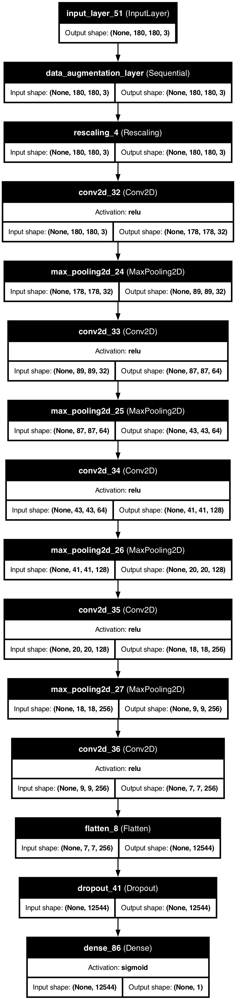

In [129]:
# New convnet with image augmentation and dropout
inputs = keras.Input(shape=(180, 180, 3))
x = data_augmentation(inputs)   # only used for training, not for inference or evaluation
x = layers.Rescaling(1./255)(x)
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.Flatten()(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

keras.utils.plot_model(model, "ch8_convnet_from_scratch_with_augmentation.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [131]:
# Setup tensorboard
log_dir = "./tensorflowlog/ch8/convnet_from_scratch_with_agumentation"
setup_tensorboard(log_dir)

In [132]:
# Train the model
model.compile(loss="binary_crossentropy",
             optimizer="rmsprop",
             metrics=["accuracy"])

callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="ch8_model_convnet_from_scratch_with_augmentation.keras",
        save_best_only=True,
        monitor="val_loss"
    ),
    keras.callbacks.TensorBoard(log_dir=log_dir)
]

history = model.fit(
    train_dataset,
    epochs=100,
    validation_data=validation_dataset,
    callbacks=callbacks,
    verbose=0
)

# plot loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

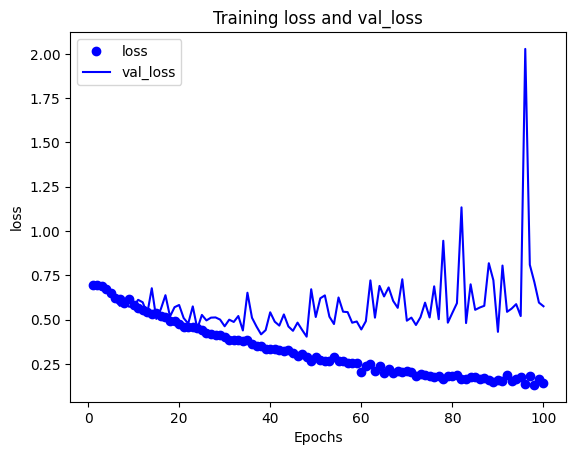

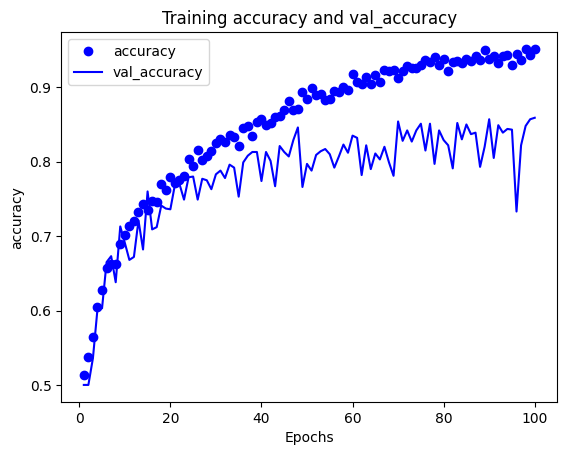

In [137]:
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [139]:
# Evalute the model on the test dataset
test_model = keras.models.load_model("ch8_model_convnet_from_scratch_with_augmentation.keras")
test_loss, test_acc = test_model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc*100:.1f}%")

63/63 ━━━━━━━━━━━━━━━━━━━━ 3s 41ms/step - accuracy: 0.8369 - loss: 0.4647
Test accuracy: 84.1%


## 8.3 Leveraging a pretrained modelabs

### 8.3.1 Feature extraction with a pretrained model

In [152]:
# Instantiating the VGG16 convolutional base
conv_base = keras.applications.vgg16.VGG16(
    weights="imagenet",   # another option is "None" which will use random weights
    include_top=False,    # excluding the classifier layers
    input_shape=(180, 180, 3)
)

conv_base.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_55 (InputLayer)     │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 180, 180, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 180, 180, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 90, 90, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 90, 90, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 90, 90, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 45, 45, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 45, 45, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 45, 45, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 45, 45, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 22, 22, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 22, 22, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 22, 22, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 22, 22, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 11, 11, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 11, 11, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 11, 11, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 11, 11, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 5, 5, 512)      │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

#### 8.3.1-a Record the output of conv_base and use these outputs as inputs to a new classifier model

In [157]:
# Feature extraction using vgg16 pretrained model without data_augmentation
# This method runs faster becasue the images do not need to go through many epochs
import numpy as np
import tensorflow.keras as keras

# output is extracted features in the shape of (samples, 5, 5, 512)
def get_features_and_labels(dataset):
    all_features = []
    all_labels = []

    # dataset is already in batches, so iterate over all batches
    # one batch of images has shape (batch_size, width, height, channel) and labels of shape (batch_size,)
    for images, labels in dataset:
        preprocessed_images = keras.applications.vgg16.preprocess_input(images)  #vgg requires preprocessing images
        features = conv_base.predict(preprocessed_images, verbose=0)
        all_features.append(features)  # shape is (batch_size, 5, 5, 512)
        all_labels.append(labels)

    print(f"Finished extracting one dataset")
    return np.concatenate(all_features), np.concatenate(all_labels)   # shape are (total_samples, 5, 5, 512) and (total_samples,)

train_features, train_labels = get_features_and_labels(train_dataset)
val_features, val_labels = get_features_and_labels(validation_dataset)
test_features, test_labels = get_features_and_labels(test_dataset)

# the extracted features are from all samples, not in batches
print(f"train_features.shape: {train_features.shape}")
print(f"val_features.shape: {val_features.shape}")
print(f"test_features.shape: {test_features.shape}")

2024-06-03 12:03:08.863096: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Finished extracting one dataset


2024-06-03 12:03:17.218079: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Finished extracting one dataset
Finished extracting one dataset
train_features.shape: (2000, 5, 5, 512)
val_features.shape: (1000, 5, 5, 512)
test_features.shape: (2000, 5, 5, 512)


2024-06-03 12:03:33.857752: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [158]:
# define the densely connected classifier
inputs = keras.Input(shape=(5, 5, 512))  # input are the extracted features from conv_base
x = layers.Flatten()(inputs)
x = layers.Dense(256)(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)

model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

Model: "functional_53"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_56 (InputLayer)     │ (None, 5, 5, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_11 (Flatten)            │ (None, 12800)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_89 (Dense)                │ (None, 256)            │     3,277,056 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_42 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_90 (Dense)                │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,277,313 (12.50 MB)

 Trainable params: 3,277,313 (12.50 MB)

 Non-trainable params: 0 (0.00 B)

In [159]:
# Train the densely connected classifier
model.compile(loss="binary_crossentropy",
             optimizer="rmsprop",
             metrics=["accuracy"])

callbacks=[
    keras.callbacks.ModelCheckpoint(
        filepath="ch8_model_feature_extraction.keras",
        save_best_only=True,
        monitor="val_loss"
    )
]

history = model.fit(
    train_features, train_labels,
    epochs = 20,
    validation_data=(val_features, val_labels),
    callbacks=callbacks,
    verbose=0
)

# plot loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

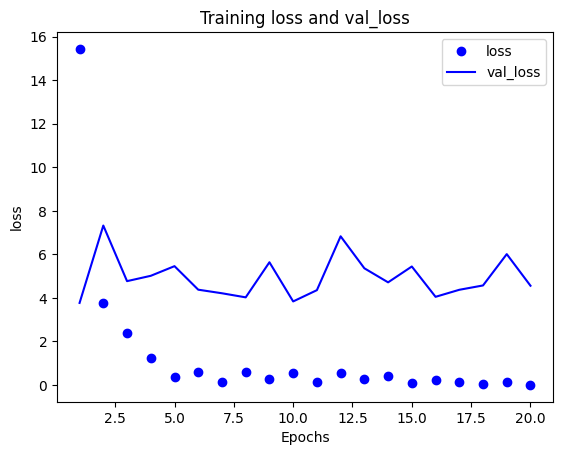

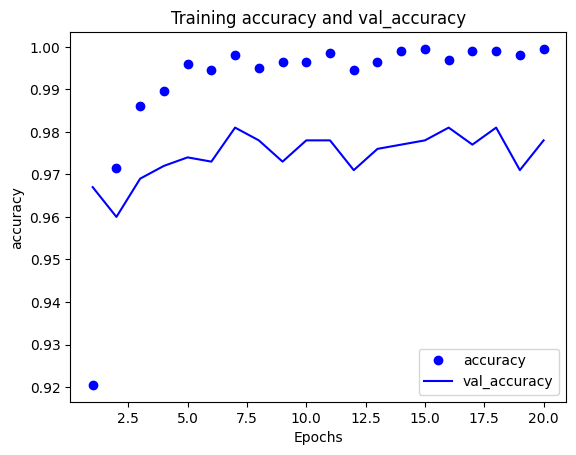

In [160]:
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [199]:
# Evalute the model on the test dataset
test_model = keras.models.load_model("ch8_model_feature_extraction.keras")
test_loss, test_acc = test_model.evaluate(test_features, test_labels)
print(f"Test accuracy: {test_acc*100:.1f}%")

63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.9699 - loss: 3.9513
Test accuracy: 96.9%


#### 8.3.1-b Feature extraction inside the model, with data augmentation

In [176]:
## Create a model that chains conv_base with a new classifier, then train it end to end on the inputs

# vgg_base layer with trainable set to False
conv_base = keras.applications.vgg16.VGG16(
    weights="imagenet",
    include_top=False
)

conv_base.trainable = True   #  default is also True
print(f"Before freezing the conv_base, the number of trainable weights (layers): {len(conv_base.trainable_weights)} "
      f"and total number of trainable parameters: {sum([tf.size(w).numpy() for w in conv_base.trainable_weights])}")

conv_base.trainable = False   # we will not train the base parameters
# conv_base.trainable_weights return a list of tensor weight objects
print(f"After freezing the conv_base, the number of trainable weights (layers): {len(conv_base.trainable_weights)} "
      f"and total number of trainable parameters: {sum([tf.size(w).numpy() for w in conv_base.trainable_weights])}")

Before freezing the conv_base, the number of trainable weights (layers): 26 and total number of trainable parameters: 14714688
After freezing the conv_base, the number of trainable weights (layers): 0 and total number of trainable parameters: 0


In [185]:
# create a data augmentation layer
data_augmentation = keras.Sequential(
    [
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(0.1),
        layers.RandomZoom(0.2),
    ], 
    name="data_augmentation_layer"
)

# setup the model chaining data_augmentation, frozen conv_base and a dense classifier layer
inputs = keras.Input(shape=(180, 180, 3))
x = data_augmentation(inputs)
x = keras.applications.vgg16.preprocess_input(x)
x = conv_base(x)
x = layers.Flatten()(x)
x = layers.Dense(256)(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

Model: "functional_65"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_75      │ (None, 180, 180,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ data_augmentation_… │ (None, 180, 180,  │          0 │ input_layer_75[0… │
│ (Sequential)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_9          │ (None, 180, 180)  │          0 │ data_augmentatio… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_10         │ (None, 180, 180)  │          0 │ data_augmentatio… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_11         │ (None, 180, 180)  │          0 │ data_augmentatio… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stack_3 (Stack)     │ (None, 180, 180,  │          0 │ get_item_9[0][0], │
│                     │ 3)                │            │ get_item_10[0][0… │
│                     │                   │            │ get_item_11[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_3 (Add)         │ (None, 180, 180,  │          0 │ stack_3[0][0]     │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ vgg16 (Functional)  │ (None, 5, 5, 512) │ 14,714,688 │ add_3[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_15          │ (None, 12800)     │          0 │ vgg16[3][0]       │
│ (Flatten)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_97 (Dense)    │ (None, 256)       │  3,277,056 │ flatten_15[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_46          │ (None, 256)       │          0 │ dense_97[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_98 (Dense)    │ (None, 1)         │        257 │ dropout_46[0][0]  │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 17,992,001 (68.63 MB)

 Trainable params: 3,277,313 (12.50 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [186]:
# Setup tensorboard
log_dir = "./tensorflowlog/ch8/feature_extraction_with_data_augmentation"
setup_tensorboard(log_dir)

In [187]:
# train the model
model.compile(loss="binary_crossentropy",
             optimizer="rmsprop",
             metrics=["accuracy"])

callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="ch8_model_feature_extraction_with_data_augmentation.keras",
        save_best_only=True,
        monitor="val_loss"),
    keras.callbacks.TensorBoard(log_dir=log_dir)
]

history = model.fit(
    train_dataset,
    epochs=50,
    validation_data=validation_dataset,
    callbacks=callbacks,
    # verbose=0
)

# plot loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

Epoch 1/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 27s 400ms/step - accuracy: 0.8379 - loss: 26.2450 - val_accuracy: 0.8860 - val_loss: 20.2203
Epoch 2/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 24s 383ms/step - accuracy: 0.9428 - loss: 6.8768 - val_accuracy: 0.9610 - val_loss: 7.2845
Epoch 3/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 25s 391ms/step - accuracy: 0.9450 - loss: 6.8816 - val_accuracy: 0.9470 - val_loss: 8.6933
Epoch 4/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 24s 386ms/step - accuracy: 0.9436 - loss: 8.5795 - val_accuracy: 0.9580 - val_loss: 9.1142
Epoch 5/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 25s 392ms/step - accuracy: 0.9487 - loss: 5.9527 - val_accuracy: 0.9800 - val_loss: 2.8937
Epoch 6/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 24s 387ms/step - accuracy: 0.9671 - loss: 2.9950 - val_accuracy: 0.9820 - val_loss: 2.6294
Epoch 7/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 24s 383ms/step - accuracy: 0.9665 - loss: 4.0178 - val_accuracy: 0.9740 - val_loss: 3.0150
Epoch 8/50
63/63 ━━━━━━━━━━━━━━━━━━━━ 24s 386ms/step - accuracy: 0.9690 - loss: 3.2868 - val_ac

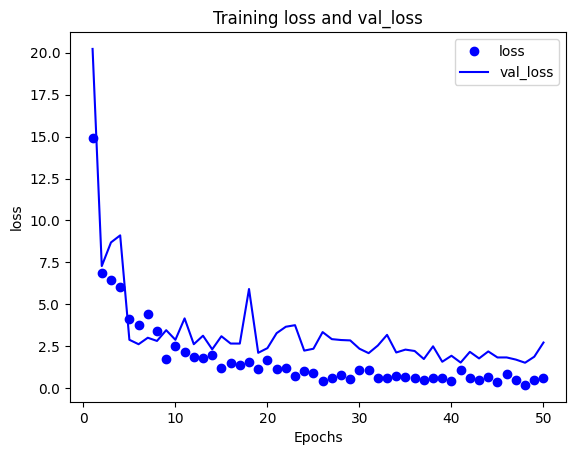

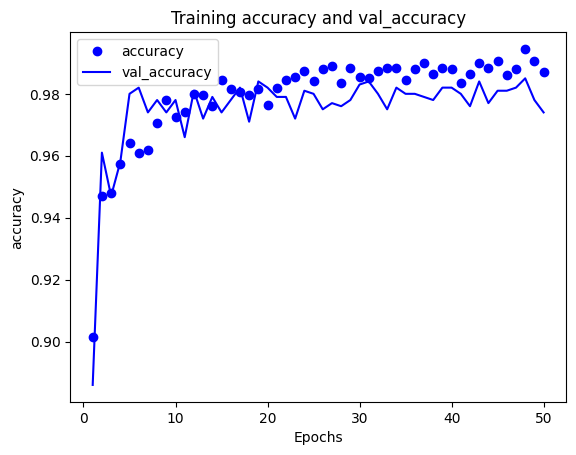

In [189]:
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [197]:
# Evaluate the model on test data
test_model = keras.models.load_model("ch8_model_feature_extraction_with_data_augmentation.keras")
test_loss, test_acc = test_model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc*100:.1f}%")

63/63 ━━━━━━━━━━━━━━━━━━━━ 16s 245ms/step - accuracy: 0.9768 - loss: 2.8863
Test accuracy: 97.6%


### 8.3.2 Fine-tuning a pretrained model

In [196]:
# Check the layers in conv_base
conv_base.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_68 (InputLayer)     │ (None, None, None, 3)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, None, None, 64) │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, None, None, 64) │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, None, None, 64) │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, None, None,     │        73,856 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, None, None,     │       147,584 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 128)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, None, None,     │       295,168 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, None, None,     │       590,080 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 256)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, None, None,     │     1,180,160 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, None, None,     │             0 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, None, None,     │     2,359,808 │
│                                 │ 512)                   │             

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 7,079,424 (27.01 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

In [191]:
## In previous part, we already freeze the conv_base and trained the custom classifier
## - those two are required before we jointly train some top conv_base layers along with the custom classifier
## - otherwise if we start with a random classifier, the error signal will be too large and will destroy the top conv_base layers
## - for fine tuning to work, all the trainable parameters should have a relatively good starting weights

# only set last 4 layers (three conv and one maxpool) trainable
conv_base.trainable = True
for layer in conv_base.layers[:-4]:
    layer.trainable = False

model.summary()

Model: "functional_65"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_75      │ (None, 180, 180,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ data_augmentation_… │ (None, 180, 180,  │          0 │ input_layer_75[0… │
│ (Sequential)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_9          │ (None, 180, 180)  │          0 │ data_augmentatio… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_10         │ (None, 180, 180)  │          0 │ data_augmentatio… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ get_item_11         │ (None, 180, 180)  │          0 │ data_augmentatio… │
│ (GetItem)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stack_3 (Stack)     │ (None, 180, 180,  │          0 │ get_item_9[0][0], │
│                     │ 3)                │            │ get_item_10[0][0… │
│                     │                   │            │ get_item_11[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_3 (Add)         │ (None, 180, 180,  │          0 │ stack_3[0][0]     │
│                     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ vgg16 (Functional)  │ (None, 5, 5, 512) │ 14,714,688 │ add_3[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_15          │ (None, 12800)     │          0 │ vgg16[3][0]       │
│ (Flatten)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_97 (Dense)    │ (None, 256)       │  3,277,056 │ flatten_15[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_46          │ (None, 256)       │          0 │ dense_97[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_98 (Dense)    │ (None, 1)         │        257 │ dropout_46[0][0]  │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 21,269,316 (81.14 MB)

 Trainable params: 10,356,737 (39.51 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

 Optimizer params: 3,277,315 (12.50 MB)

In [192]:
# Setup tensorboard
log_dir = "./tensorflowlog/ch8/fine_tuning"
setup_tensorboard(log_dir)

In [193]:
# train model
model.compile(
    loss="binary_crossentropy",
    optimizer=keras.optimizers.RMSprop(learning_rate=1e-5),
    metrics=["accuracy"]
)

callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="ch8_model_fine_tuning.keras",
        save_best_only=True,
        monitor="val_loss"
    ),
    keras.callbacks.TensorBoard(log_dir=log_dir)
]

history = model.fit(
    train_dataset,
    epochs=30,
    validation_data=validation_dataset,
    callbacks=callbacks
)

# plot loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

Epoch 1/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 32s 489ms/step - accuracy: 0.9903 - loss: 0.2346 - val_accuracy: 0.9810 - val_loss: 2.1130
Epoch 2/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 455ms/step - accuracy: 0.9880 - loss: 0.8231 - val_accuracy: 0.9800 - val_loss: 2.0433
Epoch 3/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 28s 445ms/step - accuracy: 0.9919 - loss: 0.3157 - val_accuracy: 0.9770 - val_loss: 2.5087
Epoch 4/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 27s 432ms/step - accuracy: 0.9889 - loss: 0.4355 - val_accuracy: 0.9740 - val_loss: 3.2741
Epoch 5/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 27s 430ms/step - accuracy: 0.9857 - loss: 0.8860 - val_accuracy: 0.9780 - val_loss: 2.3058
Epoch 6/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 27s 433ms/step - accuracy: 0.9863 - loss: 0.3460 - val_accuracy: 0.9770 - val_loss: 2.2640
Epoch 7/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 27s 434ms/step - accuracy: 0.9895 - loss: 0.3471 - val_accuracy: 0.9790 - val_loss: 1.8492
Epoch 8/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 27s 433ms/step - accuracy: 0.9944 - loss: 0.2514 - val_accu

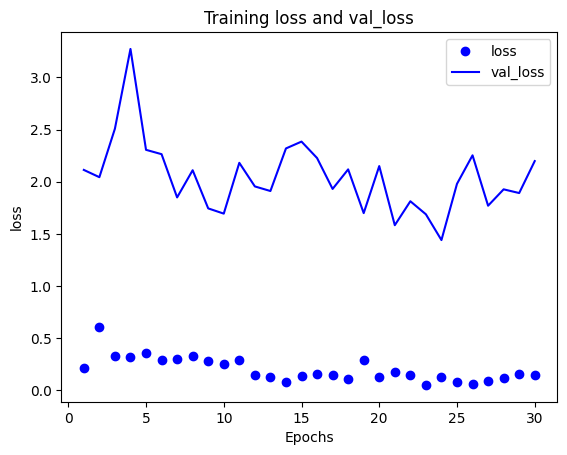

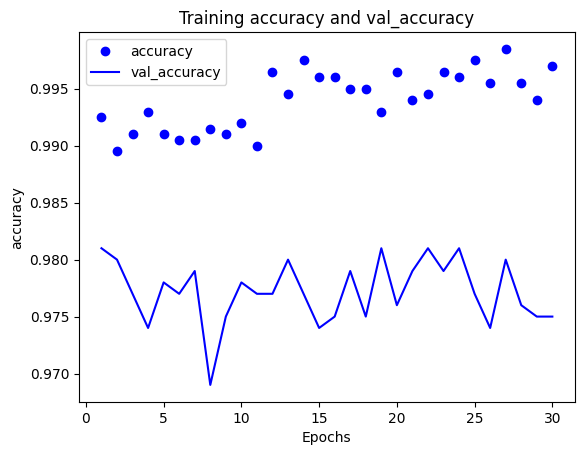

In [194]:
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [195]:
# evaluate the model on test data
model = keras.models.load_model("ch8_model_fine_tuning.keras")
test_loss, test_acc = model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc*100:.1f}%")

63/63 ━━━━━━━━━━━━━━━━━━━━ 16s 249ms/step - accuracy: 0.9772 - loss: 2.3194
Test accuracy: 97.5%


# CH9 Advanced deep learning for computer vision

## 9.2 An image segmentation example

In [ ]:
# Create the directory if it doesn't exist
!mkdir -p ../datasets/oxford_pets

# download dataset
!wget -P ../datasets/oxford_pets https://thor.robots.ox.ac.uk/~vgg/data/pets/images.tar.gz
!wget -P ../datasets/oxford_pets https://thor.robots.ox.ac.uk/~vgg/data/pets/annotations.tar.gz
!tar -xf ../datasets/oxford_pets/images.tar.gz -C ../datasets/oxford_pets
!tar -xf ../datasets/oxford_pets/annotations.tar.gz -C ../datasets/oxford_pets

--2024-05-05 17:37:16--  https://thor.robots.ox.ac.uk/~vgg/data/pets/images.tar.gz
Resolving thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)... 129.67.95.98
Connecting to thor.robots.ox.ac.uk (thor.robots.ox.ac.uk)|129.67.95.98|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://thor.robots.ox.ac.uk/datasets/pets/images.tar.gz [following]
--2024-05-05 17:37:16--  https://thor.robots.ox.ac.uk/datasets/pets/images.tar.gz
Reusing existing connection to thor.robots.ox.ac.uk:443.
HTTP request sent, awaiting response... 200 OK
Length: 791918971 (755M) [application/octet-stream]
Saving to: ‘../datasets/oxford_pets/images.tar.gz’

images.tar.gz       100%[===================>] 755.23M  4.08MB/s    in 1m 58s  

2024-05-05 17:39:15 (6.38 MB/s) - ‘../datasets/oxford_pets/images.tar.gz’ saved [791918971/791918971]

--2024-05-05 17:39:15--  https://thor.robots.ox.ac.uk/~vgg/data/pets/annotations.tar.gz
Resolving thor.robots.ox.ac.uk (thor.robots.ox.ac.uk).

In [213]:
# Prepare the list of input file paths and mask file paths
import os

input_dir = "../datasets/oxford_pets/images"
target_dir = "../datasets/oxford_pets/annotations/trimaps"

input_img_paths = sorted(
    [os.path.join(input_dir, fname)
        for fname in os.listdir(input_dir)  # all file names in the dir
        if fname.endswith(".jpg")]          # there are some .mat file, here we skip them
)

target_paths = sorted(
    [os.path.join(target_dir, fname)
        for fname in os.listdir(target_dir)
        if fname.endswith(".png") and not fname.startswith(".")]
)

print(f"Num of input images: {len(input_img_paths)}")
print(f"Num of target images: {len(target_paths)}")

Num of input images: 7390
Num of target images: 7390


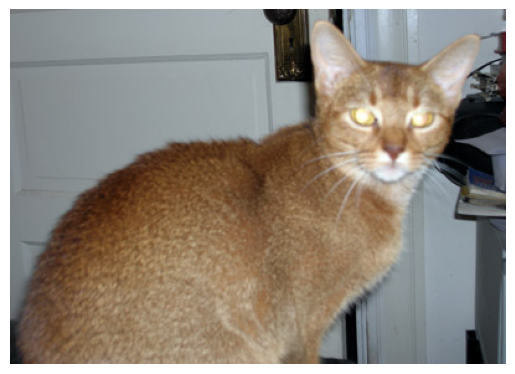

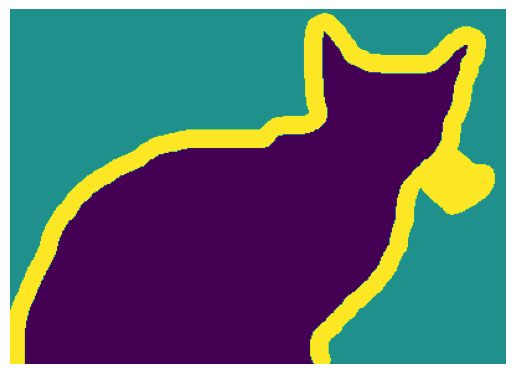

mask_img type: <class 'PIL.PngImagePlugin.PngImageFile'>
mask image_array.shape: (286, 400, 1)


In [306]:
import matplotlib.pyplot as plt
from tensorflow.keras.utils import load_img, img_to_array

# Display a sample image
plt.axis("off")
img = load_img(input_img_paths[9])  # img is PIL (Python Imaging Library) image object
plt.imshow(img)
plt.show()

# Display the corresponding target mask
def display_target(target_array):
    # convert values from (1, 2, 3) to (0, 127, 254) - (black, gray, near-white)
    normalized_array = (target_array.astype("uint8") - 1) * 127
    plt.clf()
    plt.axis("off")
    plt.imshow(normalized_array[:, :, 0])
    plt.show()

mask_img = load_img(target_paths[9], color_mode="grayscale")
mask_img_array = img_to_array(mask_img)
display_target(mask_img_array)
print(f"mask_img type: {type(mask_img)}")
print(f"mask image_array.shape: {mask_img_array.shape}")

In [217]:
## Load image files to array, split into training and validation
import numpy as np
import random

img_size = (200, 200)  # used in load_img
num_imgs = len(input_img_paths)

# same seed so input paths and target paths stay in the same order
random.Random(1337).shuffle(input_img_paths)   
random.Random(1337).shuffle(target_paths)

def input_path_to_array(input_img_path):
    return img_to_array(load_img(input_img_path, target_size=img_size))  # resize image in load_img

def target_path_to_array(target_img_path):
    img = img_to_array(
        load_img(target_img_path, target_size=img_size, color_mode="grayscale")
    )
    img = img.astype("uint8") - 1  # target pixel value will change from [1, 2, 3] to [0, 1, 2]
    return img

# Since dataset is small (size of 7390), we will load everything into memory
# instead of using image_dataset_from_directory?
input_imgs = np.zeros((num_imgs,) + img_size + (3,), dtype="float32")  # tuple + will concatenate them together
targets = np.zeros((num_imgs,) + img_size + (1,), dtype="uint8")

# load input and target images into numpy array
for i in range(num_imgs):
    input_imgs[i] = input_path_to_array(input_img_paths[i])
    targets[i] = target_path_to_array(target_paths[i])

num_val_samples = 1000
train_input_imgs = input_imgs[:-num_val_samples]
train_targets = targets[:-num_val_samples]
val_input_imgs = input_imgs[-num_val_samples:]
val_targets = targets[-num_val_samples:]

print(f"train_input_img.shape: {train_input_imgs.shape}")
print(f"val_input_img.shape: {val_input_imgs.shape}")
print(f"input img has shape: {train_input_imgs[0].shape}")
print(f"target img has shape: {train_targets[0].shape}")

train_input_img.shape: (6390, 200, 200, 3)
val_input_img.shape: (1000, 200, 200, 3)
input img has shape: (200, 200, 3)
target img has shape: (200, 200, 1)


Model: "functional_73"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_77 (InputLayer)     │ (None, 200, 200, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling_7 (Rescaling)         │ (None, 200, 200, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 100, 100, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_48 (Conv2D)              │ (None, 100, 100, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 50, 50, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 50, 50, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 25, 25, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_52 (Conv2D)              │ (None, 25, 25, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 25, 25, 256)    │       590,080 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 50, 50, 256)    │       590,080 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 50, 50, 128)    │       295,040 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 100, 100, 128)  │       147,584 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_4              │ (None, 100, 100, 64)   │        73,792 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_5              │ (None, 200, 200, 64)   │        36,928 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 200, 200, 3)    │         1,731 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,880,643 (10.99 MB)

 Trainable params: 2,880,643 (10.99 MB)

 Non-trainable params: 0 (0.00 B)

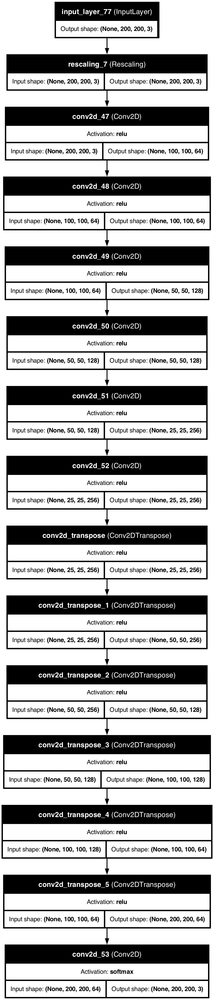

In [218]:
# Define the model
from tensorflow import keras
from tensorflow.keras import layers

def get_model(img_size, num_classes):
    inputs = keras.Input(shape=img_size + (3,))
    x = layers.Rescaling(1./255)(inputs)  # rescale input to [0-1] range

    # First half, downsample with strides for feature map size and increase the num of filters (features per pixel)
    # together we encode the images into smaller feature maps with each spatial location containing info about a large spatial chunk of the original image
    # common pattern: first a conv2d for downsampling with stride, then another conv2d without stride to extract detailed features
    x = layers.Conv2D(64, 3, strides=2, activation="relu", padding="same")(x)    # padding="same" to avoid the influence of border padding on feature map size
    x = layers.Conv2D(64, 3, activation="relu", padding="same")(x)
    x = layers.Conv2D(128, 3, strides=2, activation="relu", padding="same")(x)
    x = layers.Conv2D(128, 3, activation="relu", padding="same")(x)
    x = layers.Conv2D(256, 3, strides=2, activation="relu", padding="same")(x)
    x = layers.Conv2D(256, 3, activation="relu", padding="same")(x)

    # Upsample the feature maps from (25, 25, 256) to (200, 200, 3)
    # kinda in the reverse order of first half
    x = layers.Conv2DTranspose(256, 3, activation="relu", padding="same")(x)
    x = layers.Conv2DTranspose(256, 3, activation="relu", padding="same", strides=2)(x)
    x = layers.Conv2DTranspose(128, 3, activation="relu", padding="same")(x)
    x = layers.Conv2DTranspose(128, 3, activation="relu", padding="same", strides=2)(x)
    x = layers.Conv2DTranspose(64, 3, activation="relu", padding="same")(x)
    x = layers.Conv2DTranspose(64, 3, activation="relu", padding="same", strides=2)(x)

    # end the model with a per-pixel three-way softmax to classify each output pixel into one of the three categories
    outputs = layers.Conv2D(num_classes, 3, activation="softmax", padding="same")(x)

    model = keras.Model(inputs, outputs)
    return model

model = get_model(img_size=img_size, num_classes=3)
model.summary()

keras.utils.plot_model(model, "ch9_oxford_segmentation.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [235]:
# Setup tensorboard
log_dir = "./tensorflowlog/ch9/oxford_segmentation"
setup_tensorboard(log_dir)

python(55429) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


In [236]:
# Compile and train model
model.compile(
    optimizer="rmsprop",
    loss="sparse_categorical_crossentropy",  # label is an integer instead of one-hot vector in categorical_crossentropy
    metrics=["accuracy"]
)

callbacks = [
    keras.callbacks.ModelCheckpoint("oxford_segmentation.keras", save_best_only=True),
    keras.callbacks.TensorBoard(log_dir=log_dir)
]

history = model.fit(train_input_imgs, train_targets,
                   epochs=50,
                   callbacks=callbacks,
                   batch_size=64,
                   validation_data=(val_input_imgs, val_targets))

# plot loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

Epoch 1/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 147s 1s/step - accuracy: 0.8141 - loss: 0.4732 - val_accuracy: 0.8335 - val_loss: 0.4236
Epoch 2/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 134s 1s/step - accuracy: 0.8387 - loss: 0.4106 - val_accuracy: 0.8395 - val_loss: 0.4199
Epoch 3/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 132s 1s/step - accuracy: 0.8381 - loss: 0.4143 - val_accuracy: 0.8452 - val_loss: 0.3952
Epoch 4/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 132s 1s/step - accuracy: 0.8413 - loss: 0.4051 - val_accuracy: 0.8482 - val_loss: 0.3871
Epoch 5/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 149s 1s/step - accuracy: 0.8447 - loss: 0.3980 - val_accuracy: 0.8466 - val_loss: 0.3891
Epoch 6/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 150s 1s/step - accuracy: 0.8488 - loss: 0.3867 - val_accuracy: 0.8483 - val_loss: 0.3871
Epoch 7/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 150s 2s/step - accuracy: 0.8485 - loss: 0.3934 - val_accuracy: 0.8483 - val_loss: 0.3889
Epoch 8/50
100/100 ━━━━━━━━━━━━━━━━━━━━ 150s 1s/step - accuracy: 0.8482 - loss: 0.3923 - val_accu

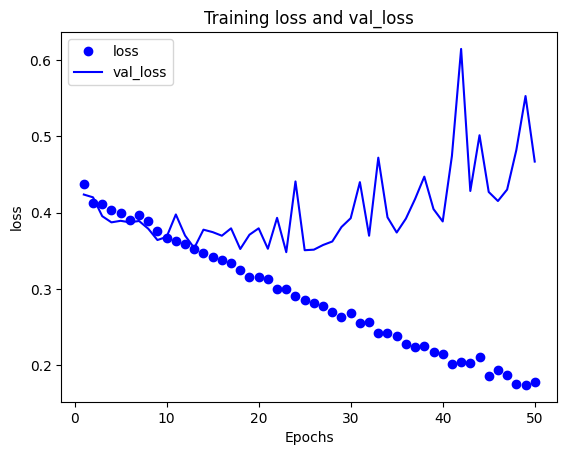

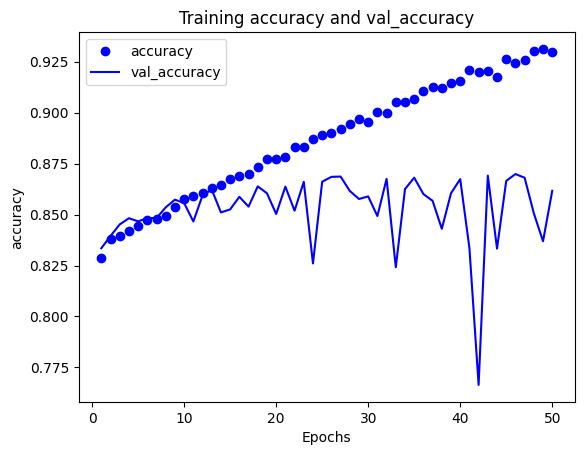

In [237]:
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

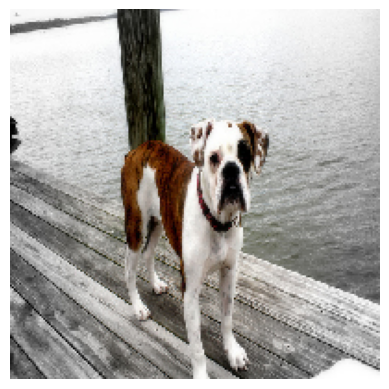

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 869ms/step
pred.shape: (200, 200, 3)
mask.shape: (200, 200)


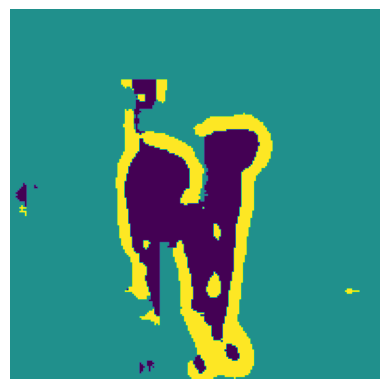

In [301]:
# Use trained model to predict a segmentation mask
from tensorflow.keras.utils import array_to_img

model = keras.models.load_model("oxford_segmentation.keras")

i = 4
test_image = val_input_imgs[i]
# plt.subplot(1, 2, 1) 
plt.axis("off")
plt.imshow(array_to_img(test_image))  # creates the image plot, but it doesn’t display it immediately.
plt.show()  # displays all the figures and plots

# In the context of machine learning models, especially those using TensorFlow or Keras, the input often needs to be a batch of data, even if that "batch" is just one image.
# By expanding the dimensions (axis=0 adds an extra dimension at the start),
# you change the shape from (height, width, channels) to (1, height, width, channels), which is a batch with one image.
preds = model.predict(np.expand_dims(test_image, 0))  # model.predict works for a batch of samples
pred = preds[0]   # pred last axis has 3 channels, pred[i][j][:] are from softmaxt activation, which are probabilities for three classes
print(f"pred.shape: {pred.shape}")   

def display_mask(pred):
    # pred has shape of (height, width, 3), the 3 values in the last axis are probabilities of 3 classes
    # np.argmax on the last axis will convert softmax results to index, which is discrete mask class number in [0, 1, 2]
    # np.argmax reduces the dimensionality by one when applied along a specific axis, beacuase its reasult is a scalar of shape ()
    # mask will have shape (height, width), the last axis values in [0, 1, 2]
    mask = np.argmax(pred, axis=-1)  
    print(f"mask.shape: {mask.shape}")   
    mask *= 127
    # plt.subplot(1, 2, 2) 
    plt.clf()
    plt.axis("off")
    plt.imshow(mask) # the last imshow() can display without using an explicit plt.show()

display_mask(pred)

## 9.3 Modern convnet architecture patterns

### 9.3.2 Residual connections

Model: "functional_75"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_78      │ (None, 32, 32, 3) │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_8         │ (None, 32, 32, 3) │          0 │ input_layer_78[0… │
│ (Rescaling)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_54 (Conv2D)  │ (None, 32, 32,    │        896 │ rescaling_8[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_55 (Conv2D)  │ (None, 32, 32,    │      9,248 │ conv2d_54[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_36    │ (None, 16, 16,    │          0 │ conv2d_55[0][0]   │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_56 (Conv2D)  │ (None, 16, 16,    │        128 │ rescaling_8[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_4 (Add)         │ (None, 16, 16,    │          0 │ max_pooling2d_36… │
│                     │ 32)               │            │ conv2d_56[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_57 (Conv2D)  │ (None, 16, 16,    │     18,496 │ add_4[0][0]       │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_58 (Conv2D)  │ (None, 16, 16,    │     36,928 │ conv2d_57[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_37    │ (None, 8, 8, 64)  │          0 │ conv2d_58[0][0]   │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_59 (Conv2D)  │ (None, 8, 8, 64)  │      2,112 │ add_4[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_5 (Add)         │ (None, 8, 8, 64)  │          0 │ max_pooling2d_37… │
│                     │                   │            │ conv2d_59[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_60 (Conv2D)  │ (None, 8, 8, 128) │     73,856 │ add_5[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_61 (Conv2D)  │ (None, 8, 8, 128) │    147,584 │ conv2d_60[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_62 (Conv2D)  │ (None, 8, 8, 128) │      8,320 │ add_5[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_6 (Add)         │ (None, 8, 8, 128) │          0 │ conv2d_61[0][0],  │
│                     │                   │            │ conv2d_62[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ global_average_poo… │ (None, 128)       │          0 │ add_6[0][0]       │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_99 (Dense)    │ (None, 1)         │        129 │ global_average_p… │
└─────────────────────┴───────────────────┴────────────┴─────────────────

 Total params: 297,697 (1.14 MB)

 Trainable params: 297,697 (1.14 MB)

 Non-trainable params: 0 (0.00 B)

python(72023) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(72025) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


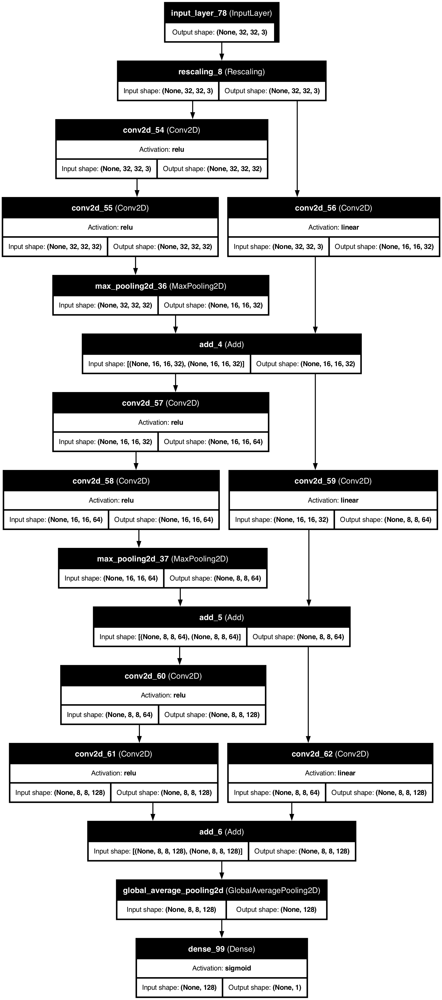

In [239]:
from tensorflow import keras
from tensorflow.keras import layers

inputs = keras.Input(shape=(32, 32, 3))
x = layers.Rescaling(1./255)(inputs)

def residual_block(x, filters, pooling=False):
    """
    Convolutional block with a residual connection, with an option to add a max pooling,
    two Conv2D layers + optional maxpooling, with residual connection
    param x : the block input
    param filters: the output num of filters
    """
    residual = x
    x = layers.Conv2D(filters, 3, activation="relu", padding="same")(x)
    x = layers.Conv2D(filters, 3, activation="relu", padding="same")(x)
    if pooling:
        x = layers.MaxPooling2D(2, padding="same")(x)
        residual = layers.Conv2D(filters, 1, strides=2)(residual)   # strides to match the output shape
    elif filters != residual.shape[-1]:
        residual = layers.Conv2D(filters, 1)(residual)

    x = layers.add([x, residual])  # elementwise addition of two tensors of the same shape

    return x

x = residual_block(x, filters=32, pooling=True)
x = residual_block(x, filters=64, pooling=True)
x = residual_block(x, filters=128, pooling=False)
# If the input shape is (batch_size, height, width, channels), 
# GlobalAveragePooling2D will compute the average across the height and width dimensions, resulting in (batch_size, channels).
x = layers.GlobalAveragePooling2D()(x)
# the Dense layer requires input of shape (batch_size, features)
outputs = layers.Dense(1, activation="sigmoid")(x)

model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

keras.utils.plot_model(model, "ch9_residual_connection.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

### 9.3.5 A mini Xception-like model

In [242]:
# Use previous dog vs cat dataset with image_dataset_from_directory to read images
from tensorflow.keras.utils import image_dataset_from_directory

new_base_dir = pathlib.Path("../datasets/dogs_vs_cats_small")

train_dataset = image_dataset_from_directory(
    new_base_dir / "train",
    image_size=(180, 180),
    batch_size=32
)
validation_dataset = image_dataset_from_directory(
    new_base_dir / "validation",
    image_size=(180, 180),
    batch_size=32
)
test_dataset = image_dataset_from_directory(
    new_base_dir / "test",
    image_size=(180, 180),
    batch_size=32
)

data_augmentation = keras.Sequential(
    [
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(0.1),
        layers.RandomZoom(0.2),
    ]
)

Found 2000 files belonging to 2 classes.
Found 1000 files belonging to 2 classes.
Found 2000 files belonging to 2 classes.


Model: "functional_81"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_81      │ (None, 180, 180,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_2        │ (None, 180, 180,  │          0 │ input_layer_81[0… │
│ (Sequential)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_10        │ (None, 180, 180,  │          0 │ sequential_2[0][… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_69 (Conv2D)  │ (None, 176, 176,  │      2,400 │ rescaling_10[0][… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 176, 176,  │        128 │ conv2d_69[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_10       │ (None, 176, 176,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ separable_conv2d_10 │ (None, 176, 176,  │      1,312 │ activation_10[0]… │
│ (SeparableConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 176, 176,  │        128 │ separable_conv2d… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_11       │ (None, 176, 176,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ separable_conv2d_11 │ (None, 176, 176,  │      1,312 │ activation_11[0]… │
│ (SeparableConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_43    │ (None, 88, 88,    │          0 │ separable_conv2d… │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_70 (Conv2D)  │ (None, 88, 88,    │      1,024 │ conv2d_69[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_12 (Add)        │ (None, 88, 88,    │          0 │ max_pooling2d_43… │
│                     │ 32)               │            │ conv2d_70[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 88, 88,    │        128 │ add_12[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_12       │ (None, 88, 88,    │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ separable_conv2d_12 │ (None, 88, 88,    │      2,336 │ activation_12[0]… │
│ (SeparableConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 88, 88,    │        256 │ separable_conv2d

 Total params: 721,857 (2.75 MB)

 Trainable params: 718,849 (2.74 MB)

 Non-trainable params: 3,008 (11.75 KB)

python(87975) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(87976) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


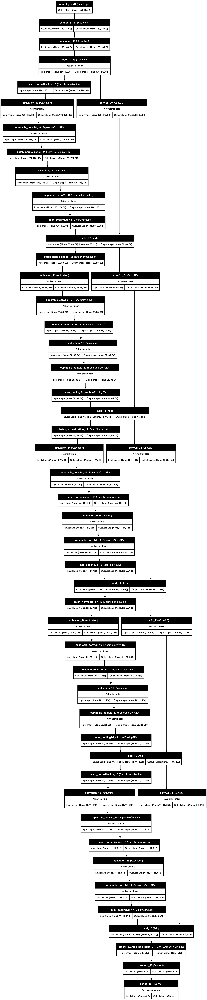

In [243]:
inputs = keras.Input(shape=(180, 180, 3))
x = data_augmentation(inputs)

x = layers.Rescaling(1./255)(x)  # input rescaling
# firs layer is Conv2D instead of SeparableConv2D, because the original image RGB channles are not independent
# no bias, becuase later we use BatchNormalization; notice we do not use activation, which is added later
x = layers.Conv2D(filters=32, kernel_size=5, use_bias=False)(x)  

for size in [32, 64, 128, 256, 512]:
    residual = x

    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)    # separate activation after BN
    x = layers.SeparableConv2D(size, 3, padding="same", use_bias=False)(x)  # default use_bias is True and padding is "valid"

    x = layers.BatchNormalization()(x)
    x = layers.Activation("relu")(x)
    x = layers.SeparableConv2D(size, 3, padding="same", use_bias=False)(x)

    x = layers.MaxPooling2D(3, strides=2, padding="same")(x)

    residual = layers.Conv2D(size, 1, strides=2, padding="same", use_bias=False)(residual)  # strides=2 to match the previous MaxPooling2D
    x = layers.add([x, residual])

# If the input shape is (batch_size, height, width, channels), 
#   GlobalAveragePooling2D will compute the average across the height and width dimensions, resulting in (batch_size, channels).
# For comparison, the Flatten layer changes (batch_size, height, width, channels) to (batch_size, height * width * channels).
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)

model = keras.Model(inputs=inputs, outputs=outputs)

model.summary()

keras.utils.plot_model(model, "ch9_mini_xception.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [244]:
# Setup tensorboard
log_dir = "./tensorflowlog/ch9/miniXception"
setup_tensorboard(log_dir)

python(88076) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


In [245]:
model.compile(loss="binary_crossentropy",
             optimizer="rmsprop",
             metrics=["accuracy"])

# train the model
callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="ch9_model_convnet_miniXception.keras",
        save_best_only=True,
        monitor="val_loss"
    ), 
    keras.callbacks.TensorBoard(log_dir=log_dir)
]

history = model.fit(
    train_dataset,
    epochs=100,
    validation_data=validation_dataset,
    callbacks=callbacks
)

# plot loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

Epoch 1/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 44s 530ms/step - accuracy: 0.5287 - loss: 0.7449 - val_accuracy: 0.4990 - val_loss: 0.6965
Epoch 2/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 31s 485ms/step - accuracy: 0.6038 - loss: 0.6872 - val_accuracy: 0.4990 - val_loss: 0.6958
Epoch 3/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 461ms/step - accuracy: 0.6147 - loss: 0.6509 - val_accuracy: 0.5000 - val_loss: 0.7797
Epoch 4/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 468ms/step - accuracy: 0.6518 - loss: 0.6335 - val_accuracy: 0.5000 - val_loss: 0.7262
Epoch 5/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 453ms/step - accuracy: 0.6829 - loss: 0.5976 - val_accuracy: 0.5000 - val_loss: 0.7115
Epoch 6/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 28s 446ms/step - accuracy: 0.6910 - loss: 0.5946 - val_accuracy: 0.5000 - val_loss: 0.7408
Epoch 7/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 30s 470ms/step - accuracy: 0.6887 - loss: 0.5754 - val_accuracy: 0.5030 - val_loss: 0.8817
Epoch 8/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 461ms/step - accuracy: 0.7267 - loss: 0.5440 - 

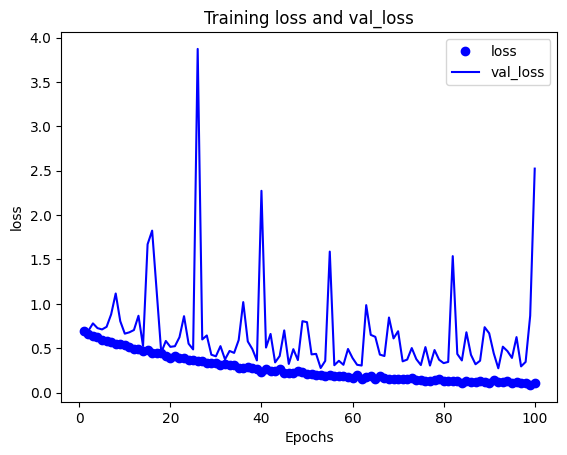

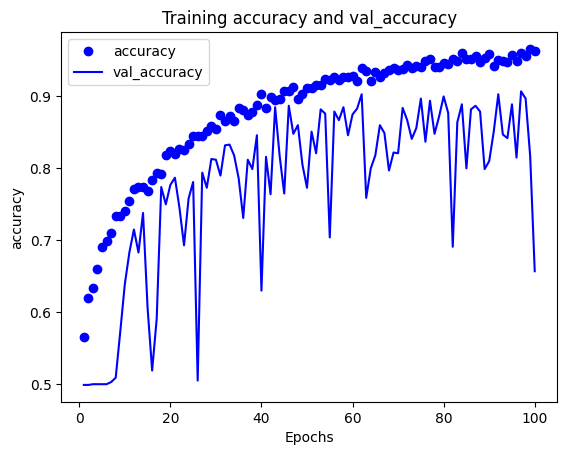

In [246]:
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [247]:
# evaluate the model on test data
model = keras.models.load_model("ch9_model_convnet_miniXception.keras")
test_loss, test_acc = model.evaluate(test_dataset)
print(f"Test accuracy: {test_acc*100:.1f}%")

63/63 ━━━━━━━━━━━━━━━━━━━━ 7s 89ms/step - accuracy: 0.8946 - loss: 0.3264
Test accuracy: 89.2%


## 9.4 Interpreting what convnets learn

### 9.4.1 Visualizing intermediate activations

img_tensor.shape: (1, 180, 180, 3)


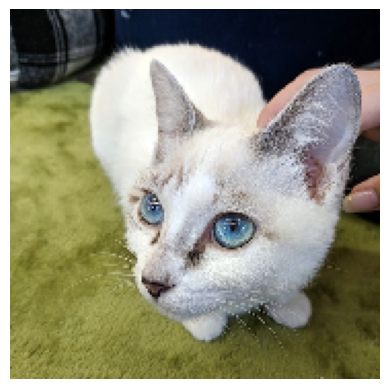

In [263]:
# A totally new image, not part of the train dataset
import numpy as np

img_path = keras.utils.get_file(
    fname = "cat.jpg",
    origin="https://img-datasets.s3.amazonaws.com/cat.jpg"
)

def get_img_array(img_path, target_size):
    img = keras.utils.load_img(img_path, target_size=target_size)
    array = keras.utils.img_to_array(img)  # turn it into float32 numpy array
    array = np.expand_dims(array, axis=0)  # add batch_size dimension
    return array

img_tensor = get_img_array(img_path, target_size=(180, 180))
print(f"img_tensor.shape: {img_tensor.shape}")

# display image
import matplotlib.pyplot as plt
plt.axis("off")
plt.imshow(img_tensor[0].astype("uint8"))
plt.show()

num of model outputs: 9
model output layer names: ['conv2d_32', 'max_pooling2d_24', 'conv2d_33', 'max_pooling2d_25', 'conv2d_34', 'max_pooling2d_26', 'conv2d_35', 'max_pooling2d_27', 'conv2d_36']


Model: "functional_104"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_51 (InputLayer)     │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ data_augmentation_layer         │ (None, 180, 180, 3)    │             0 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling_4 (Rescaling)         │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_32 (Conv2D)              │ (None, 178, 178, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 89, 89, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 87, 87, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 43, 43, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 41, 41, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 20, 20, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 18, 18, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 9, 9, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_36 (Conv2D)              │ (None, 7, 7, 256)      │       590,080 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 978,496 (3.73 MB)

 Trainable params: 978,496 (3.73 MB)

 Non-trainable params: 0 (0.00 B)

python(96549) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(96550) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


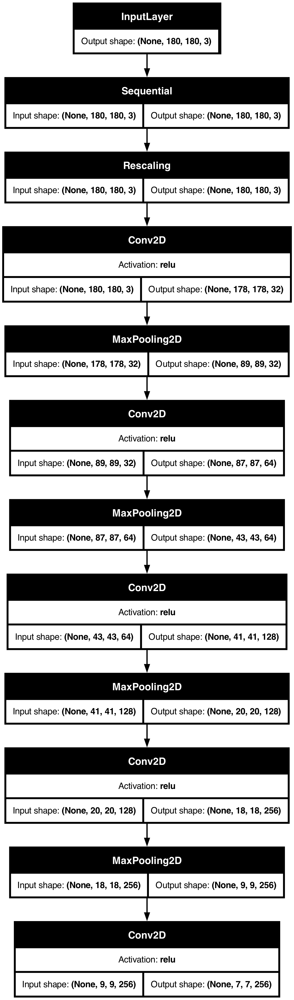

In [264]:
# Instantiating a model that returns layer activations
# the model takes batches of images as input, and outputs the activations of all conv and pooling layers
from tensorflow.keras import layers

layer_outputs = []
layer_names = []

for layer in model.layers:
    if isinstance(layer, (layers.Conv2D, layers.MaxPooling2D)):
        layer_outputs.append(layer.output)
        layer_names.append(layer.name)
print(f"num of model outputs: {len(layer_outputs)}")
print(f"model output layer names: {layer_names}")

activation_model = keras.Model(inputs=model.input, outputs=layer_outputs)   # one input, multiple outputs

activation_model.summary()
# keras.utils.plot_model(activation_model, show_shapes=True, show_layer_activations=True)

keras.utils.plot_model(activation_model, "ch8_activation_model.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

Model: "functional_41"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_51 (InputLayer)     │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ data_augmentation_layer         │ (None, 180, 180, 3)    │             0 │
│ (Sequential)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling_4 (Rescaling)         │ (None, 180, 180, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_32 (Conv2D)              │ (None, 178, 178, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_24 (MaxPooling2D) │ (None, 89, 89, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 87, 87, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_25 (MaxPooling2D) │ (None, 43, 43, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 41, 41, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_26 (MaxPooling2D) │ (None, 20, 20, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 18, 18, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_27 (MaxPooling2D) │ (None, 9, 9, 256)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_36 (Conv2D)              │ (None, 7, 7, 256)      │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_8 (Flatten)             │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_41 (Dropout)            │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_86 (Dense)                │ (None, 1)              │        12,545 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,982,084 (7.56 MB)

 Trainable params: 991,041 (3.78 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 991,043 (3.78 MB)

python(96543) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
python(96544) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


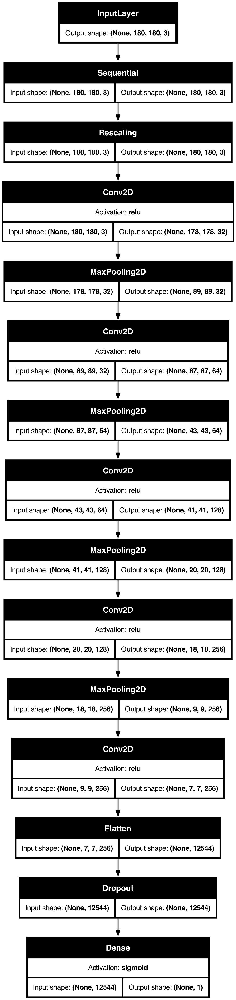

In [262]:
from tensorflow import keras
# use ch8.2.5 model for dogs-vs-cats classification
model = keras.models.load_model("ch8_model_convnet_from_scratch_with_augmentation.keras")

model.summary()

keras.utils.plot_model(model, "ch8_convnet_from_scratch_with_augmentation.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 354ms/step
len(activations): 9
first_layer_activation.shape: (1, 178, 178, 32)
first_layer_activation name: conv2d_32


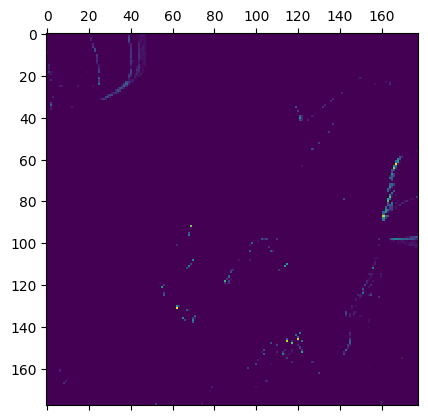

In [265]:
# Instantiating a model that returns layer activations
# the model takes batches of images as input, and outputs the activations of all conv and pooling layers

activations = activation_model.predict(img_tensor)  # returns a list of numpy arrays, one array per layer activation
print(f"len(activations): {len(activations)}")

first_layer_activation = activations[0]
print(f"first_layer_activation.shape: {first_layer_activation.shape}")
print(f"first_layer_activation name: {layer_names[0]}")

plt.matshow(first_layer_activation[0, :, :, 5], cmap="viridis")  # visualize the 5th channel

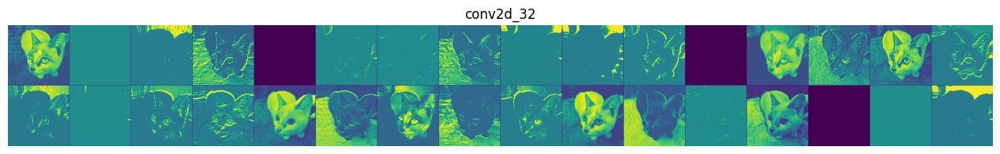

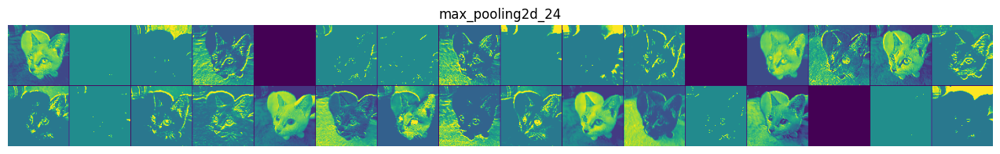

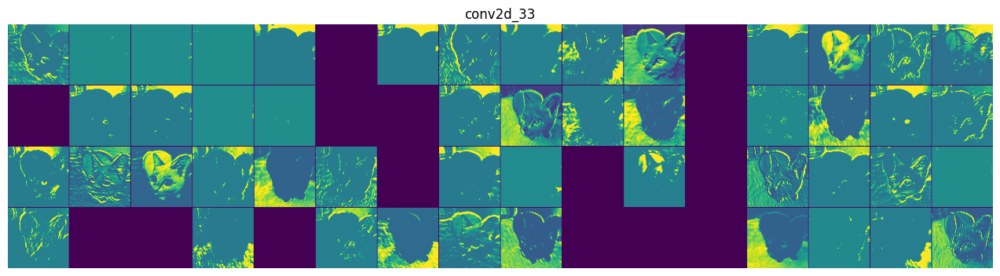

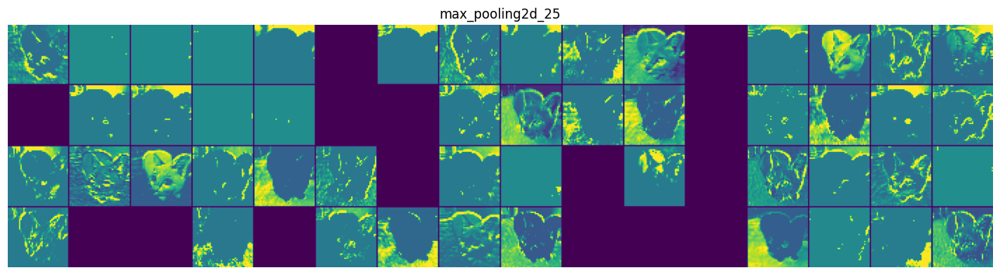

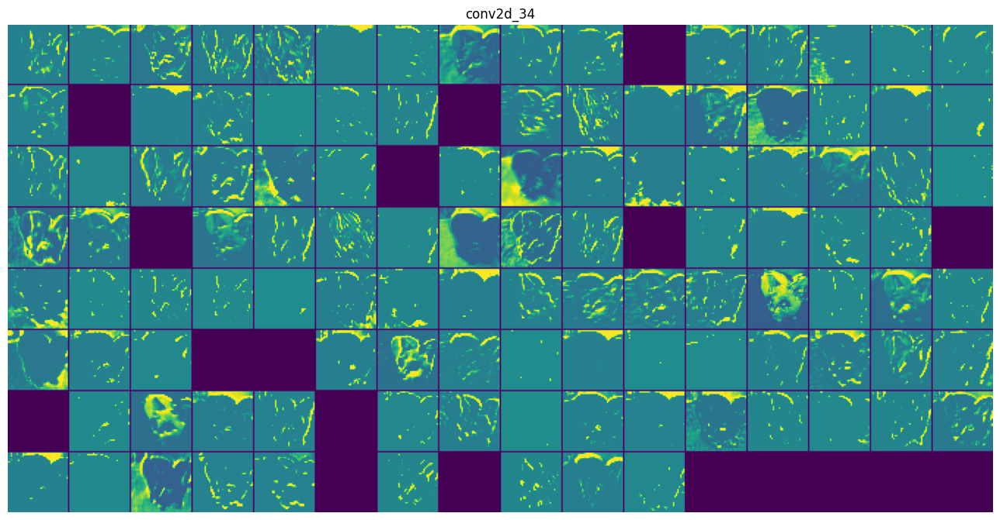

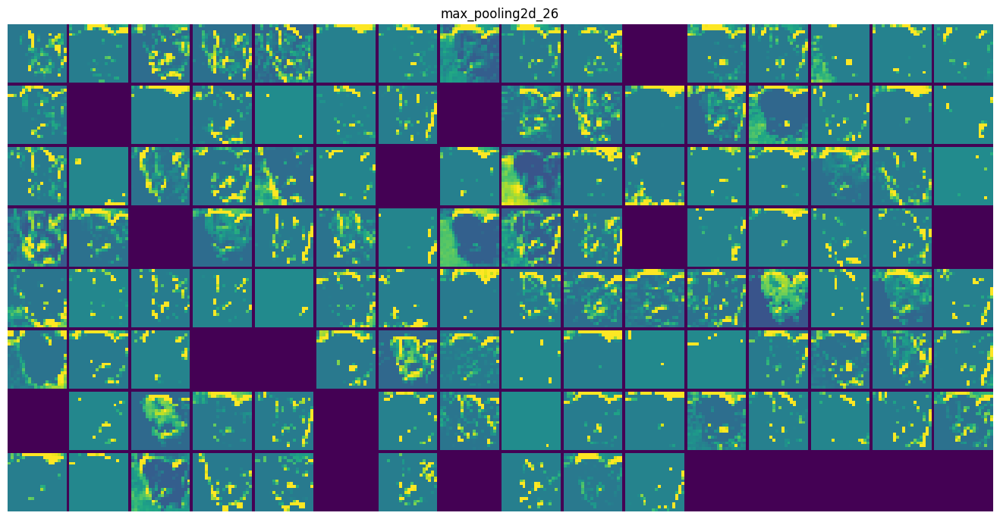

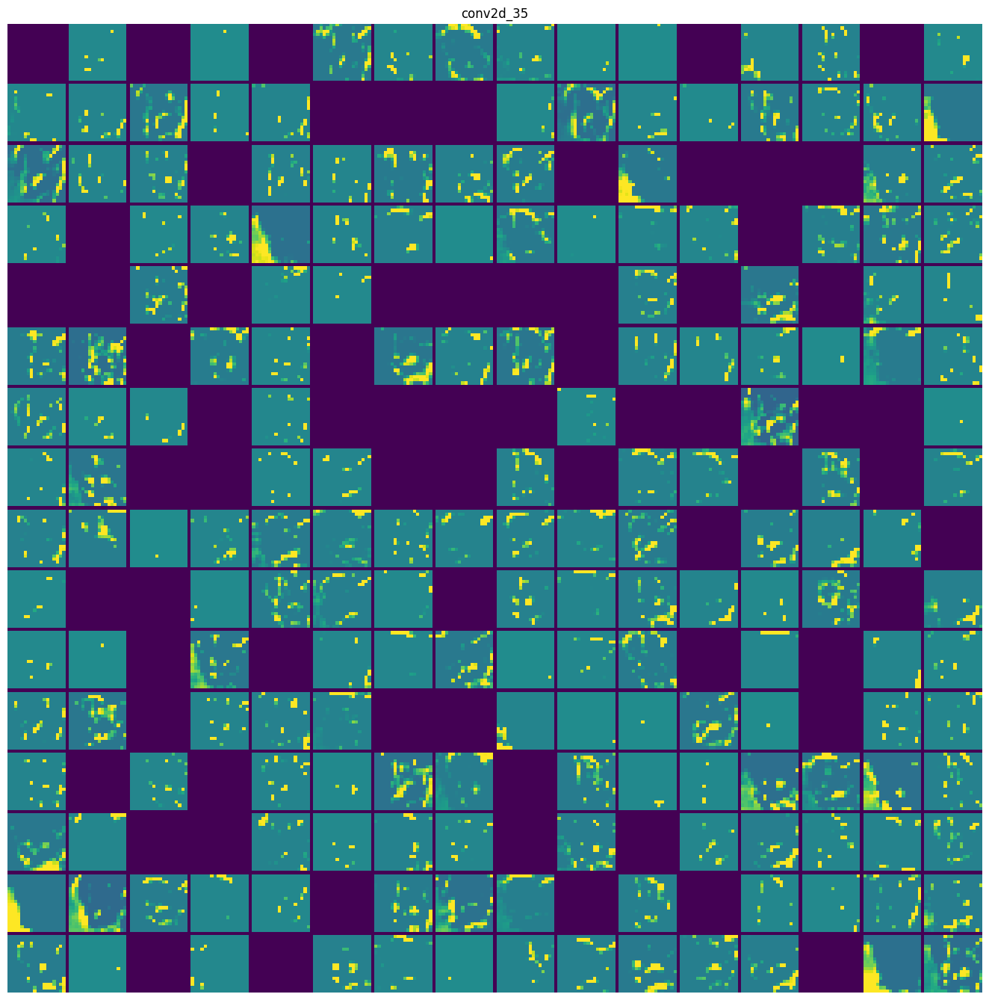

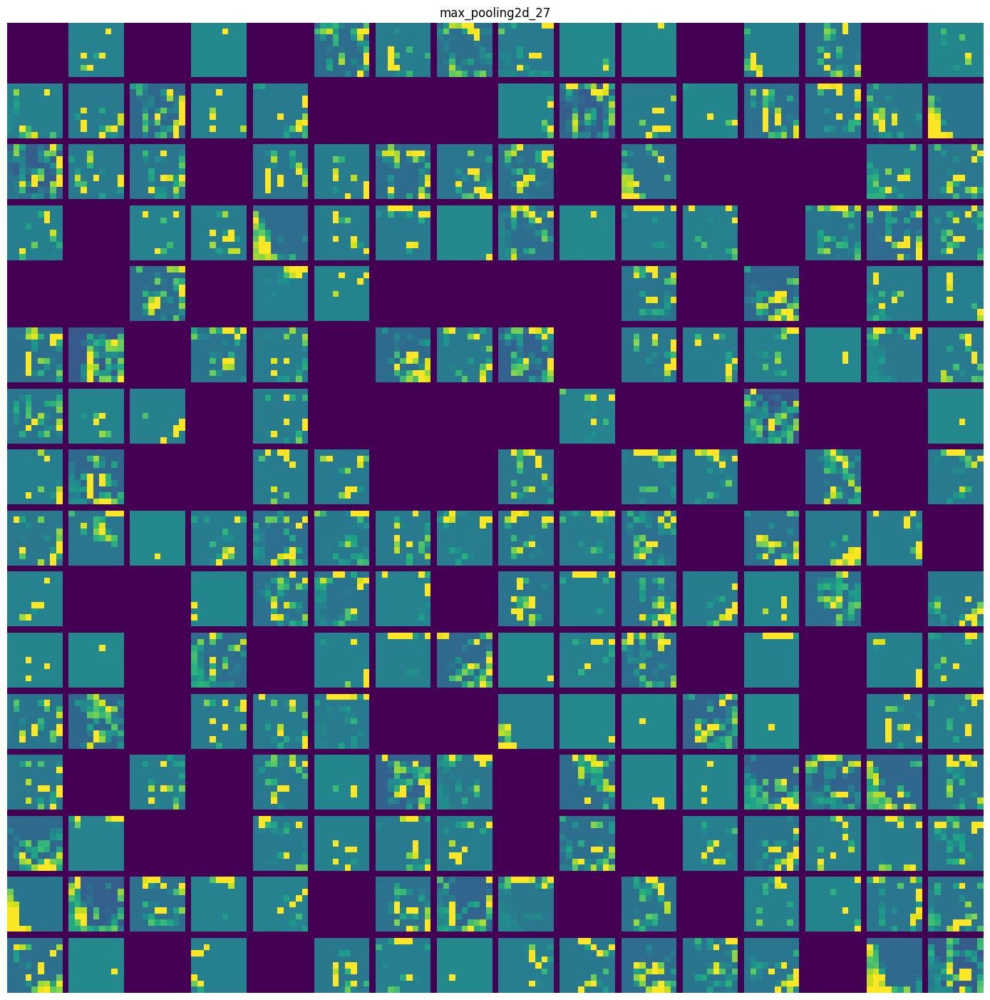

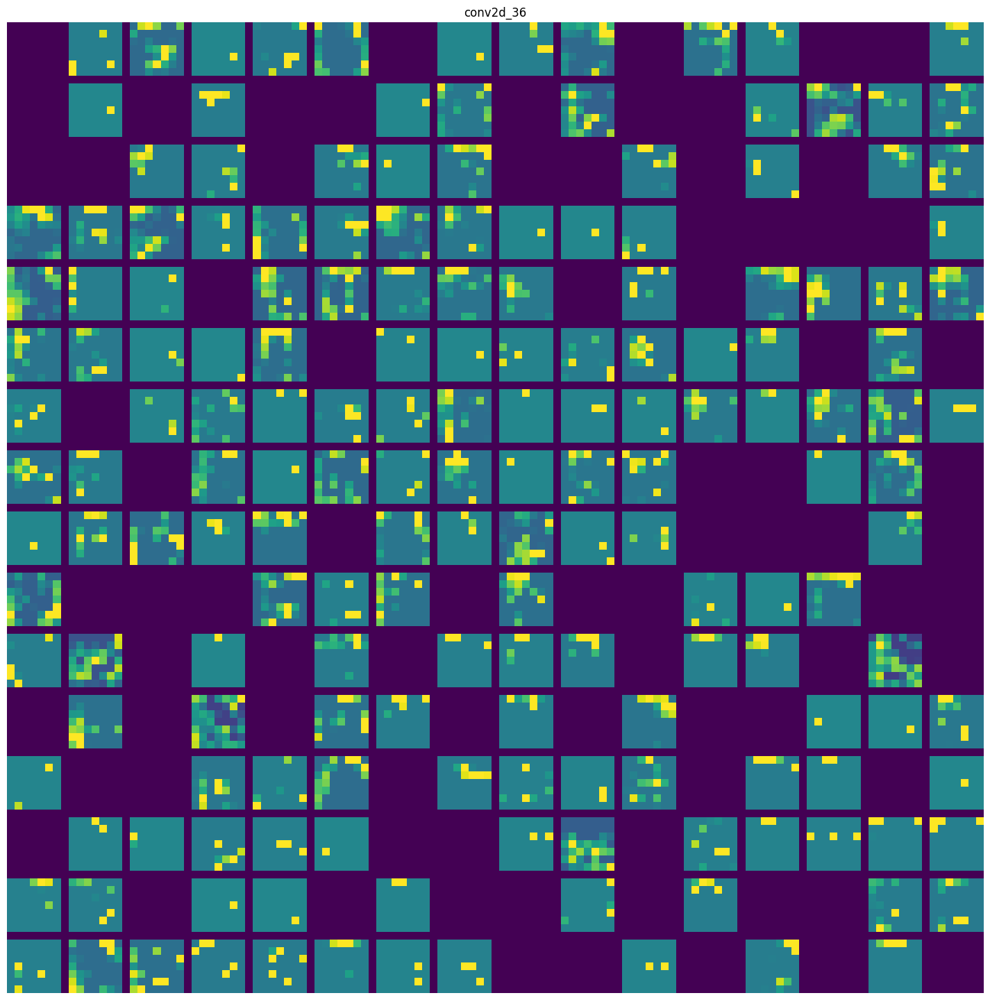

In [269]:
# Visualizing every channel output in all the intermediate activation layers (conv2d and maxpooling)
images_per_row = n_cols = 16

for layer_name, layer_activation in zip(layer_names, activations):
    # layer_activation has shape (1, feature_map_height, feature_map_width, n_features/n_channels)
    n_features = layer_activation.shape[-1]  # num of feature outptus in this layer
    size = layer_activation.shape[1]         # height == width
    n_rows = n_features // images_per_row
    display_grid = np.zeros((n_rows * (size + 1) - 1, n_cols * (size + 1) - 1))

    for row in range(n_rows):
        for col in range(n_cols):
            channel_index = row * images_per_row + col
            channel_image = layer_activation[0, :, :, channel_index].copy()
            # normalize channel values within [0, 255]. 
            # For a all-zero channel, it is kept at zero.
            if channel_image.sum() != 0:
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128   # new values Normal_Distribution(128, 64)
            channel_image = np.clip(channel_image, 0, 255).astype("uint8")
            display_grid[
                row * (size  + 1) : (row + 1) * size + row,
                col * (size  + 1) : (col + 1) * size + col] = channel_image

    scale = 1./size
    plt.figure(figsize=(scale * display_grid.shape[1],
                       scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.axis("off")
    plt.imshow(display_grid, aspect="auto", cmap="viridis")

### 9.4.2 Visualizing convnet filters: display the visual pattern that each filter is meant to respond to

In [270]:
# Instantiating the Xception convolutional base
model = keras.applications.xception.Xception(
    weights="imagenet",
    include_top=False  # the classification layers are irrelevant for this use case of visualizing convnet filters
)

# Display all the Conv2D and SeparableConv2D layer names for Xception model
for layer in model.layers:
    if isinstance(layer, (keras.layers.Conv2D, keras.layers.SeparableConv2D)):
        print(layer.name)

block1_conv1
block1_conv2
block2_sepconv1
block2_sepconv2
conv2d_75
block3_sepconv1
block3_sepconv2
conv2d_76
block4_sepconv1
block4_sepconv2
conv2d_77
block5_sepconv1
block5_sepconv2
block5_sepconv3
block6_sepconv1
block6_sepconv2
block6_sepconv3
block7_sepconv1
block7_sepconv2
block7_sepconv3
block8_sepconv1
block8_sepconv2
block8_sepconv3
block9_sepconv1
block9_sepconv2
block9_sepconv3
block10_sepconv1
block10_sepconv2
block10_sepconv3
block11_sepconv1
block11_sepconv2
block11_sepconv3
block12_sepconv1
block12_sepconv2
block12_sepconv3
block13_sepconv1
block13_sepconv2
conv2d_78
block14_sepconv1
block14_sepconv2


In [273]:
# Create a feature extractor model
layer_name = "block3_sepconv1"
layer = model.get_layer(name=layer_name)
feature_extractor = keras.Model(inputs=model.input, outputs=layer.output)  # from beginning till the specified layer

feature_extractor.summary()

# Using the feature extractor
activation = feature_extractor(keras.applications.xception.preprocess_input(img_tensor))
print(f"activation.shape: {activation.shape}")

Model: "functional_110"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_83      │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, None,      │        864 │ input_layer_83[0… │
│ (Conv2D)            │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, None,      │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, None,      │          0 │ block1_conv1_bn[… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, None,      │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, None,      │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, None,      │          0 │ block1_conv2_bn[… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, None,      │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, None,      │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, None,      │          0 │ block2_sepconv1_… │
│ (Activation)        │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, None,      │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, None,      │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_75 (Conv2D)  │ (None, None,      │      8,192 │ block1_conv2_act… │
│                     │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, None,      │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        512 │ conv2d_75[0][0]   │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_17 (Add)        │ (None, None,      │          0 │ block2_pool[0][0… │
│                     │ None, 128)        │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, None,      │          0 │ add_17[0][0]    

 Total params: 89,632 (350.12 KB)

 Trainable params: 88,672 (346.38 KB)

 Non-trainable params: 960 (3.75 KB)

activation.shape: (1, 44, 44, 256)


In [274]:
# scalar value for how much a given input image "activates" a given filter in the layer
import tensorflow as tf

def compute_loss(image, filter_index):
    """
    Compute a scalar value quantifying how much a given input image "activates" a given filter in the layer.
    The scalar value is the mean value of the activation tensor.
    """
    activation = feature_extractor(image)   # activation shape (1, height, width, channels)
    # avoid border artifacts by only involving non-border pixels
    filter_activation = activation[:, 2:-2, 2:-2, filter_index]  
    return tf.reduce_mean(filter_activation)

# Loss maximization via stochastic gradient ascent
@tf.function
def gradient_ascent_step(image, filter_index, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(image) # explicitly watch the image tensor, since it isn't a tf Variable
        loss = compute_loss(image, filter_index)
    grads = tape.gradient(loss, image)
    grads = tf.math.l2_normalize(grads)  # normalize gradient tensor, which ensures the magnitude of the updates is always within the same range
    image += learning_rate * grads       # + for gradient ascent, - for gradient descent
    return image

# Function to generate input image that maximizes the specific filter in the feature_extractor layer
img_width = 200
img_height = 200

def generate_filter_pattern(filter_index):
    """
    Given a filter_index in a layer, returns a tensor representing the input image pattern that maximizes the activation of the specified filter.
    """
    iterations = 30
    learning_rate = 10.
    image = tf.random.uniform(
        minval=0.4,
        maxval=0.6,  # Xception model expects input values in the [0, 1] range
        shape=(1, img_width, img_height, 3)
    )
    for i in range(iterations):
        image = gradient_ascent_step(image, filter_index, learning_rate)

    return image[0].numpy()  # the values may not be integers within [0, 255]


# Utility function to convert a tensor into a valid image
def deprocess_image(image):
    """
    Normalize the values in the image numpy array to be within [0, 255]
    """
    image -= image.mean()
    image /= image.std()
    image *= 64
    image += 128
    image = np.clip(image, 0, 255).astype("uint8")
    image = image[25:-25, 25:-25, :]  # center crop to avoid border artifacts
    return image

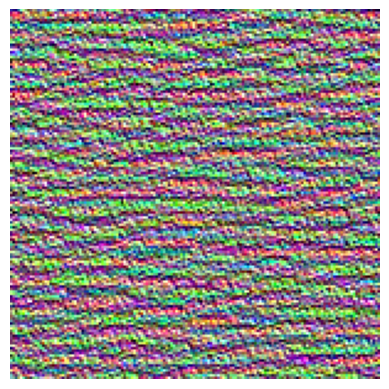

In [277]:
plt.axis("off")
filter_response_image = generate_filter_pattern(filter_index=2)
plt.imshow(deprocess_image(filter_response_image))  

In [278]:
# Generating a grid of all filter response input patterns in a layer
all_images = []
for filter_index in range(64):
    filter_response_image = generate_filter_pattern(filter_index)
    image =  deprocess_image(filter_response_image)
    all_images.append(image)
else:
    print("Processed all filters for their response input images.")

## Put all response images into a grid/canvas and save it as a picture
# Prepare a blank canvas to paste filter response images
margin = 5
n = 8  # 8 X 8 response images grid, total 64 
cropped_width = img_width - 25 * 2    # we cropped out the border for each response image
cropped_height = img_height - 25 * 2
width = n * cropped_width + (n - 1) * margin    # every row has n=8 cropped images
height = n * cropped_height + (n - 1) * margin  # every column has n=8 cropped images
stitched_filters = np.zeros((width, height, 3))

# Fill the picture with the saved filter response images
for i in range(n):
    for j in range(n):
        image = all_images[i * n + j]
        row_start = (cropped_width + margin) * i
        row_end = (cropped_width + margin) * i + cropped_width
        column_start = (cropped_height + margin) * j
        column_end = (cropped_width + margin) * j + cropped_height
        stitched_filters[
            row_start: row_end,
            column_start: column_end, :] = image

keras.utils.save_img(f"ch9_filters_for_layer_{layer_name}.png", stitched_filters)

Processed all filters for their response input images.


### 9.4.3 Visualizing heatmaps of class activation

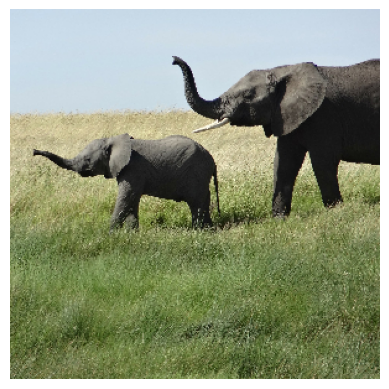

In [279]:
# Convert an input image to numpy array
img_path = keras.utils.get_file(
    fname="elephant.jpg",
    origin="https://img-datasets.s3.amazonaws.com/elephant.jpg"
)

def get_img_array(img_path, target_size):
    img = keras.utils.load_img(img_path, target_size=target_size)  # returns a PIL image of target_size
    array = keras.utils.img_to_array(img)     # returns a float32 NumPy array of shape (target_size, target_size, 3)
    array = np.expand_dims(array, axis=0)     # add a batch_size dimension
    return array

img_array = get_img_array(img_path, target_size=(299, 299))

# display image
import matplotlib.pyplot as plt

plt.clf()
plt.axis("off")
plt.imshow(img_array[0].astype("uint8"))
plt.show()

In [280]:
## Use Xception to predict the classification result
img_array = keras.applications.xception.preprocess_input(img_array)  # preprocess the image with exception, this does channel-wise normalization

model = keras.applications.xception.Xception(weights="imagenet")  # the top classifier is included
preds = model.predict(img_array)

print(preds.shape)
print(keras.applications.xception.decode_predictions(preds, top=3)[0])

np.argmax(preds[0])   # entry index corresponding to African_elephant

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
(1, 1000)
[('n02504458', 'African_elephant', 0.8699397), ('n01871265', 'tusker', 0.07695618), ('n02504013', 'Indian_elephant', 0.023541754)]


386

In [ ]:
for layer in model.layers:
    print(layer.name, layer.output.shape)

input_layer_26 (None, 299, 299, 3)
block1_conv1 (None, 149, 149, 32)
block1_conv1_bn (None, 149, 149, 32)
block1_conv1_act (None, 149, 149, 32)
block1_conv2 (None, 147, 147, 64)
block1_conv2_bn (None, 147, 147, 64)
block1_conv2_act (None, 147, 147, 64)
block2_sepconv1 (None, 147, 147, 128)
block2_sepconv1_bn (None, 147, 147, 128)
block2_sepconv2_act (None, 147, 147, 128)
block2_sepconv2 (None, 147, 147, 128)
block2_sepconv2_bn (None, 147, 147, 128)
conv2d_40 (None, 74, 74, 128)
block2_pool (None, 74, 74, 128)
batch_normalization_18 (None, 74, 74, 128)
add_33 (None, 74, 74, 128)
block3_sepconv1_act (None, 74, 74, 128)
block3_sepconv1 (None, 74, 74, 256)
block3_sepconv1_bn (None, 74, 74, 256)
block3_sepconv2_act (None, 74, 74, 256)
block3_sepconv2 (None, 74, 74, 256)
block3_sepconv2_bn (None, 74, 74, 256)
conv2d_41 (None, 37, 37, 256)
block3_pool (None, 37, 37, 256)
batch_normalization_19 (None, 37, 37, 256)
add_34 (None, 37, 37, 256)
block4_sepconv1_act (None, 37, 37, 256)
block4_sepcon

top_class_channel_probability: [0.86993957]
grads.shape: (1, 10, 10, 2048)
pooled_grads.shape: (2048,)
heatmap.shape: (10, 10)


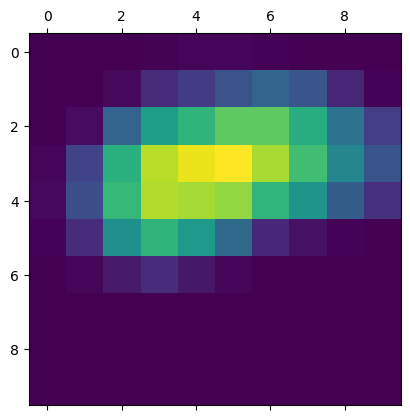

In [287]:
## Visualzie which parts of the image are the most African-elephant-like using Grad-CAM process

# set up a model that returns the last convolutional output
last_conv_layer_name = "block14_sepconv2_act"
classifier_layer_names = [
    "avg_pool",
    "predictions"
]
last_conv_layer = model.get_layer(last_conv_layer_name)
last_conv_layer_model = keras.Model(model.inputs, last_conv_layer.output)  # output shape (None, 10, 10, 2048)

# create a model that maps the activations of the last convolutional layer to the final class predictions
# reapply the classifier on top of the last convolutional output
classifier_input = keras.Input(shape=last_conv_layer.output.shape[1:])
x = classifier_input
for layer_name in classifier_layer_names:
    x = model.get_layer(layer_name)(x)
classifier_model = keras.Model(classifier_input, x)

# compute the gradient of the top predicted class for our input image with respect to the activations of the last convolution layer
import tensorflow as tf

with tf.GradientTape() as tape:
    # compute the activations of the last conv layer and make tape watch it
    last_conv_layer_output = last_conv_layer_model(img_array)
    tape.watch(last_conv_layer_output)
    # retrieve the activation channel corresponding to the top predicted class
    preds = classifier_model(last_conv_layer_output)  # preds.shape is [batch_size, num_classes]
    top_pred_index = tf.argmax(preds[0])
    top_class_channel_prob = preds[:, top_pred_index]
    print(f"top_class_channel_probability: {top_class_channel_prob}")

# the shape is the same as conv output since it is the gradient of scalar to matrix
# it quantifies the importance of each channel with regard to the top predicted class
grads = tape.gradient(top_class_channel_prob, last_conv_layer_output)  
print(f"grads.shape: {grads.shape}")

# gradient pooling across batch_size, height, weight; and channel-importance weighting
pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2)).numpy()  # result has shape of (2048,), the mean intensity of the gradient for all channels
print(f"pooled_grads.shape: {pooled_grads.shape}")
last_conv_layer_output = last_conv_layer_output.numpy()[0]    # shape (10, 10, 2048) since there is only one batch 
for i in range(pooled_grads.shape[-1]):
    last_conv_layer_output[:, :, i] *= pooled_grads[i]  # multiply the channel value with the channel-wise avg grads

heatmap = np.mean(last_conv_layer_output, axis=-1)  # average across the channels 2048, the resulting shape is (10, 10)
print(f"heatmap.shape: {heatmap.shape}")

# heatmap post-processing
heatmap = np.maximum(heatmap, 0)  # np.maximum compares two input arrays for element-wise maximum, this line essentially replace negative values with 0
heatmap /= np.max(heatmap)        # the heatmap is normalized to the range [0, 1].
plt.matshow(heatmap)

jet_heatmap.shape: (10, 10, 3)


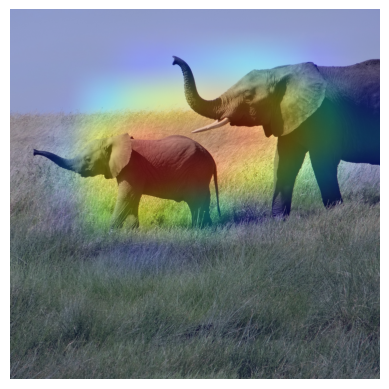

In [299]:
# Superimposing the heatmap on the original picture
import matplotlib

img = keras.utils.load_img(img_path)
img = keras.utils.img_to_array(img) # (1, 299, 299, 3)

heatmap = np.uint8(255 * heatmap)   # (10, 10); here we rescale the value to 0-255

# The "jet" colormap transitions from blue to green to yellow to red, 
# making it easier to distinguish between different values in the heatmap.
jet = matplotlib.colormaps["jet"]
# This maps each integer in the range 0 to 255 to a corresponding color in the "jet" colormap.
# The result is an array of shape (256, 4), where each row corresponds to an RGBA color.
jet_colors = jet(np.arange(256))[:, :3]  # generates 256 colors from the "jet" colormap and selects the first three columns (RGB values).
# maps each value in (10, 10) heatmatp to a (R, G, B) jet color, resulting jet_heatmap of shape (10, 10, 3)
jet_heatmap = jet_colors[heatmap]  
print(f"jet_heatmap.shape: {jet_heatmap.shape}")

# rescale the heat map size to match the original image
jet_heatmap = keras.utils.array_to_img(jet_heatmap)
jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))  # scale from (10, 10, 3) to (299, 299, 3)
jet_heatmap = keras.utils.img_to_array(jet_heatmap)

superimposed_img = jet_heatmap * 0.4 + img  # add heatmap at 40% opacity to the original image
superimposed_img = keras.utils.array_to_img(superimposed_img)

# save_path = "ch9_elephant_cam.jpg"
# superimposed_img.save(save_path)

# display superimposed image array
import matplotlib.pyplot as plt

plt.clf()
plt.axis("off")
plt.imshow(superimposed_img)
plt.show()

# CH10 Deep learning for timeseries

## 10.2 A temperature-forecasting example

### 10.2.1 Preparing the data

In [ ]:
# Create the directory if it doesn't exist
!mkdir -p ../datasets/jena_climate_2009_2016

# download the data
!wget -P ../datasets/jena_climate_2009_2016 https://s3.amazonaws.com/keras-datasets/jena_climate_2009_2016.csv.zip
!unzip ../datasets/jena_climate_2009_2016/jena_climate_2009_2016.csv.zip -d ../datasets/jena_climate_2009_2016

--2024-05-06 23:06:25--  https://s3.amazonaws.com/keras-datasets/jena_climate_2009_2016.csv.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.29.22, 52.217.117.144, 54.231.230.232, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.29.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13565642 (13M) [application/zip]
Saving to: ‘../datasets/jena_climate_2009_2016/jena_climate_2009_2016.csv.zip’

jena_climate_2009_2 100%[===================>]  12.94M  54.8MB/s    in 0.2s    

2024-05-06 23:06:26 (54.8 MB/s) - ‘../datasets/jena_climate_2009_2016/jena_climate_2009_2016.csv.zip’ saved [13565642/13565642]

Archive:  ../datasets/jena_climate_2009_2016/jena_climate_2009_2016.csv.zip
  inflating: ../datasets/jena_climate_2009_2016/jena_climate_2009_2016.csv  
  inflating: ../datasets/jena_climate_2009_2016/__MACOSX/._jena_climate_2009_2016.csv  


In [9]:
# inspect the data of the Jena weather dataset
import os

fname = os.path.join("../datasets/jena_climate_2009_2016/jena_climate_2009_2016.csv")

with open(fname) as f:
    data = f.read()

lines = data.split("\n")
header = lines[0].split(",")
lines = lines[1:]

print(f"total number of inputs: {len(lines)}")
print(f"header is:\n {header}")
print(f"first two input:\n {lines[0]} \n {lines[1]}")  # columns are separated by ','; measurment every 10 minutes

total number of inputs: 420451
header is:
 ['"Date Time"', '"p (mbar)"', '"T (degC)"', '"Tpot (K)"', '"Tdew (degC)"', '"rh (%)"', '"VPmax (mbar)"', '"VPact (mbar)"', '"VPdef (mbar)"', '"sh (g/kg)"', '"H2OC (mmol/mol)"', '"rho (g/m**3)"', '"wv (m/s)"', '"max. wv (m/s)"', '"wd (deg)"']
first two input:
 01.01.2009 00:10:00,996.52,-8.02,265.40,-8.90,93.30,3.33,3.11,0.22,1.94,3.12,1307.75,1.03,1.75,152.30 
 01.01.2009 00:20:00,996.57,-8.41,265.01,-9.28,93.40,3.23,3.02,0.21,1.89,3.03,1309.80,0.72,1.50,136.10


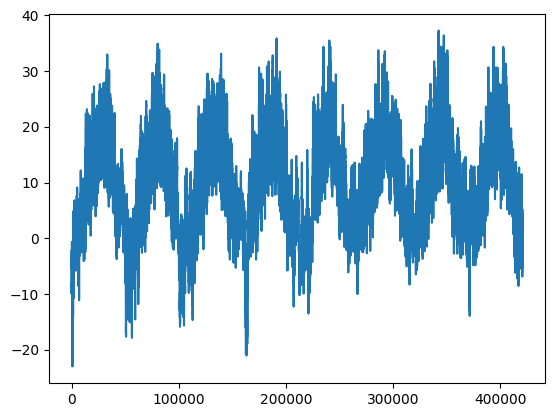

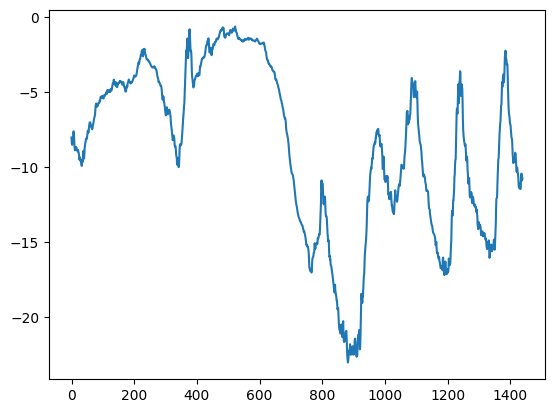

In [10]:
# convert data into numpy arrays
import numpy as np

temperature = np.zeros((len(lines),))
raw_data = np.zeros((len(lines), len(header) - 1))  # to store inputs, we will discard the "Date Time" column

for i, line in enumerate(lines):
    values = [float(x) for x in line.split(",")[1:]] # discard "Date time" column
    temperature[i] = values[1]
    raw_data[i, :] = values[:]   # this includes the temperature column

# plot temperature series
from matplotlib import pyplot as plt
plt.plot(range(len(temperature)), temperature)  # all data
plt.show()
plt.clf()   # clears the current figure, removing all existing plots and other content, but does not create a new figure.
plt.plot(range(1440), temperature[:1440])   # first 10 day data, one datapoint is 10 minutes, so one hour is 6 datapoints, one day is 24X6=144
plt.show()

In [12]:
# Split data into train/validation/test from raw_data and temperature

from tensorflow import keras

print(f"raw_data.shape: {raw_data.shape}")        # (420451, 14)
print(f"temperature.shape: {temperature.shape}")  # (420451,)
data_len = len(raw_data)
num_train_samples = int(0.5 * data_len)
num_val_samples = int(0.25 * data_len)
num_test_samples = data_len - num_train_samples - num_val_samples

# normalize all data using training data mean and std
mean = raw_data[:num_train_samples].mean(axis=0)
raw_data -= mean
std = raw_data[:num_train_samples].std(axis=0)
raw_data /= std

# instantiating datasets for training, validation, testing
sampling_rate = 6      # one datapoing per hour, we will only keep one data point out of 6 data points in one hour
sequence_length = 120  # observations will go back 5 days (120 hours)
delay = sampling_rate * (sequence_length + 24 - 1)  # target for a sequence will be the temperature 24 hrs after the end of the sequence
batch_size = 256

train_dataset = keras.utils.timeseries_dataset_from_array(
    raw_data[:-delay],
    targets = temperature[delay:],
    sampling_rate = sampling_rate,
    sequence_length = sequence_length,
    shuffle=True,
    batch_size = batch_size,
    start_index=0,
    end_index=num_train_samples
)

val_dataset = keras.utils.timeseries_dataset_from_array(
    raw_data[:-delay],
    targets = temperature[delay:],
    sampling_rate = sampling_rate,
    sequence_length = sequence_length,
    shuffle=True,
    batch_size = batch_size,
    start_index=num_train_samples,
    end_index=num_train_samples + num_val_samples
)

test_dataset = keras.utils.timeseries_dataset_from_array(
    raw_data[:-delay],
    targets = temperature[delay:],
    sampling_rate = sampling_rate,
    sequence_length = sequence_length,
    shuffle=True,
    batch_size = batch_size,
    start_index=num_train_samples + num_val_samples
)

raw_data.shape: (420451, 14)
temperature.shape: (420451,)


In [14]:
# inspecting the output of one of our datasets
for samples, targets in train_dataset:
    print("samples shape:", samples.shape)
    print("targets shape:", targets.shape)
    break

samples shape: (256, 120, 14)
targets shape: (256,)


### 10.2.2 A common-sense, non-machine learning baseline

In [15]:
# This code gave lower MAE (about 2) with python 3.10.12 and tensorflow 2.15.0
# Sometimes, it may give larger MAE (about 10) with python 3.10.14 and tensorflow 2.16.1
def evaluate_naive_method(dataset):
    total_abs_err = 0.
    samples_seen = 0
    for samples, targets in dataset:
        preds = samples[:, -1, 1] * std[1] + mean[1]
        total_abs_err += np.sum(np.abs(preds - targets))
        samples_seen += samples.shape[0]
    print(f"samples_seen: {samples_seen}")
    return total_abs_err / samples_seen

validation_dataset_mae = evaluate_naive_method(val_dataset)
test_dataset_mae = evaluate_naive_method(test_dataset)

print(f"Validation MAE: {validation_dataset_mae:.2f}")
print(f"Test MAE: {test_dataset_mae:.2f}")

samples_seen: 104398
samples_seen: 103542
Validation MAE: 2.44
Test MAE: 2.62


### 10.2.3 A basic machine learning model

In [14]:
# Train and evaluate a densely connected model
from tensorflow import keras
from tensorflow.keras import layers

num_features = raw_data.shape[-1]        # raw_date shape is (num_samples, num_features)
shape = (sequence_length, num_features)  # (120, 14)
print(f"Input shape: {shape}")

inputs = keras.Input(shape=(sequence_length, num_features))
x = layers.Flatten()(inputs)
x = layers.Dense(16, activation="relu")(x)
outputs = layers.Dense(1)(x)
model = keras.Model(inputs, outputs)

model.summary()

Input shape: (120, 14)


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 120, 14)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 1680)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 16)             │        26,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,913 (105.13 KB)

 Trainable params: 26,913 (105.13 KB)

 Non-trainable params: 0 (0.00 B)

In [24]:
# This code runs ok with python 3.10.12 and tensorflow 2.15.0
# Sometimes it gave error when running with python 3.10.14 and tensorflow 2.16.1
callbacks = [
    keras.callbacks.ModelCheckpoint("ch10_jena_dense.keras", save_best_only=True)
]

model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])

history = model.fit(train_dataset,
                   epochs=10,
                   validation_data=val_dataset,
                   callbacks=callbacks
                   )

# plot mae
plot_training_history(history, "mae", "val_mae")

Epoch 1/10
819/819 [==============================] - 10s 11ms/step - loss: 68.2172 - mae: 6.7739 - val_loss: 22.2413 - val_mae: 3.8690
Epoch 2/10
819/819 [==============================] - 9s 11ms/step - loss: 36.4464 - mae: 4.3372 - val_loss: 12.9941 - val_mae: 2.8236
Epoch 3/10
819/819 [==============================] - 10s 12ms/step - loss: 38.0301 - mae: 4.2872 - val_loss: 12.4138 - val_mae: 2.7802
Epoch 4/10
819/819 [==============================] - 10s 12ms/step - loss: 34.8551 - mae: 4.2416 - val_loss: 10.2756 - val_mae: 2.5087
Epoch 5/10
819/819 [==============================] - 10s 12ms/step - loss: 32.7274 - mae: 4.2053 - val_loss: 26.1303 - val_mae: 4.1438
Epoch 6/10
819/819 [==============================] - 10s 12ms/step - loss: 32.7774 - mae: 4.4132 - val_loss: 37.5347 - val_mae: 5.0100
Epoch 7/10
819/819 [==============================] - 9s 11ms/step - loss: 33.0739 - mae: 4.4837 - val_loss: 20.3273 - val_mae: 3.6346
Epoch 8/10
819/819 [==============================

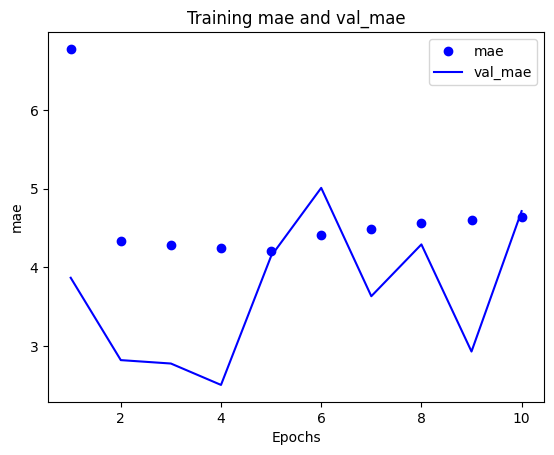

In [25]:
plot_training_history(history, "mae", "val_mae")

In [26]:
model = keras.models.load_model("ch10_jena_dense.keras")
print(f"Test MAE: {model.evaluate(test_dataset)[1]:.2f}")

405/405 [==============================] - 3s 7ms/step - loss: 11.5356 - mae: 2.6936
Test MAE: 2.69


### 10.2.4 Let's try a 1D convolutional model

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 120, 14)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_3 (Conv1D)               │ (None, 97, 64)         │        21,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_2 (MaxPooling1D)  │ (None, 48, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_4 (Conv1D)               │ (None, 37, 32)         │        24,608 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_3 (MaxPooling1D)  │ (None, 18, 32)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_5 (Conv1D)               │ (None, 13, 8)          │         1,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_1      │ (None, 8)              │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │             9 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 47,729 (186.44 KB)

 Trainable params: 47,729 (186.44 KB)

 Non-trainable params: 0 (0.00 B)

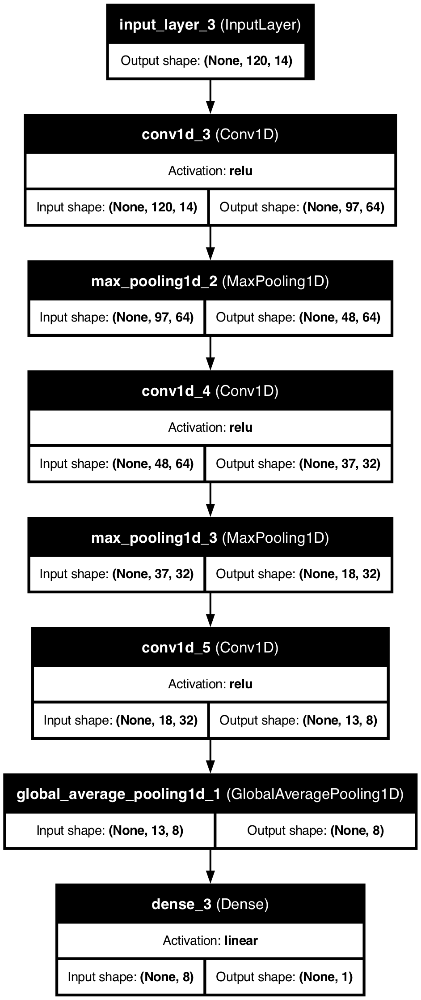

In [16]:
inputs = keras.Input(shape=(sequence_length, raw_data.shape[-1]))
x = layers.Conv1D(64, 24, activation="relu")(inputs)     # initial window length of 24, so we look at 24 hours of data at a time
x = layers.MaxPooling1D(2)(x)
x = layers.Conv1D(32, 12, activation="relu")(x)
x = layers.MaxPooling1D(2)(x)
x = layers.Conv1D(8, 6, activation="relu")(x)
# If the input shape is (batch_size, steps, features), 
# GlobalAveragePooling1D will compute the average across the time steps, resulting in (batch_size, features).
x = layers.GlobalAveragePooling1D()(x)
# the Dense layer expects a 2D input of shape (batch_size, features)
outputs = layers.Dense(1)(x)

model = keras.Model(inputs, outputs)

model.summary()

keras.utils.plot_model(model, "ch10_jena_conv.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

In [17]:
# train the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch10_jena_conv.keras", save_best_only=True)
]

model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])

history = model.fit(train_dataset,
                    epochs=10,
                    validation_data=val_dataset,
                    callbacks=callbacks)

# plot mae
plot_training_history(history, "mae", "val_mae")

Epoch 1/10


2024-06-29 08:34:04.845659: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


819/819 ━━━━━━━━━━━━━━━━━━━━ 14s 16ms/step - loss: 24.4333 - mae: 3.8326 - val_loss: 15.9460 - val_mae: 3.1749
Epoch 2/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 13s 16ms/step - loss: 11.7757 - mae: 2.6943 - val_loss: 17.7717 - val_mae: 3.3011
Epoch 3/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 13s 16ms/step - loss: 8.9331 - mae: 2.3360 - val_loss: 17.7452 - val_mae: 3.2654
Epoch 4/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 13s 16ms/step - loss: 7.3624 - mae: 2.1243 - val_loss: 16.0107 - val_mae: 3.1406
Epoch 5/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 13s 16ms/step - loss: 6.3806 - mae: 1.9777 - val_loss: 15.8892 - val_mae: 3.1404
Epoch 6/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 13s 16ms/step - loss: 5.6722 - mae: 1.8653 - val_loss: 16.4997 - val_mae: 3.1848
Epoch 7/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 14s 17ms/step - loss: 5.1946 - mae: 1.7874 - val_loss: 19.4575 - val_mae: 3.4686
Epoch 8/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 13s 16ms/step - loss: 4.8079 - mae: 1.7159 - val_loss: 18.0864 - val_mae: 3.3379
Epoch 9/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 1

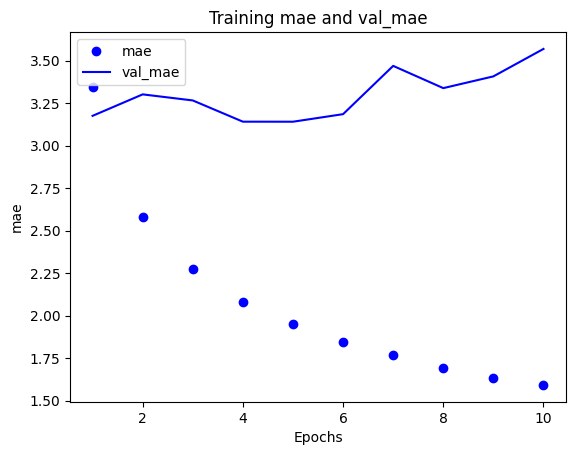

405/405 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - loss: 18.1941 - mae: 3.3939
Test MAE: 3.39


In [18]:
# evaluate the model performance with test data
model = keras.models.load_model("ch10_jena_conv.keras")
print(f"Test MAE: {model.evaluate(test_dataset)[1]:.2f}")

### 10.2.5 A first reurrent baseline using LSTM

In [21]:
# A simple LSTM-based model
from tensorflow import keras
from tensorflow.keras import layers

inputs = keras.Input(shape=(sequence_length, raw_data.shape[-1]))
x = layers.LSTM(16)(inputs)
outputs = layers.Dense(1)(x)
model = keras.Model(inputs, outputs)

model.summary()

Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 120, 14)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 16)             │         1,984 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,001 (7.82 KB)

 Trainable params: 2,001 (7.82 KB)

 Non-trainable params: 0 (0.00 B)

In [23]:
# train the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch10_jena_lstm.keras",
                                    save_best_only=True)
]

model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])

history = model.fit(train_dataset,
                    epochs=10,
                    validation_data=val_dataset,
                    callbacks=callbacks)

# plot mae
plot_training_history(history, "mae", "val_mae")

Epoch 1/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 17s 20ms/step - loss: 7.9087 - mae: 2.1785 - val_loss: 10.7847 - val_mae: 2.5465
Epoch 2/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 16s 20ms/step - loss: 7.7875 - mae: 2.1624 - val_loss: 10.7698 - val_mae: 2.5339
Epoch 3/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 15s 19ms/step - loss: 7.7775 - mae: 2.1621 - val_loss: 11.0128 - val_mae: 2.5662
Epoch 4/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - loss: 7.6876 - mae: 2.1498 - val_loss: 11.2365 - val_mae: 2.5940
Epoch 5/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - loss: 7.6034 - mae: 2.1377 - val_loss: 11.3443 - val_mae: 2.6312
Epoch 6/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - loss: 7.6283 - mae: 2.1396 - val_loss: 11.1896 - val_mae: 2.5839
Epoch 7/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - loss: 7.5116 - mae: 2.1259 - val_loss: 10.9749 - val_mae: 2.5660
Epoch 8/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 16s 19ms/step - loss: 7.5385 - mae: 2.1270 - val_loss: 11.3878 - val_mae: 2.6230
Epoch 9/10
819/819 ━━━━━━━━━━━━━

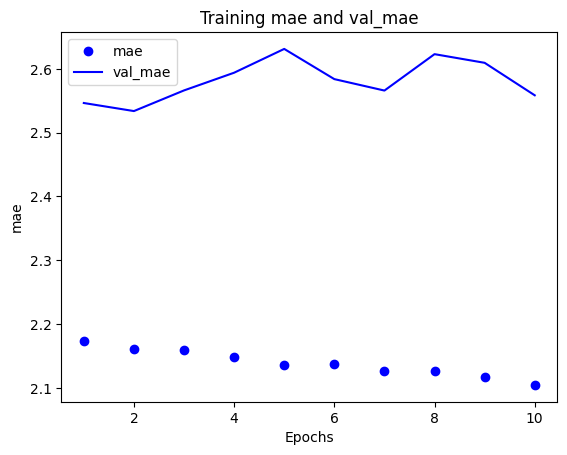

405/405 ━━━━━━━━━━━━━━━━━━━━ 4s 8ms/step - loss: 11.9139 - mae: 2.6922
Test MAE: 2.70


In [24]:
# evaluate the model performance with test data
model = keras.models.load_model("ch10_jena_lstm.keras")
print(f"Test MAE: {model.evaluate(test_dataset)[1]:.2f}")

In [27]:
# SimpleRNN in keras
num_features = 14
timesteps = 120
# we can use None for timesteps, then the model will be able to process sequences of arbitrary length
# but using this, model.summary() will not work with None in shape
inputs = keras.Input(shape=(timesteps, num_features))  
outputs1 = layers.SimpleRNN(16, return_sequences=False)(inputs)  # return only last timestep output 
outputs2 = layers.SimpleRNN(16, return_sequences=True)(inputs)   # return full successive outputs of each timestep

print(outputs1.shape)
print(outputs2.shape)

(None, 16)
(None, 120, 16)


## 10.4 Advanced use of recurrent neural networks

### 10.4.1 Using recurrent dropout to fight overfitting

In [14]:
# Training and evaluating a dropout-regularized LSTM
from tensorflow.keras import layers

inputs = keras.Input(shape=(sequence_length, raw_data.shape[-1]))
x = layers.LSTM(32, recurrent_dropout=0.25)(inputs)  # 25% dropout rate for the 32 units
x = layers.Dropout(0.5)(x)   # for the below dense layer
outputs = layers.Dense(1)(x)
model = keras.Model(inputs, outputs)

model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 120, 14)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 32)             │         6,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,049 (23.63 KB)

 Trainable params: 6,049 (23.63 KB)

 Non-trainable params: 0 (0.00 B)

In [32]:
callbacks = [
    keras.callbacks.ModelCheckpoint("ch10_jena_lstm_dropout.keras",
                                   save_best_only=True)
]

model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])

with tf.device('/cpu:0'):   # Use cpu instead of using gpu, it is 193s of cpu vs 1.5 hour of gpu
    history = model.fit(train_dataset,
                       epochs=50,
                       validation_data=val_dataset,
                       callbacks=callbacks)
    
# plot training mae and validation mae
plot_training_history(history, "mae", "val_mae")

Epoch 1/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 66s 80ms/step - loss: 48.9831 - mae: 5.1710 - val_loss: 9.5347 - val_mae: 2.4011
Epoch 2/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 65s 80ms/step - loss: 15.3809 - mae: 3.0520 - val_loss: 9.1311 - val_mae: 2.3568
Epoch 3/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 65s 79ms/step - loss: 14.6215 - mae: 2.9704 - val_loss: 9.0740 - val_mae: 2.3465
Epoch 4/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 65s 79ms/step - loss: 14.1255 - mae: 2.9198 - val_loss: 9.1013 - val_mae: 2.3471
Epoch 5/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 65s 80ms/step - loss: 13.6647 - mae: 2.8695 - val_loss: 8.9101 - val_mae: 2.3199
Epoch 6/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 70s 85ms/step - loss: 13.4578 - mae: 2.8465 - val_loss: 9.0072 - val_mae: 2.3327
Epoch 7/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 74s 90ms/step - loss: 13.1201 - mae: 2.8182 - val_loss: 9.1053 - val_mae: 2.3359
Epoch 8/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 75s 91ms/step - loss: 12.9465 - mae: 2.7977 - val_loss: 8.9733 - val_mae: 2.3233
Epoch 9/50
819/819 ━━━━━━━━━━━━━

In [9]:
# evaluate the model performance with test data
model = keras.models.load_model("ch10_jena_lstm_dropout.keras")
print(f"Test MAE: {model.evaluate(test_dataset)[1]:.2f}")

NameError: name 'history' is not defined

### 10.4.2 Stacking recurrent layers using GRU

In [18]:
from tensorflow import keras
from tensorflow.keras import layers

# training and evaluating a dropout-regularized, stacked GRU model
inputs = keras.Input(shape=(sequence_length, raw_data.shape[-1]))
x = layers.GRU(32, recurrent_dropout=0.5, return_sequences=True)(inputs)
x = layers.GRU(32, recurrent_dropout=0.5)(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1)(x)

model = keras.Model(inputs, outputs)

model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 120, 14)]         0         
                                                                 
 gru_2 (GRU)                 (None, 120, 32)           4608      
                                                                 
 gru_3 (GRU)                 (None, 32)                6336      
                                                                 
 dropout_1 (Dropout)         (None, 32)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 33        
                                                                 
Total params: 10977 (42.88 KB)
Trainable params: 10977 (42.88 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [19]:
# sometimes the below could not successfully train with py3.10.14 + tf 2.16.1, the loss is nan
# py3.10.12 + tf 2.15.0 works without problem
callbacks = [
    keras.callbacks.ModelCheckpoint("ch10_jena_stacked_gru.keras",
                                   save_best_only=True)
]

model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])

with tf.device('/cpu:0'):
    history = model.fit(train_dataset,
                        epochs=50,
                        validation_data=val_dataset,
                        callbacks=callbacks)

# plot training mae and validation mae
plot_training_history(history, "mae", "val_mae")

Epoch 1/50
819/819 [==============================] - 170s 206ms/step - loss: 25.2113 - mae: 3.7116 - val_loss: 9.3690 - val_mae: 2.3597
Epoch 2/50
819/819 [==============================] - 170s 207ms/step - loss: 14.0654 - mae: 2.9080 - val_loss: 8.9453 - val_mae: 2.3197
Epoch 3/50
819/819 [==============================] - 170s 207ms/step - loss: 13.2510 - mae: 2.8185 - val_loss: 9.1043 - val_mae: 2.3306
Epoch 4/50
819/819 [==============================] - 182s 222ms/step - loss: 12.6978 - mae: 2.7641 - val_loss: 8.7423 - val_mae: 2.2905
Epoch 5/50
819/819 [==============================] - 196s 240ms/step - loss: 12.1890 - mae: 2.7110 - val_loss: 9.2689 - val_mae: 2.3591
Epoch 6/50
819/819 [==============================] - 195s 238ms/step - loss: 11.7581 - mae: 2.6632 - val_loss: 9.3549 - val_mae: 2.3781
Epoch 7/50
819/819 [==============================] - 186s 227ms/step - loss: 11.3546 - mae: 2.6148 - val_loss: 8.8676 - val_mae: 2.3121
Epoch 8/50
819/819 [=====================

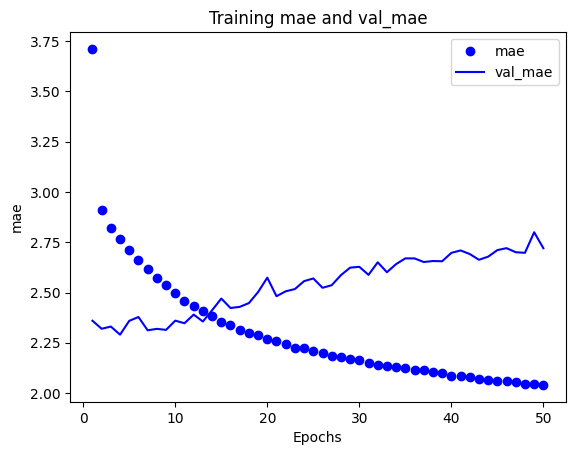

405/405 [==============================] - 371s 913ms/step - loss: 9.6919 - mae: 2.4466
Test MAE: 2.45


In [21]:
# evaluate the model performance with test data
model = keras.models.load_model("ch10_jena_stacked_gru.keras")
print(f"Test MAE: {model.evaluate(test_dataset)[1]:.2f}")

### 10.4.3 Using bidirectional RNNs

In [39]:
# Birdirectional RNN us ususally used for natural language processing, not this chronological estimation
inputs = keras.Input(shape=(sequence_length, raw_data.shape[-1]))
x = layers.Bidirectional(layers.LSTM(16))(inputs)
outputs = layers.Dense(1)(x)
model = keras.Model(inputs, outputs)

callbacks = [
    keras.callbacks.ModelCheckpoint("ch10_jena_binirectional_rnn.keras",
                                   save_best_only=True)
]

model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])

with tf.device('/cpu:0'):
    history = model.fit(train_dataset,
                        epochs=10,
                        validation_data=val_dataset,
                        callbacks=callbacks)

# plot training mae and validation mae
plot_training_history(history, "mae", "val_mae")

Epoch 1/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 24s 27ms/step - loss: 58.6906 - mae: 5.6634 - val_loss: 11.6548 - val_mae: 2.6440
Epoch 2/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 22s 27ms/step - loss: 10.1986 - mae: 2.5015 - val_loss: 10.2304 - val_mae: 2.4614
Epoch 3/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 21s 26ms/step - loss: 8.8835 - mae: 2.3319 - val_loss: 10.6566 - val_mae: 2.4999
Epoch 4/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 22s 26ms/step - loss: 8.0955 - mae: 2.2217 - val_loss: 10.4094 - val_mae: 2.4577
Epoch 5/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 21s 26ms/step - loss: 7.6122 - mae: 2.1563 - val_loss: 11.2307 - val_mae: 2.5395
Epoch 6/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 21s 26ms/step - loss: 7.2146 - mae: 2.0977 - val_loss: 11.0764 - val_mae: 2.5245
Epoch 7/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 22s 27ms/step - loss: 6.8681 - mae: 2.0463 - val_loss: 10.9162 - val_mae: 2.5079
Epoch 8/10
819/819 ━━━━━━━━━━━━━━━━━━━━ 22s 26ms/step - loss: 6.6184 - mae: 2.0069 - val_loss: 10.7346 - val_mae: 2.4897
Epoch 9/10
819/819 ━━━━━━━━━━━

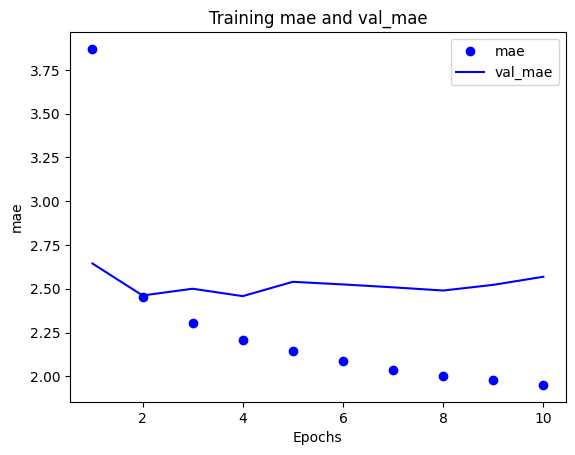

405/405 ━━━━━━━━━━━━━━━━━━━━ 41s 99ms/step - loss: 10.7062 - mae: 2.5737
Test MAE: 2.59


In [40]:
# evaluate the model performance with test data
model = keras.models.load_model("ch10_jena_binirectional_rnn.keras")
print(f"Test MAE: {model.evaluate(test_dataset)[1]:.2f}")

# CH11 Deep learning for text

## 11.3 Two approaches for representing groups of words: sets and sequences

### 11.3.1 Preparing the IMDB moview reviews data

In [10]:
# Create the directory if it doesn't exist
!mkdir -p ../datasets/imdb

# prepare data
!curl -o ../datasets/imdb/aclImdb_v1.tar.gz https://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz
!tar -xf ../datasets/imdb/aclImdb_v1.tar.gz -C ../datasets/imdb
!rm -r ../datasets/imdb/aclImdb/train/unsup

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 80.2M  100 80.2M    0     0  34.9M      0  0:00:02  0:00:02 --:--:-- 34.9M


In [173]:
# inspect data
!cat ../datasets/imdb/aclImdb/train/pos/4077_10.txt

I first saw this back in the early 90s on UK TV, i did like it then but i missed the chance to tape it, many years passed but the film always stuck with me and i lost hope of seeing it TV again, the main thing that stuck with me was the end, the hole castle part really touched me, its easy to watch, has a great story, great music, the list goes on and on, its OK me saying how good it is but everyone will take there own best bits away with them once they have seen it, yes the animation is top notch and beautiful to watch, it does show its age in a very few parts but that has now become part of it beauty, i am so glad it has came out on DVD as it is one of my top 10 films of all time. Buy it or rent it just see it, best viewing is at night alone with drink and food in reach so you don't have to stop the film.<br /><br />Enjoy

In [41]:
# Set aside 20% training text file as validation data set
import os, pathlib, shutil, random

base_dir = pathlib.Path("../datasets/imdb/aclImdb")
val_dir = base_dir / "val"
train_dir = base_dir / "train"

for category in ("neg", "pos"):
    category_dir = val_dir / category
    if category_dir.exists():    # if already exists, then we previously already moved files from train to val
        break
    os.makedirs(val_dir / category)
    files = os.listdir(train_dir / category)
    random.Random(1337).shuffle(files)   # shuffle using a seed to make repeatability between different runs
    num_val_samples = int(0.2 * len(files))
    val_files = files[-num_val_samples:]
    for fname in val_files:
        shutil.move(train_dir/category/fname, val_dir/category/fname)

In [31]:
# Create three Dataset objects for training, validation and testing from text files
from tensorflow import keras
batch_size = 32

train_ds = keras.utils.text_dataset_from_directory(   # targets are encoded as int32 values of either 0 or 1
    "../datasets/imdb/aclImdb/train", batch_size=batch_size
)
val_ds = keras.utils.text_dataset_from_directory(
    "../datasets/imdb/aclImdb/val", batch_size=batch_size
)
test_ds = keras.utils.text_dataset_from_directory(
    "../datasets/imdb/aclImdb/test", batch_size=batch_size
)

Found 20000 files belonging to 2 classes.
Found 5000 files belonging to 2 classes.
Found 25000 files belonging to 2 classes.


In [45]:
# display the shapes and dtypes of the first batch
for inputs, targets in train_ds:
    print("inputs.shape:", inputs.shape)
    print("inputs.dtype:", inputs.dtype)
    print("targets.shape:", targets.shape)
    print("targets.dtype:", targets.dtype)
    print("inputs[0]:", inputs[0])
    print("targets[0]:", targets[0])   # target value 0 is associated with negative type
    break

inputs.shape: (32,)
inputs.dtype: <dtype: 'string'>
targets.shape: (32,)
targets.dtype: <dtype: 'int32'>
inputs[0]: tf.Tensor(b'This norwegian movie is so crap, the actors can not act cause they seems to be reading from a book and the story is so (wannabe) hollywood..the only actor who did a ok job was Haavard Lilleheie..3/10 If you want a really good norwegian movie watch Buddy, great actors and a feelgood story 9/10', shape=(), dtype=string)
targets[0]: tf.Tensor(0, shape=(), dtype=int32)


### 11.3.2 Processing words as a set: the bag-of-words approach and Dense model

In [52]:
# Resuable model-building utility function
# this same model will be used for different bag-of-words encoding approaches
from tensorflow import keras
from tensorflow.keras import layers

def get_model(max_tokens=20000, hidden_dim=16):
    inputs = keras.Input(shape=(max_tokens,))
    x = layers.Dense(hidden_dim, activation="relu")(inputs)
    x = layers.Dropout(0.5)(x)
    outputs = layers.Dense(1, activation="sigmoid")(x)
    model = keras.Model(inputs, outputs)
    model.compile(optimizer="rmsprop",
                 loss="binary_crossentropy",
                 metrics=["accuracy"])
    return model

model = get_model()
model.summary()

Model: "functional_23"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_14 (InputLayer)     │ (None, 20000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 16)             │       320,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 320,033 (1.22 MB)

 Trainable params: 320,033 (1.22 MB)

 Non-trainable params: 0 (0.00 B)

#### 11.3.2.1 one-gram encoding

In [32]:
# Preprocessing our dataset with a TextVectorization layer
from tensorflow.keras.layers import TextVectorization

text_vectorization = TextVectorization(
    max_tokens=20000,
    output_mode="multi_hot",   # each input will be convertd to a fixed length vector of value 0 or 1; 1 means the corresponding word is present in the input
)

text_only_train_ds = train_ds.map(lambda x, y : x)   # input only, removing target
text_vectorization.adapt(text_only_train_ds)         # build the vocubulary

binary_1gram_train_ds = train_ds.map(
    lambda x, y: (text_vectorization(x), y),    # single input will be vector of shape (20000,)
    num_parallel_calls=4    # parallelize the map() call across multiple cpu cores
)
binary_1gram_val_ds = val_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)
binary_1gram_test_ds = test_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)

# inspect the output of our binary unigram dataset
for inputs, targets in binary_1gram_train_ds:
    print("inputs.shape:", inputs.shape)
    print("inputs.dtype:", inputs.dtype)
    print("targets.shape:", targets.shape)
    print("targets.dtype:", targets.dtype)
    print("inputs[0]:", inputs[0])
    print("targets[0]:", targets[0])
    break

inputs.shape: (32, 20000)
inputs.dtype: <dtype: 'int64'>
targets.shape: (32,)
targets.dtype: <dtype: 'int32'>
inputs[0]: tf.Tensor([1 1 0 ... 0 0 0], shape=(20000,), dtype=int64)
targets[0]: tf.Tensor(1, shape=(), dtype=int32)


2024-07-03 22:22:39.873339: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


In [48]:
# train the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_binary_1gram.keras",
                                   save_best_only=True)
]

history = model.fit(binary_1gram_train_ds.cache(),   # cache will store data i memory during first epoch, this only works for small dataset which fit in memory
         validation_data=binary_1gram_val_ds.cache(),
         epochs=10,
         callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

Epoch 1/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - accuracy: 0.7687 - loss: 0.4846 - val_accuracy: 0.8918 - val_loss: 0.2718
Epoch 2/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.8957 - loss: 0.2730 - val_accuracy: 0.8952 - val_loss: 0.2740
Epoch 3/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9129 - loss: 0.2387 - val_accuracy: 0.8920 - val_loss: 0.2889
Epoch 4/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9237 - loss: 0.2239 - val_accuracy: 0.8920 - val_loss: 0.2963
Epoch 5/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9269 - loss: 0.2169 - val_accuracy: 0.8990 - val_loss: 0.3036
Epoch 6/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9302 - loss: 0.2089 - val_accuracy: 0.9006 - val_loss: 0.3102
Epoch 7/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9374 - loss: 0.1961 - val_accuracy: 0.8970 - val_loss: 0.3249
Epoch 8/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9385 - loss: 0.1993 - val_accuracy: 0.

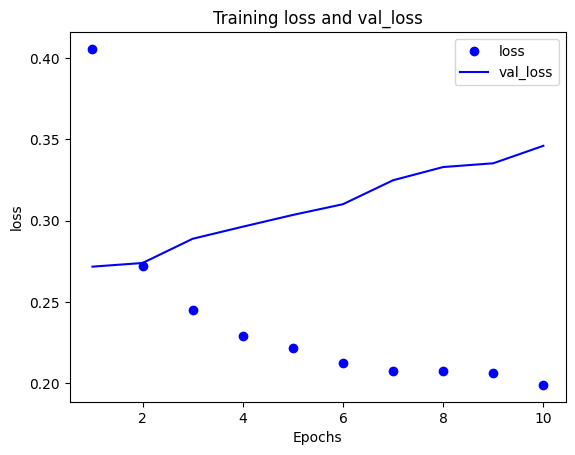

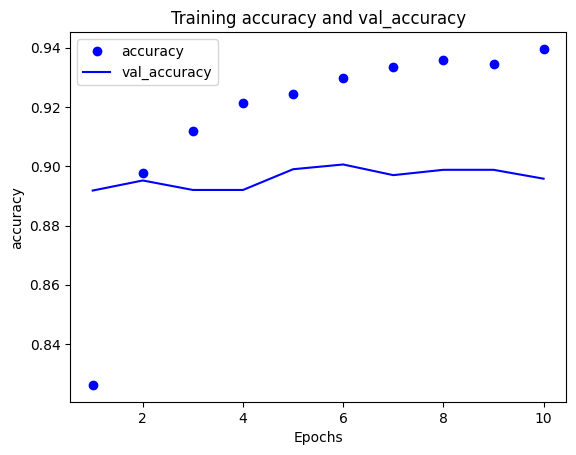

782/782 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step - accuracy: 0.8804 - loss: 0.2967
Test acc: 0.880


In [51]:
# evaluate the model performance with test data
model = keras.models.load_model("ch11_binary_1gram.keras")
print(f"Test acc: {model.evaluate(binary_1gram_test_ds)[1]:.3f}")

#### 11.3.3.2 two-gram encoding

2024-06-30 22:26:30.670064: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 1/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 5s 7ms/step - accuracy: 0.7886 - loss: 0.4598 - val_accuracy: 0.9038 - val_loss: 0.2527
Epoch 2/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9162 - loss: 0.2471 - val_accuracy: 0.9080 - val_loss: 0.2519
Epoch 3/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9305 - loss: 0.2016 - val_accuracy: 0.9072 - val_loss: 0.2685
Epoch 4/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9422 - loss: 0.1874 - val_accuracy: 0.9050 - val_loss: 0.2848
Epoch 5/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9482 - loss: 0.1680 - val_accuracy: 0.9016 - val_loss: 0.3004
Epoch 6/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9533 - loss: 0.1715 - val_accuracy: 0.9046 - val_loss: 0.3132
Epoch 7/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9539 - loss: 0.1589 - val_accuracy: 0.9016 - val_loss: 0.3238
Epoch 8/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9562 - loss: 0.1616 - val_accuracy: 0.

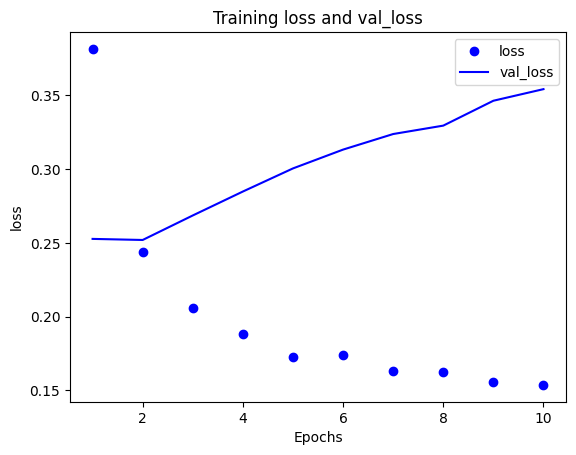

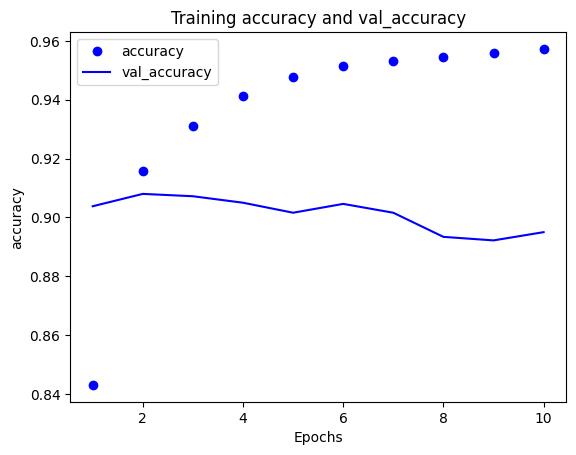

In [53]:
# Bigrams with binary encoding
from tensorflow.keras.layers import TextVectorization

text_vectorization = TextVectorization(
    ngrams=2,     # without this, it defaults to one-gram encoding
    max_tokens=20000,
    output_mode="multi_hot",
)

text_only_train_ds = train_ds.map(lambda x, y : x)
text_vectorization.adapt(text_only_train_ds)

binary_2gram_train_ds = train_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    # parallelize the map() call across multiple cpu cores
)
binary_2gram_val_ds = val_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)
binary_2gram_test_ds = test_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)

model = get_model()

# trian the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_binary_2gram.keras",
                                   save_best_only=True)
]

history = model.fit(binary_2gram_train_ds.cache(),  # cache will store data in memory during first epoch, this only works for small dataset which fits in memory
                     validation_data=binary_2gram_val_ds.cache(),
                     epochs=10,
                     callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

# test accuracy
model = keras.models.load_model("ch11_binary_2gram.keras")
print(f"Test acc: {model.evaluate(binary_2gram_test_ds)[1]:.3f}")

#### 11.3.3.3 two-gram with TF-IDF encoding

In [37]:
# Bigrams with TF-IDF encoding
text_vectorizatio = TextVectorization(
    ngrams=2,
    max_tokens=20000,
    output_mode="tf_idf"     # previous approaches are using "multi-hot"
)

text_only_train_ds = train_ds.map(lambda x, y : x)
text_vectorization.adapt(text_only_train_ds)

binary_2gram_train_ds = train_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    # parallelize the map() call across multiple cpu cores
)
binary_2gram_val_ds = val_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)
binary_2gram_test_ds = test_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)

# inspect the output of our binary unigram dataset
for inputs, targets in binary_2gram_train_ds:
    print("inputs.shape:", inputs.shape)
    print("inputs.dtype:", inputs.dtype)
    print("targets.shape:", targets.shape)
    print("targets.dtype:", targets.dtype)
    print("inputs[0]:", inputs[0])  # still integer, the real tf-idf values are calculated internally in subsequent layers, not directly in the input
    print("targets[0]:", targets[0])
    break

inputs.shape: (32, 20000)
inputs.dtype: <dtype: 'int64'>
targets.shape: (32,)
targets.dtype: <dtype: 'int32'>
inputs[0]: tf.Tensor([1 1 1 ... 0 0 0], shape=(20000,), dtype=int64)
targets[0]: tf.Tensor(0, shape=(), dtype=int32)


2024-07-03 22:36:25.345645: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


2024-06-30 22:28:38.679769: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Epoch 1/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.7833 - loss: 0.4652 - val_accuracy: 0.8982 - val_loss: 0.2605
Epoch 2/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9083 - loss: 0.2534 - val_accuracy: 0.9058 - val_loss: 0.2513
Epoch 3/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9254 - loss: 0.2079 - val_accuracy: 0.9064 - val_loss: 0.2594
Epoch 4/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9388 - loss: 0.1986 - val_accuracy: 0.9054 - val_loss: 0.2727
Epoch 5/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9436 - loss: 0.1796 - val_accuracy: 0.9044 - val_loss: 0.2849
Epoch 6/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9467 - loss: 0.1806 - val_accuracy: 0.9008 - val_loss: 0.2985
Epoch 7/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9502 - loss: 0.1675 - val_accuracy: 0.9016 - val_loss: 0.3121
Epoch 8/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step - accuracy: 0.9520 - loss: 0.1727 - val_accuracy: 0.

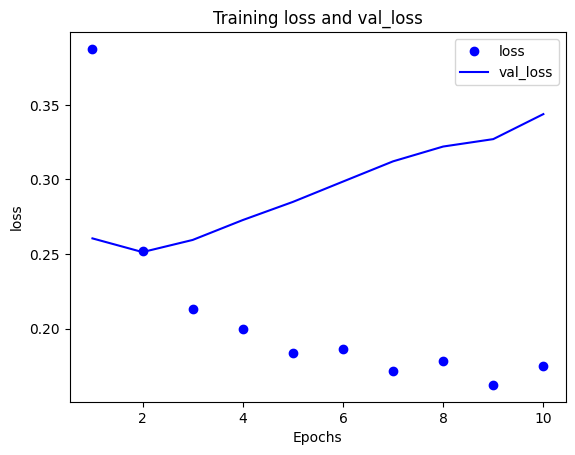

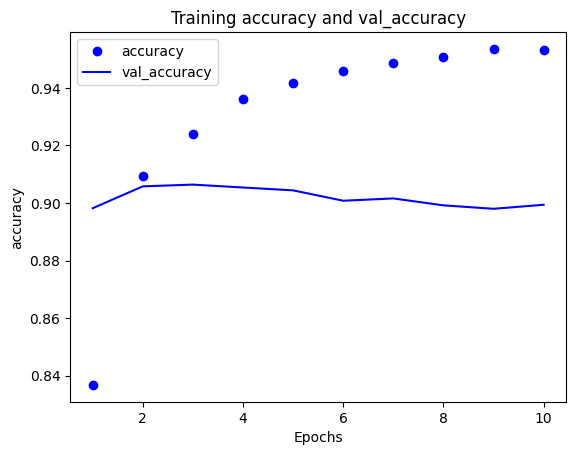

In [54]:
# Bigrams with TF-IDF encoding
text_vectorizatio = TextVectorization(
    ngrams=2,
    max_tokens=20000,
    output_mode="tf_idf"     # previous approaches are using "multi-hot"
)

text_only_train_ds = train_ds.map(lambda x, y : x)
text_vectorization.adapt(text_only_train_ds)

binary_2gram_train_ds = train_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    # parallelize the map() call across multiple cpu cores
)
binary_2gram_val_ds = val_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)
binary_2gram_test_ds = test_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4    
)

model = get_model()

# trian model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_tfidf_2gram.keras",
                                   save_best_only=True)
]

history = model.fit(binary_2gram_train_ds.cache(),               
                     validation_data=binary_2gram_val_ds.cache(),
                     epochs=10,
                     callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

# test accuracy
model = keras.models.load_model("ch11_tfidf_2gram.keras")
print(f"Test acc: {model.evaluate(binary_2gram_test_ds)[1]:.3f}")

### 11.3.3 Processing words as a sequence: The sequnce model approach

In [10]:
# prepare integer sequence datasets
from tensorflow.keras import layers

max_length = 600    # truncate the inputs after the first 600 words
max_tokens = 20000
text_vectorization = layers.TextVectorization(
    max_tokens=max_tokens,
    output_mode="int",  # the text is represented as sequences of integer indices, where each index corresponds to a specific token in the vocabulary.
    output_sequence_length=max_length,
)

text_only_train_ds = train_ds.map(lambda x, y : x)
text_vectorization.adapt(text_only_train_ds)

int_train_ds = train_ds.map(
    lambda x, y: (text_vectorization(x), y),   # input sample will have shape of (600,), this is before one-hot encoding
    num_parallel_calls=4
)
int_val_ds = val_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4
)
int_test_ds = test_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4
)

2024-07-02 22:31:03.626327: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


#### 11.3.3.1 Integer sequence of one-hot encoding with LSTM

In [26]:
# the below code runs ok in python 3.10.12 + tf 2.15.0, but not in py3.10.14 + tf2.16.1
# Convert integer sequence to vector sequence via on-hot encoding
import tensorflow as tf

inputs = keras.Input(shape=(None,), dtype="int64")
# this gave error for py3.10.14 + tf2.16.1, but not py3.10.12 + tf2.15.0
embedded = tf.one_hot(inputs, depth=max_tokens)    # from int sequence (600,) to vector sequence of shape (600, 20000)

x = layers.Bidirectional(layers.LSTM(32))(embedded)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)

model = keras.Model(inputs, outputs)

model.compile(optimizer="rmsprop",
             loss="binary_crossentropy",
             metrics=["accuracy"])
model.summary()

Model: "model_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, None)]            0         
                                                                 
 tf.one_hot_5 (TFOpLambda)   (None, None, 20000)       0         
                                                                 
 bidirectional_5 (Bidirecti  (None, 64)                5128448   
 onal)                                                           
                                                                 
 dropout_5 (Dropout)         (None, 64)                0         
                                                                 
 dense_5 (Dense)             (None, 1)                 65        
                                                                 
Total params: 5128513 (19.56 MB)
Trainable params: 5128513 (19.56 MB)
Non-trainable params: 0 (0.00 Byte)
___________________

Epoch 1/10
625/625 [==============================] - 912s 1s/step - loss: 0.5272 - accuracy: 0.7593 - val_loss: 0.8807 - val_accuracy: 0.6878
Epoch 2/10
625/625 [==============================] - 929s 1s/step - loss: 0.3664 - accuracy: 0.8666 - val_loss: 0.2853 - val_accuracy: 0.8934
Epoch 3/10
625/625 [==============================] - 856s 1s/step - loss: 0.2792 - accuracy: 0.9039 - val_loss: 0.2939 - val_accuracy: 0.8806
Epoch 4/10
625/625 [==============================] - 913s 1s/step - loss: 0.2450 - accuracy: 0.9162 - val_loss: 0.2819 - val_accuracy: 0.9006
Epoch 5/10
625/625 [==============================] - 842s 1s/step - loss: 0.2021 - accuracy: 0.9312 - val_loss: 0.2665 - val_accuracy: 0.8980
Epoch 6/10
625/625 [==============================] - 948s 2s/step - loss: 0.1806 - accuracy: 0.9359 - val_loss: 0.4749 - val_accuracy: 0.8674
Epoch 7/10
625/625 [==============================] - 815s 1s/step - loss: 0.1644 - accuracy: 0.9446 - val_loss: 0.2913 - val_accuracy: 0.8856

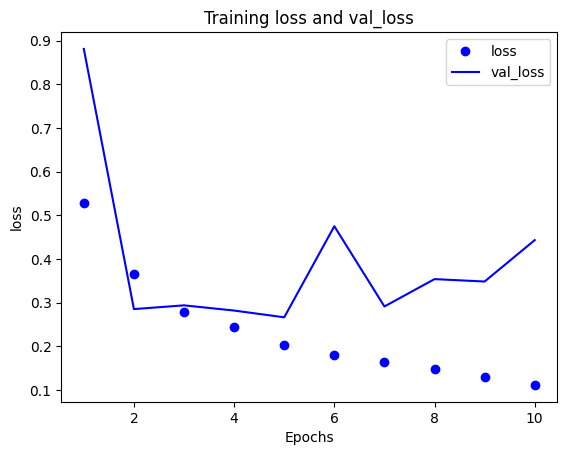

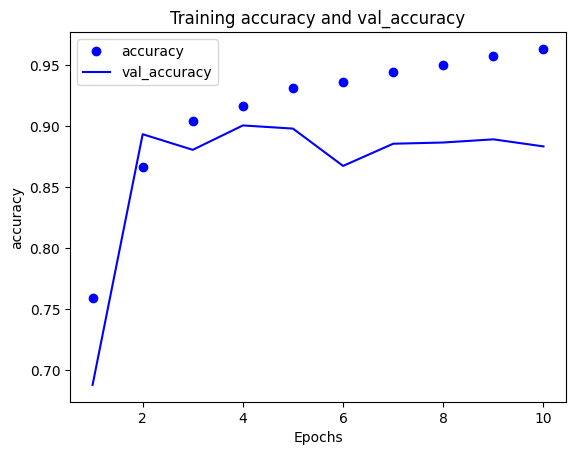

In [27]:
# train the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_one_hot_bidir_lstm.keras", save_best_only=True)
]

# with tf.device('/cpu:0'):  # for this one, gpu (800s) is faster than cpu (1300s). why?
history = model.fit(int_train_ds,
                   validation_data=int_val_ds,
                   epochs=10,
                   callbacks=callbacks)
    
# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [28]:
# Test data accuracy
model = keras.models.load_model("ch11_one_hot_bidir_lstm.keras")
print(f"Test acc: {model.evaluate(int_test_ds)[1]:.3f}")

782/782 [==============================] - 445s 564ms/step - loss: 0.3145 - accuracy: 0.8735
Test acc: 0.873


#### 11.3.3.2 Custom embedding layer trained together with LSTM

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, None)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding (Embedding)           │ (None, None, 256)      │     5,120,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional (Bidirectional)   │ (None, 64)             │        73,984 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,194,049 (19.81 MB)

 Trainable params: 5,194,049 (19.81 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10


2024-07-02 22:31:15.706508: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


625/625 ━━━━━━━━━━━━━━━━━━━━ 84s 132ms/step - accuracy: 0.6290 - loss: 0.6206 - val_accuracy: 0.8124 - val_loss: 0.4250
Epoch 2/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 76s 122ms/step - accuracy: 0.8370 - loss: 0.4090 - val_accuracy: 0.8526 - val_loss: 0.3534
Epoch 3/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 75s 120ms/step - accuracy: 0.8754 - loss: 0.3272 - val_accuracy: 0.7976 - val_loss: 0.4390
Epoch 4/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 73s 117ms/step - accuracy: 0.8947 - loss: 0.2841 - val_accuracy: 0.8238 - val_loss: 0.4195
Epoch 5/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 72s 114ms/step - accuracy: 0.9160 - loss: 0.2339 - val_accuracy: 0.8512 - val_loss: 0.3606
Epoch 6/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 71s 114ms/step - accuracy: 0.9299 - loss: 0.2050 - val_accuracy: 0.8868 - val_loss: 0.2956
Epoch 7/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 69s 111ms/step - accuracy: 0.9424 - loss: 0.1755 - val_accuracy: 0.8826 - val_loss: 0.3194
Epoch 8/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 69s 110ms/step - accuracy: 0.9523 - loss: 0.1405 - val

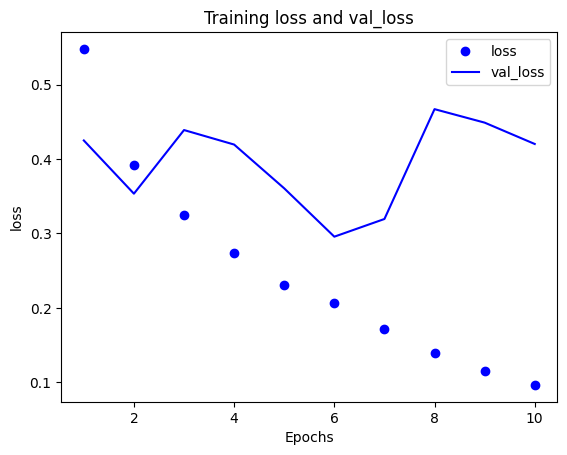

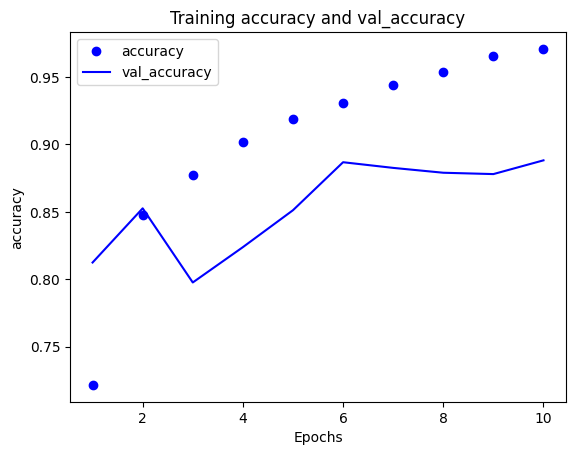

In [11]:
# Learning (training) a custom embedding layer
inputs = keras.Input(shape=(None,), dtype="int64") # can process varying length input of int integer sequence
max_tokens = 20000
embedded = layers.Embedding(input_dim=max_tokens, output_dim=256)(inputs) # (256,) vector to represent 20000 words
x = layers.Bidirectional(layers.LSTM(32))(embedded)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)

model.compile(optimizer="rmsprop",
             loss="binary_crossentropy",
             metrics=["accuracy"])
model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_embeddings_bidir_gru.keras",  # it should be named as lstm?
                                   save_best_only=True)
]

# gpu runs faster than cpu for this model
history = model.fit(int_train_ds, validation_data=int_val_ds, epochs=10, callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [12]:
# Test data evaluation
model = keras.models.load_model("ch11_embeddings_bidir_gru.keras")
print(f"Test ACC: {model.evaluate(int_test_ds)[1]:.3f}")

782/782 ━━━━━━━━━━━━━━━━━━━━ 24s 31ms/step - accuracy: 0.8603 - loss: 0.3522
Test ACC: 0.863


#### 11.3.3.3 Custom embedding with masking, trained together with LSTM

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_2         │ (None, None, 256) │  5,120,000 │ input_layer_2[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ not_equal_1         │ (None, None)      │          0 │ input_layer_2[0]… │
│ (NotEqual)          │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_2     │ (None, 64)        │     73,984 │ embedding_2[0][0… │
│ (Bidirectional)     │                   │            │ not_equal_1[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 64)        │          0 │ bidirectional_2[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_2 (Dense)     │ (None, 1)         │         65 │ dropout_2[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 5,194,049 (19.81 MB)

 Trainable params: 5,194,049 (19.81 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 89s 141ms/step - accuracy: 0.5030 - loss: 0.6955 - val_accuracy: 0.5070 - val_loss: 0.6928
Epoch 2/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 87s 139ms/step - accuracy: 0.5025 - loss: 0.6942 - val_accuracy: 0.5068 - val_loss: 0.6928
Epoch 3/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 86s 137ms/step - accuracy: 0.5042 - loss: 0.6935 - val_accuracy: 0.4996 - val_loss: 0.6927
Epoch 4/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 86s 137ms/step - accuracy: 0.5005 - loss: 0.6932 - val_accuracy: 0.5076 - val_loss: 0.6926
Epoch 5/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 85s 136ms/step - accuracy: 0.5059 - loss: 0.6933 - val_accuracy: 0.5082 - val_loss: 0.6924
Epoch 6/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 84s 135ms/step - accuracy: 0.5030 - loss: 0.6930 - val_accuracy: 0.5080 - val_loss: 0.6923
Epoch 7/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 85s 137ms/step - accuracy: 0.5121 - loss: 0.6924 - val_accuracy: 0.5008 - val_loss: 0.6926
Epoch 8/10
625/625 ━━━━━━━━━━━━━━━━━━━━ 88s 141ms/step - accuracy: 0.5119 - loss: 0

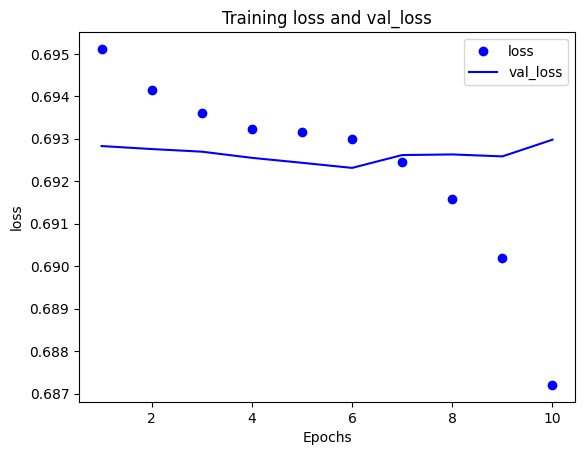

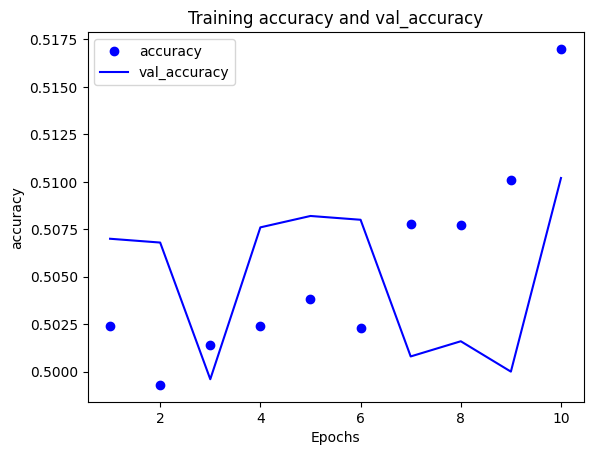

In [14]:
# Using an Embedding layer with masking enabled to skip padding at the end of the input sequence
inputs = keras.Input(shape=(None,), dtype="int64")
embedded = layers.Embedding(input_dim=max_tokens, 
                            output_dim=256, 
                            mask_zero=True)(inputs)  # mask_zero=True is the different part than previous model
x = layers.Bidirectional(layers.LSTM(32))(embedded)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)

model.compile(optimizer="rmsprop",
             loss="binary_crossentropy",
             metrics=["accuracy"])

model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_embeddings_bidir_gru_with_masking.keras", save_best_only=True)
]

history = model.fit(int_train_ds, validation_data=int_val_ds, epochs=10, callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [15]:
# Test data evaluation
model = keras.models.load_model("ch11_embeddings_bidir_gru_with_masking.keras")
print(f"Test ACC: {model.evaluate(int_test_ds)[1]:.3f}")

782/782 ━━━━━━━━━━━━━━━━━━━━ 29s 37ms/step - accuracy: 0.5067 - loss: 0.6928
Test ACC: 0.503


#### 11.3.3.4 Using pretrained word embeddings

In [16]:
# Create the directory if it doesn't exist
!mkdir -p ../datasets/glove 

# Download data
!wget -P ../datasets/glove http://nlp.stanford.edu/data/glove.6B.zip
!unzip -q ../datasets/glove/glove.6B.zip -d ../datasets/glove
!head -n 1 ../datasets/glove/glove.6B.100d.txt

the -0.038194 -0.24487 0.72812 -0.39961 0.083172 0.043953 -0.39141 0.3344 -0.57545 0.087459 0.28787 -0.06731 0.30906 -0.26384 -0.13231 -0.20757 0.33395 -0.33848 -0.31743 -0.48336 0.1464 -0.37304 0.34577 0.052041 0.44946 -0.46971 0.02628 -0.54155 -0.15518 -0.14107 -0.039722 0.28277 0.14393 0.23464 -0.31021 0.086173 0.20397 0.52624 0.17164 -0.082378 -0.71787 -0.41531 0.20335 -0.12763 0.41367 0.55187 0.57908 -0.33477 -0.36559 -0.54857 -0.062892 0.26584 0.30205 0.99775 -0.80481 -3.0243 0.01254 -0.36942 2.2167 0.72201 -0.24978 0.92136 0.034514 0.46745 1.1079 -0.19358 -0.074575 0.23353 -0.052062 -0.22044 0.057162 -0.15806 -0.30798 -0.41625 0.37972 0.15006 -0.53212 -0.2055 -1.2526 0.071624 0.70565 0.49744 -0.42063 0.26148 -1.538 -0.30223 -0.073438 -0.28312 0.37104 -0.25217 0.016215 -0.017099 -0.38984 0.87424 -0.72569 -0.51058 -0.52028 -0.1459 0.8278 0.27062


In [19]:
# inspect the glove embedding example
path_to_glove_file = "../datasets/glove/glove.6B.100d.txt"

with open(path_to_glove_file) as f:
    for line in f:
        print(line)
        word, coefs = line.split(maxsplit=1)
        coefs = np.fromstring(coefs, "f", sep=" ")
        print(word)
        print(coefs)
        break

the -0.038194 -0.24487 0.72812 -0.39961 0.083172 0.043953 -0.39141 0.3344 -0.57545 0.087459 0.28787 -0.06731 0.30906 -0.26384 -0.13231 -0.20757 0.33395 -0.33848 -0.31743 -0.48336 0.1464 -0.37304 0.34577 0.052041 0.44946 -0.46971 0.02628 -0.54155 -0.15518 -0.14107 -0.039722 0.28277 0.14393 0.23464 -0.31021 0.086173 0.20397 0.52624 0.17164 -0.082378 -0.71787 -0.41531 0.20335 -0.12763 0.41367 0.55187 0.57908 -0.33477 -0.36559 -0.54857 -0.062892 0.26584 0.30205 0.99775 -0.80481 -3.0243 0.01254 -0.36942 2.2167 0.72201 -0.24978 0.92136 0.034514 0.46745 1.1079 -0.19358 -0.074575 0.23353 -0.052062 -0.22044 0.057162 -0.15806 -0.30798 -0.41625 0.37972 0.15006 -0.53212 -0.2055 -1.2526 0.071624 0.70565 0.49744 -0.42063 0.26148 -1.538 -0.30223 -0.073438 -0.28312 0.37104 -0.25217 0.016215 -0.017099 -0.38984 0.87424 -0.72569 -0.51058 -0.52028 -0.1459 0.8278 0.27062

the
[-0.038194 -0.24487   0.72812  -0.39961   0.083172  0.043953 -0.39141
  0.3344   -0.57545   0.087459  0.28787  -0.06731   0.30906  -

In [27]:
## Preparing a fixed embedding layer using vectorization and glove word-embeddings database
## input text --vectorization--> word_to_int_index + word --glove--> vector ===> integer -> vector
import numpy as np
from tensorflow.keras.layers import TextVectorization

# populate the vectorization vocabulary 
max_length = 600
max_tokens = 20000
text_vectorization = layers.TextVectorization(
    max_tokens=max_tokens,
    output_mode="int",
    output_sequence_length=max_length,
)
text_only_train_ds = train_ds.map(lambda x, y : x)
text_vectorization.adapt(text_only_train_ds)

# prepare input by converting text to integer sequence (token index sequence)
int_train_ds = train_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4)
int_val_ds = val_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4)
int_test_ds = test_ds.map(
    lambda x, y: (text_vectorization(x), y),
    num_parallel_calls=4)

# prepare the vectorization_word_to_index mapping using previous text_vectorization
vocabulary = text_vectorization.get_vocabulary()   # a list of words, the index is the same as token index in vocabulary
print(f"Text vectorization vocabulary size: {len(vocabulary)}")
vectorization_word_to_index = dict(zip(vocabulary, range(len(vocabulary))))   # map word to index in the vocabulary

# prepare the embedding_index mapping: map word to glove vector
path_to_glove_file = "../datasets/glove/glove.6B.100d.txt"
embeddings_index = {}
with open(path_to_glove_file) as f:
    for line in f:
        word, coefs = line.split(maxsplit=1)
        coefs = np.fromstring(coefs, "f", sep=" ")
        embeddings_index[word] = coefs
print(f"Found {len(embeddings_index)} word vectors in glove-6B-100d.")

# Prepareing the GloVe word-embeddings matrix by combining the two mapping dicts
# map token integer to glove vector: int token i will be mapped to embedding_matrix[i]
embedding_dim = 100
embedding_matrix = np.zeros((max_tokens, embedding_dim))
for word, token in vectorization_word_to_index.items():
    if token < max_tokens:
        embedding_vector = embeddings_index.get(word)
    if embedding_vector is  not None:  # handle case where the word in vocabulary is not in the glove database
        embedding_matrix[token] = embedding_vector

# embedding_layer using the embedding_matrix (token integer index -> glove vector)
# an integer i will be mapped to embedding_matrix[i]
embedding_layer = layers.Embedding(
    max_tokens,
    embedding_dim,
    embeddings_initializer=keras.initializers.Constant(embedding_matrix),
    trainable = False,  # freeze the layer during training
    mask_zero=True,
)

2024-07-03 21:31:16.615142: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Text vectorization vocabulary size: 20000
Found 400000 word vectors in glove-6B-100d.


Model: "functional_13"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6       │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_7         │ (None, None, 100) │  2,000,000 │ input_layer_6[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ not_equal_8         │ (None, None)      │          0 │ input_layer_6[0]… │
│ (NotEqual)          │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_6     │ (None, 64)        │     34,048 │ embedding_7[0][0… │
│ (Bidirectional)     │                   │            │ not_equal_8[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_6 (Dropout) │ (None, 64)        │          0 │ bidirectional_6[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_6 (Dense)     │ (None, 1)         │         65 │ dropout_6[0][0]   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,034,113 (7.76 MB)

 Trainable params: 34,113 (133.25 KB)

 Non-trainable params: 2,000,000 (7.63 MB)

Epoch 1/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 53s 82ms/step - accuracy: 0.4982 - loss: 0.6942 - val_accuracy: 0.5096 - val_loss: 0.6915
Epoch 2/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 52s 84ms/step - accuracy: 0.5022 - loss: 0.6917 - val_accuracy: 0.5160 - val_loss: 0.6894
Epoch 3/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 54s 86ms/step - accuracy: 0.5070 - loss: 0.6902 - val_accuracy: 0.5138 - val_loss: 0.6889
Epoch 4/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 53s 85ms/step - accuracy: 0.5096 - loss: 0.6886 - val_accuracy: 0.5180 - val_loss: 0.6874
Epoch 5/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 53s 85ms/step - accuracy: 0.5127 - loss: 0.6864 - val_accuracy: 0.5202 - val_loss: 0.6863
Epoch 6/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 53s 85ms/step - accuracy: 0.5387 - loss: 0.6812 - val_accuracy: 0.5108 - val_loss: 0.6851
Epoch 7/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 54s 87ms/step - accuracy: 0.6257 - loss: 0.6477 - val_accuracy: 0.6824 - val_loss: 0.6150
Epoch 8/30
625/625 ━━━━━━━━━━━━━━━━━━━━ 53s 85ms/step - accuracy: 0.6379 - loss: 0.6355 - 

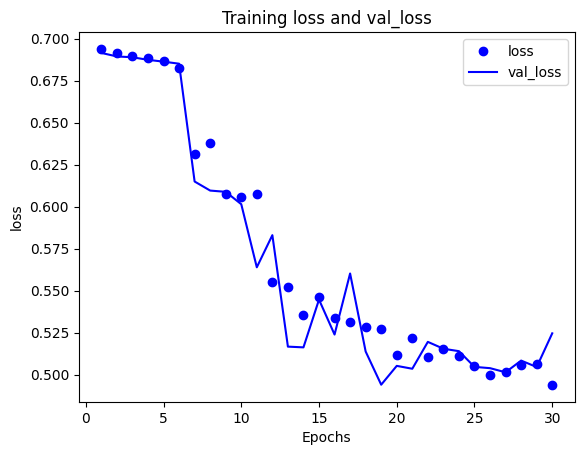

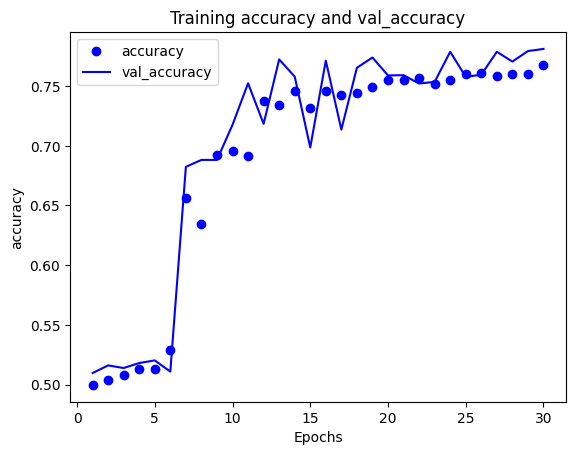

In [28]:
# Train a model that uses a pretrained embedding layer - glove
inputs = keras.Input(shape=(None,), dtype="int64")
embedded = embedding_layer(inputs) 
x = layers.Bidirectional(layers.LSTM(32))(embedded)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)

model.compile(optimizer="rmsprop",
             loss="binary_crossentropy",
             metrics=["accuracy"])

model.summary()

callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_glove_embeddings_sequnce_model.keras", save_best_only=True)
]

history = model.fit(int_train_ds, validation_data=int_val_ds, epochs=30, callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [26]:
# Test data evaluation
model = keras.models.load_model("ch11_glove_embeddings_sequnce_model.keras")
print(f"Test ACC: {model.evaluate(int_test_ds)[1]:.3f}")

782/782 ━━━━━━━━━━━━━━━━━━━━ 30s 38ms/step - accuracy: 0.7422 - loss: 0.5343
Test ACC: 0.743


## 11.4 The Transformer architecture

### 11.4.1 Self attention for imdb dataset

In [161]:
# Transformer encoder implemented as a subclassed Layer
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

class TransformerEncoder(layers.Layer):
    def __init__(self, embed_dim, dense_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.dense_dim = dense_dim
        self.num_heads = num_heads
        self.attention = layers.MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.dense_proj = keras.Sequential(
            [layers.Dense(dense_dim, activation="relu"), # first dense projection to smaller number of dimension
            layers.Dense(embed_dim),]                    # dense projection to restore the dimension
        )
        self.layernorm_1 = layers.LayerNormalization()
        self.layernorm_2 = layers.LayerNormalization()
        self.supports_masking = True

    # def build(self, input_shape):
    #     self.attention.build(input_shape, input_shape, input_shape)
    #     self.dense_proj.build(input_shape)
    #     self.layernorm_1.build(input_shape)
    #     self.layernorm_2.build(input_shape)
    #     super().build(input_shape)

    def call(self, inputs, mask=None):
        if mask is not None:
            padding_mask = mask[:, tf.newaxis, :]  # change shape from (batch_size, seq_len) to (batch_size, 1, seq_len)
        else:
            padding_mask = None
            
        attention_output = self.attention(query=inputs, value=inputs, key=inputs, attention_mask=padding_mask)  # query, value, key(optional, will use value if absent), attention_mask
        proj_input = self.layernorm_1(inputs + attention_output)
        proj_output = self.dense_proj(proj_input)
        return self.layernorm_2(proj_input + proj_output)

    def get_config(self):
        config = super().get_config()
        config.update({
            "embed_dim": self.embed_dim,
            "num_heads": self.num_heads,
            "dense_dim": self.dense_dim,
        })
        return config

In [162]:
# Using the transformer encoder for text classification
vocab_size = 20000
embed_dim = 256
num_heads = 2
dense_dim = 32

inputs = keras.Input(shape=(None,), dtype="int64")
x = layers.Embedding(vocab_size, embed_dim)(inputs)
x = TransformerEncoder(embed_dim, dense_dim, num_heads)(x)
x = layers.GlobalMaxPooling1D()(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)
model.compile(optimizer="rmsprop", loss="binary_crossentropy", metrics=["accuracy"])
model.summary()

Model: "functional_108"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_73 (InputLayer)     │ (None, None)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_92 (Embedding)        │ (None, None, 256)      │     5,120,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ transformer_encoder_29          │ (None, None, 256)      │       543,776 │
│ (TransformerEncoder)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling1d_22         │ (None, 256)            │             0 │
│ (GlobalMaxPooling1D)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_75 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_120 (Dense)               │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,664,033 (21.61 MB)

 Trainable params: 5,664,033 (21.61 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 263s 417ms/step - accuracy: 0.5261 - loss: 0.9020 - val_accuracy: 0.8004 - val_loss: 0.4227
Epoch 2/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 258s 413ms/step - accuracy: 0.7925 - loss: 0.4426 - val_accuracy: 0.8520 - val_loss: 0.3363
Epoch 3/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 263s 420ms/step - accuracy: 0.8425 - loss: 0.3645 - val_accuracy: 0.8578 - val_loss: 0.3211
Epoch 4/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 260s 416ms/step - accuracy: 0.8610 - loss: 0.3271 - val_accuracy: 0.8648 - val_loss: 0.3032
Epoch 5/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 261s 417ms/step - accuracy: 0.8738 - loss: 0.2967 - val_accuracy: 0.8714 - val_loss: 0.2971
Epoch 6/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 257s 411ms/step - accuracy: 0.8860 - loss: 0.2722 - val_accuracy: 0.8760 - val_loss: 0.2913
Epoch 7/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 255s 408ms/step - accuracy: 0.8962 - loss: 0.2517 - val_accuracy: 0.8740 - val_loss: 0.3005
Epoch 8/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 254s 407ms/step - accuracy: 0.9108 -

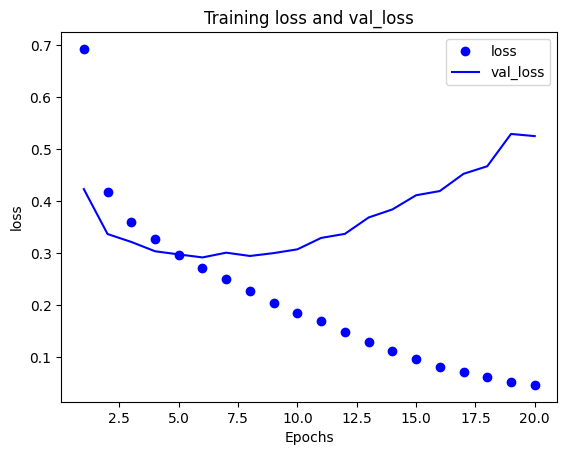

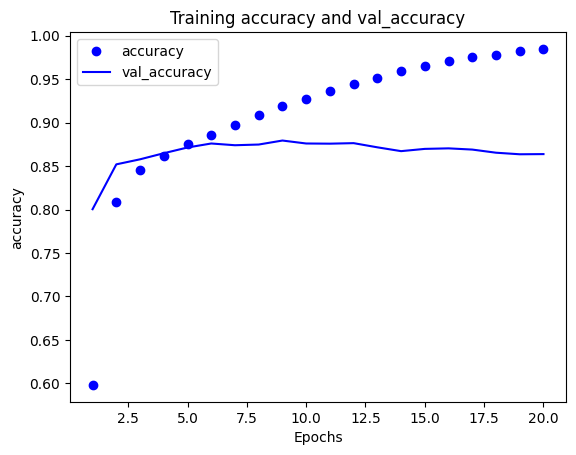

In [67]:
# Training and evaluating the transformer encode based model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_transformer_encoder.keras", save_best_only=True)
]

# gpu runs faster then cpu
history = model.fit(int_train_ds, validation_data=int_val_ds, epochs=20, callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [163]:
# test data evaluation
model = keras.models.load_model(
    "ch11_transformer_encoder.keras", 
    custom_objects={"TransformerEncoder": TransformerEncoder})
print(f"Test acc: {model.evaluate(int_test_ds)[1]:.3f}")

/Volumes/App/micromamba/envs/jupyter_py31014_tf2161_GPU/lib/python3.10/site-packages/keras/src/layers/layer.py:361: UserWarning: `build()` was called on layer 'transformer_encoder_14', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(


782/782 ━━━━━━━━━━━━━━━━━━━━ 86s 108ms/step - accuracy: 0.8683 - loss: 0.3169
Test acc: 0.868


### 11.4.2 Transformer (self attention and positional embedding)

In [164]:
from tensorflow.keras import saving
import keras.ops as ops
# https://keras.io/examples/nlp/neural_machine_translation_with_transformer/

# @saving.register_keras_serializable()    # this is needed for loading the saved model
class TensorInputMaskWrapper(layers.Layer):
    """
    This wrapper is needed becasue a tensor cannot directly be passed to a tensorflow function.
    """
    def call(self, tensor_inputs):
        return tf.math.not_equal(tensor_inputs, 0)

    def get_config(self):
        config = super().get_config()
        return config
        
# Implementing token embedding + positional embedding as a subclassed layer
# @saving.register_keras_serializable()
class PositionalEmbedding(layers.Layer):
    def __init__(self, sequence_length, input_dim, output_dim, **kwargs):
        super().__init__(**kwargs)
        self.token_embeddings = layers.Embedding(input_dim=input_dim, output_dim=output_dim)
        self.position_embeddings = layers.Embedding(input_dim=sequence_length, output_dim=output_dim)
        self.sequence_length = sequence_length
        self.input_dim = input_dim
        self.output_dim = output_dim
        # self.mask_wrapper = TensorInputMaskWrapper()

    def call(self, inputs):
        length = tf.shape(inputs)[-1]
        positions = tf.range(start=0, limit=length, delta=1)
        embedded_tokens = self.token_embeddings(inputs)
        embedded_positions = self.position_embeddings(positions)
        return embedded_tokens + embedded_positions

    # this method will be called automatically by the framework and propagate to the following layers, such as TransformerEncoder
    # similar as a standard layers.Embedding layer
    def compute_mask(self, inputs, mask=None):
        ## the below code gave error for python 3.10.14 + TF 2.16.11 gave an error (A KerasTensor cannot be used as input to a TensorFlow function.) when building the model
        ## Tried to use a wrapper layer
        # return tf.math.not_equal(inputs, 0)  # output is a boolean tensor where 0 -> False, non 0 -> True
        # return self.mask_wrapper(inputs)

        if mask is None:
            return None
        else:
            return ops.not_equal(inputs, 0)

    def get_config(self):
        config = super().get_config()
        config.update({
            "sequence_length": self.sequence_length,
            "input_dim": self.input_dim,
            "output_dim": self.output_dim
        })
        return config

In [165]:
# Combining the Transformer encoder with positional embedding
# python 3.10.14 + TF 2.16.11 gave an error (A KerasTensor cannot be used as input to a TensorFlow function.) due to PositionalEmbedding's compute_mask
# but python 3.10.12 + tf 2.15.0 works directly. After using a wrapper class, py3.10.14+tf2.16.11 works.
vocab_size = 20000
sequence_length = 600
embed_dim = 256
num_heads = 2
dense_dim = 32

inputs = keras.Input(shape=(None,), dtype="int64")
x = PositionalEmbedding(sequence_length, vocab_size, embed_dim)(inputs)
x = TransformerEncoder(embed_dim, dense_dim, num_heads)(x)
x = layers.GlobalMaxPooling1D()(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)
model.compile(optimizer="rmsprop", loss="binary_crossentropy", metrics=["accuracy"])
model.summary()

Model: "functional_112"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_76 (InputLayer)     │ (None, None)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ positional_embedding_18         │ (None, None, 256)      │     5,273,600 │
│ (PositionalEmbedding)           │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ transformer_encoder_30          │ (None, None, 256)      │       543,776 │
│ (TransformerEncoder)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling1d_23         │ (None, 256)            │             0 │
│ (GlobalMaxPooling1D)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_78 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_125 (Dense)               │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,817,633 (22.19 MB)

 Trainable params: 5,817,633 (22.19 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


/Volumes/App/micromamba/envs/jupyter_py31014_tf2161_GPU/lib/python3.10/site-packages/keras/src/layers/layer.py:877: UserWarning: Layer 'query' (of type EinsumDense) was passed an input with a mask attached to it. However, this layer does not support masking and will therefore destroy the mask information. Downstream layers will not see the mask.
  warnings.warn(
/Volumes/App/micromamba/envs/jupyter_py31014_tf2161_GPU/lib/python3.10/site-packages/keras/src/layers/layer.py:877: UserWarning: Layer 'key' (of type EinsumDense) was passed an input with a mask attached to it. However, this layer does not support masking and will therefore destroy the mask information. Downstream layers will not see the mask.
  warnings.warn(
/Volumes/App/micromamba/envs/jupyter_py31014_tf2161_GPU/lib/python3.10/site-packages/keras/src/layers/layer.py:877: UserWarning: Layer 'value' (of type EinsumDense) was passed an input with a mask attached to it. However, this layer does not support masking and will there

625/625 ━━━━━━━━━━━━━━━━━━━━ 210s 332ms/step - accuracy: 0.6325 - loss: 0.7741 - val_accuracy: 0.8524 - val_loss: 0.3285
Epoch 2/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 219s 350ms/step - accuracy: 0.8365 - loss: 0.3728 - val_accuracy: 0.8692 - val_loss: 0.3109
Epoch 3/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 232s 371ms/step - accuracy: 0.8847 - loss: 0.2796 - val_accuracy: 0.8944 - val_loss: 0.2599
Epoch 4/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 227s 362ms/step - accuracy: 0.9083 - loss: 0.2277 - val_accuracy: 0.8984 - val_loss: 0.2671
Epoch 5/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 238s 381ms/step - accuracy: 0.9258 - loss: 0.1885 - val_accuracy: 0.8986 - val_loss: 0.2646
Epoch 6/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 235s 376ms/step - accuracy: 0.9422 - loss: 0.1509 - val_accuracy: 0.9018 - val_loss: 0.3050
Epoch 7/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 246s 393ms/step - accuracy: 0.9572 - loss: 0.1207 - val_accuracy: 0.8990 - val_loss: 0.3966
Epoch 8/20
625/625 ━━━━━━━━━━━━━━━━━━━━ 234s 374ms/step - accuracy: 0.9677 - loss: 0.09

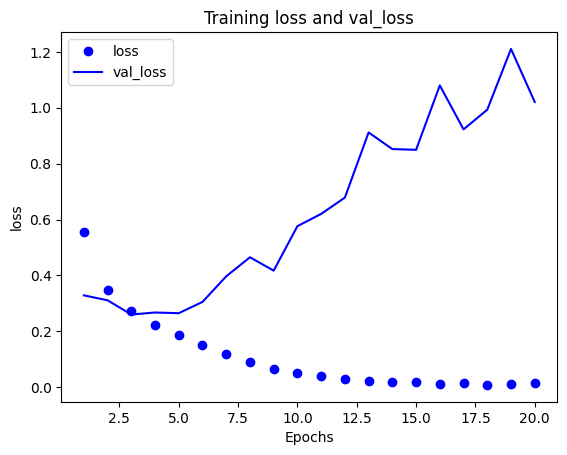

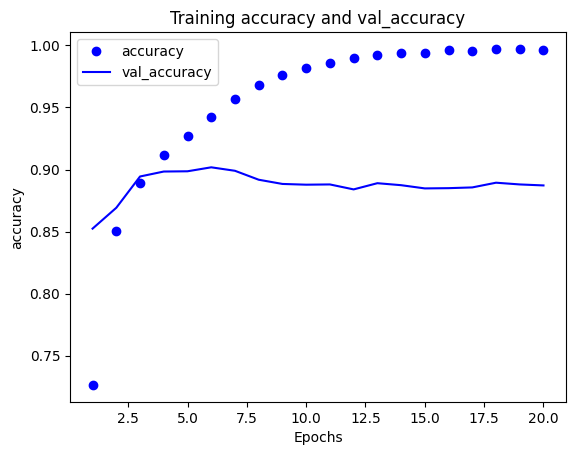

In [112]:
# Train the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_full_transformer_encoder.keras", save_best_only=True)
]

history = model.fit(int_train_ds, validation_data=int_val_ds, epochs=20, callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [113]:
# test data evaluation
model = keras.models.load_model("ch11_full_transformer_encoder.keras", 
                                custom_objects={
                                    "TransformerEncoder": TransformerEncoder, 
                                    "PositionalEmbedding":  PositionalEmbedding})
print(f"Test acc: {model.evaluate(int_test_ds)[1]:.3f}")

782/782 ━━━━━━━━━━━━━━━━━━━━ 90s 114ms/step - accuracy: 0.8784 - loss: 0.2959
Test acc: 0.881


## 11.5 Beyond text classification: Sequence-to-sequence learning

### 11.5.1 A machine translation example

In [21]:
!mkdir -p ../datasets/span_eng

!wget -P ../datasets http://storage.googleapis.com/download.tensorflow.org/data/spa-eng.zip
!unzip ../datasets/spa-eng.zip -d ../datasets

Archive:  ../datasets/spa-eng.zip
   creating: ../datasets/spa-eng/
  inflating: ../datasets/spa-eng/_about.txt  
  inflating: ../datasets/spa-eng/spa.txt  


In [153]:
# Parse the file
text_file = "../datasets/spa-eng/spa.txt"
with open(text_file) as f:
    lines = f.read().split("\n")[:-1]  # the last one is an empty string

text_pairs = []
for line in lines:
    english, spanish = line.split("\t")       # each line is a pair of english-spanish, such as "Run.	Corred."
    spanish = "[start] " + spanish + " [end]" # add special token at the beginning and end of the target sequence
    text_pairs.append((english, spanish))


# inspect one data example
import random
print(f"One example pair: {random.choice(text_pairs)}")
print(f"One example pair: {random.choice(text_pairs)}")

One example pair: ('Please wait a moment.', '[start] Por favor espere un momento. [end]')
One example pair: ('Keep your hands clean.', '[start] Mantén tus manos limpias. [end]')


In [166]:
# Shuffle the data and split them into train, val and test pairs
random.shuffle(text_pairs)
num_val_samples = int(0.15 * len(text_pairs))   # 15% for validation
num_train_samples = len(text_pairs) - 2 * num_val_samples      # 70% for training
train_pairs = text_pairs[:num_train_samples]    
val_pairs = text_pairs[num_train_samples:num_train_samples + num_val_samples]
test_pairs = text_pairs[num_train_samples + num_val_samples:]  # 15% for test

print(f"{len(text_pairs)} total pairs")
print(f"{len(train_pairs)} training pairs")
print(f"{len(val_pairs)} validation pairs")
print(f"{len(test_pairs)} test pairs")
print(f"max num of words in english sentences: {max([len(eng.split()) for eng, spa in text_pairs])}")
print(f"max num of words in spanish sentences: {max([len(spa.split()) for eng, spa in text_pairs])}")

118964 total pairs
83276 training pairs
17844 validation pairs
17844 test pairs
max num of words in english sentences: 47
max num of words in spanish sentences: 51


In [167]:
# Vectorization the english and spanish text pairs
import tensorflow as tf
import string
import re

# custom string standardization function for Spanish TextVectorization layer
# it preserves [ and ] but stripes ¿ and other punctuation characters
strip_chars = string.punctuation + "¿"
strip_chars = strip_chars.replace("[", "")
strip_chars = strip_chars.replace("]", "")

def custom_standardization(input_string):
    lowercase = tf.strings.lower(input_string)
    # f"[{re.escape(strip_chars)}]": This part defines the regular expression pattern that will be searched for and replaced.
    # - [] defines a character class in regular expression
    # - re.escape(strip_chars): This escapes any special characters within strip_chars to ensure they are interpreted literally in the regular expression.
    return tf.strings.regex_replace(lowercase, f"[{re.escape(strip_chars)}]", "")
    # return tf_strings.regex_replace(lowercase, "[%s]" % re.escape(strip_chars), "")

vocab_size = 15000     # use top 15000 most frequent words in each language
sequence_length = 20   # only look at the first 20 words

source_vectorization = layers.TextVectorization(
    max_tokens=vocab_size,
    output_mode="int",
    output_sequence_length=sequence_length
)

target_vectorization = layers.TextVectorization(
    max_tokens=vocab_size,
    output_mode="int",
    output_sequence_length=sequence_length + 1,   # one extra than source as we need to offset by one step during training
    standardize=custom_standardization            # use the custom standardization function
)

# learn the vocabulary
train_english_texts = [pair[0] for pair in train_pairs]
train_spanish_texts = [pair[1] for pair in train_pairs]
source_vectorization.adapt(train_english_texts)
target_vectorization.adapt(train_spanish_texts)

In [168]:
# Turn raw data into a tuple of (inputs, target) where inputs is a dict with two keys, english and spanish, the dict value is dataset element
# the target is a dataset element by offsetting spanish by one step
batch_size = 64

def format_dataset(eng, spa):
    """
    format the tf Dataset
    eng: shape of (batch_size,)
    spa: shape of (batch_size,)
    """
    eng = source_vectorization(eng)  # english string (batch_size,) -> integer sequence (batch_size, seq_len)
    spa = target_vectorization(spa)  # spanish string (batch_size,) -> integer sequence (batch_size, seq_len)
    return ({
        "english": eng,
        "spanish": spa[:,:-1],
    }, spa[:, 1:])    # the labels are integer sequence, which works directly with sparse_categorical_crossentropy

def make_dataset(pairs):
    # * unpacks the list into separate argements, in this case separate tuples
    # zip creates an iterator of tuples where the i-th tuple contains the i-th element from each of the input tuple iterables.
    # finally the iterator is unpacked into eng_texts tuple and spa_texts tuple
    eng_texts, spa_texts = zip(*pairs)  
    eng_texts = list(eng_texts)
    spa_texts = list(spa_texts)
    dataset = tf.data.Dataset.from_tensor_slices((eng_texts, spa_texts))  # a dataset where each element is a pair of (English text, Spanish text) of shape (2,)
    dataset = dataset.batch(batch_size)  # each element has shape of (batch_size, 2)
    # The map function in TensorFlow's Dataset API automatically unpacks the elements of each batch and passes them as separate arguments to the mapped function. 
    # So even though each element in the dataset after batching has a shape of (batch_size, 2), the map function correctly passes the English and Spanish texts as separate arguments to format_dataset.
    dataset = dataset.map(format_dataset, num_parallel_calls=4)    # use the above function to format the dataset
    return dataset.shuffle(2048).prefetch(16)

train_ds = make_dataset(train_pairs)
val_ds = make_dataset(val_pairs)

# inspect the dataset
for inputs, targets in train_ds.take(1):
    print(f"inputs['english'].shape: {inputs['english'].shape}")
    print(f"inputs['spanish'].shape: {inputs['spanish'].shape}")
    print(f"targets.shape: {targets.shape}")
    

inputs['english'].shape: (64, 20)
inputs['spanish'].shape: (64, 20)
targets.shape: (64, 20)


2024-07-07 14:29:21.220548: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


### 11.5.2 Sequence-to-sequence learning with RNN encoder and decoder

In [128]:
# Naive RNN LSTM for sequence-to-sequence learning, it requires the source and target sequence to have the same length
# This model only looks at 0-N tokens in the source sequence to predict the token N in the target sequence, which is not suitable for most tasks
inputs = keras.Input(shape=(sequence_length,), dtype="int64")
x = layers.Embedding(input_dim=vocab_size, output_dim=128)(inputs)
x = layers.LSTM(32, return_sequences=True)(x)   # return the whole intermediate sequences
outputs = layers.Dense(vocab_size, activation="softmax")(x)
model = keras.Model(inputs, outputs)

Model: "functional_128"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ english             │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ spanish             │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_119       │ (None, None, 256) │  3,840,000 │ english[0][0]     │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ not_equal_19        │ (None, None)      │          0 │ english[0][0]     │
│ (NotEqual)          │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_120       │ (None, None, 256) │  3,840,000 │ spanish[0][0]     │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_12    │ (None, 1024)      │  7,876,608 │ embedding_119[0]… │
│ (Bidirectional)     │                   │            │ not_equal_19[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ gru_11 (GRU)        │ (None, None,      │  3,938,304 │ embedding_120[0]… │
│                     │ 1024)             │            │ bidirectional_12… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_100         │ (None, None,      │          0 │ gru_11[0][0]      │
│ (Dropout)           │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_153 (Dense)   │ (None, None,      │ 15,375,000 │ dropout_100[0][0] │
│                     │ 15000)            │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 34,869,912 (133.02 MB)

 Trainable params: 34,869,912 (133.02 MB)

 Non-trainable params: 0 (0.00 B)

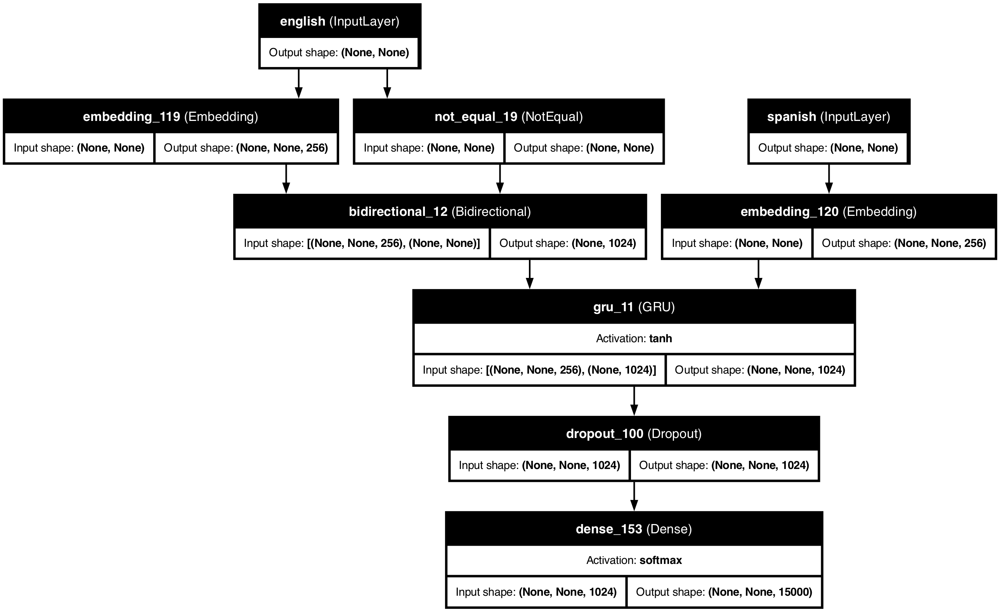

In [178]:
# Proper sequence-to-sequence model using encoder and decoder
from tensorflow import keras
from tensorflow.keras import layers

embed_dim = 256
latent_dim = 1024

# GRU based encoder, which turns the entire source sequence into a single vector (or a set of vectors)
source = keras.Input(shape=(None,), dtype="int64", name="english")       # use name key to select the related value from inputs dict (batch_size, seq_len)
# Use word embedding layer to convert integer tokens to dense vectors
x = layers.Embedding(vocab_size, embed_dim, mask_zero=True)(source)      # (batch_size, seq_len, embed_dim)
# Encode the English sentence using a Bidirectional GRU
# - mask_zero=True: considers padded tokens as zeros during training
# - Bidirectional GRU: processes the sequence in both directions
# - the merge_mode="sum" argument specifies how the outputs from the forward and backward GRU layers within the Bidirectional layer 
# - are combined to create a single encoded representation of the input sequence.
encoded_source = layers.Bidirectional(layers.GRU(latent_dim), merge_mode="sum") (x)    # (batch_size, latent_dim)

# GRU based decoder and the end-to-end model
target = keras.Input(shape=(None,), dtype="int64", name="spanish")  # use name key to select the related value from inputs dict
x = layers.Embedding(vocab_size, embed_dim, mask_zero=True)(target)
decoder_gru = layers.GRU(latent_dim, return_sequences=True)        # return full sequences of successive outputs (batch_size, seq_len, latent_dim)
x = decoder_gru(x, initial_state=encoded_source)  # here we use both encoded source sequence as initial state and encoded target sequence
x = layers.Dropout(0.5)(x)
target_next_step = layers.Dense(vocab_size, activation="softmax")(x)   # output shape (batch_size, seq_len, vocab_size)
seq2seq_rnn = keras.Model([source, target], target_next_step)

seq2seq_rnn.summary()
keras.utils.plot_model(seq2seq_rnn, "ch11_seq2seq_rnn.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

seq2seq_rnn.compile(optimizer="rmsprop",
                   loss="sparse_categorical_crossentropy",
                   metrics=["accuracy"])

In [179]:
# Train the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_seq2seq_rnn.keras", save_best_only=True)
]

history = seq2seq_rnn.fit(train_ds, epochs=15, validation_data=val_ds, callbacks=callbacks)

# Plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

Epoch 1/15
1098/1302 ━━━━━━━━━━━━━━━━━━━━ 2:34 759ms/step - accuracy: 0.3883 - loss: nan

KeyboardInterrupt: 

Epoch 1/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 635s 484ms/step - accuracy: 0.1505 - loss: 5.3986 - val_accuracy: 0.1236 - val_loss: 4.3828
Epoch 2/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 635s 487ms/step - accuracy: 0.1248 - loss: 4.4808 - val_accuracy: 0.1309 - val_loss: 4.1449
Epoch 3/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 631s 484ms/step - accuracy: 0.1308 - loss: 4.2765 - val_accuracy: 0.1356 - val_loss: 4.0137
Epoch 4/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 633s 485ms/step - accuracy: 0.1346 - loss: 4.1390 - val_accuracy: 0.1383 - val_loss: 3.9322
Epoch 5/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 637s 488ms/step - accuracy: 0.1373 - loss: 4.0386 - val_accuracy: 0.1442 - val_loss: 3.8733
Epoch 6/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 619s 474ms/step - accuracy: 0.1394 - loss: 3.9562 - val_accuracy: 0.1458 - val_loss: 3.8302
Epoch 7/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 658s 504ms/step - accuracy: 0.1417 - loss: 3.8824 - val_accuracy: 0.1433 - val_loss: 3.8024
Epoch 8/15
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 639s 491ms/step - ac

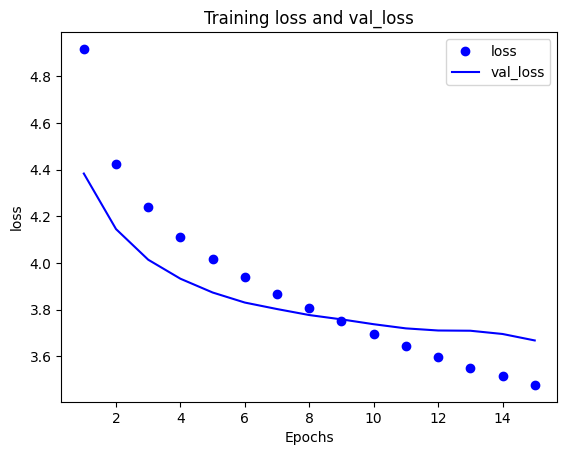

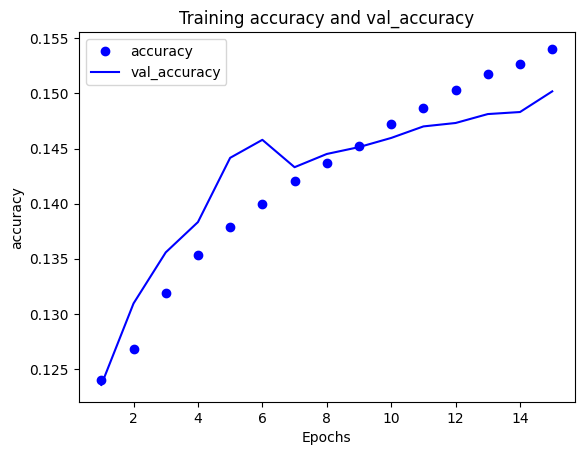

In [130]:
# Train the model
seq2seq_rnn.compile(optimizer="rmsprop",
                   loss="sparse_categorical_crossentropy",
                   metrics=["accuracy"])

history = seq2seq_rnn.fit(train_ds, epochs=15, validation_data=val_ds)

# Plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [140]:
# Inference (translating new sentences) with our RNN encoder and decoder
import numpy as np
spa_vocab = target_vectorization.get_vocabulary()
spa_index_lookup = dict(zip(range(len(spa_vocab)), spa_vocab))  # token (index) -> word
max_decoded_sentence_length = 20

model = keras.models.load_model("ch11_seq2seq_rnn.keras")

def decode_sequence(input_sentence):
    tokenized_input_sentence = source_vectorization([input_sentence])
    decoded_sentence = "[start]"
    for i in range(max_decoded_sentence_length):
        tokenized_target_sentence = target_vectorization([decoded_sentence])
        next_token_predictions = model.predict(
            [tokenized_input_sentence, tokenized_target_sentence])   # (1, max_decoded_sentence_length, vocab_size)
        sampled_token_index = np.argmax(next_token_predictions[0, i, :])  # the ith is the last output from the full sequence of gru outputs
        sampled_token = spa_index_lookup[sampled_token_index]
        decoded_sentence += " " + sampled_token
        if sampled_token == "[end]":
            break
    return decoded_sentence

test_eng_texts = [pair[0] for pair in test_pairs]
for _ in range(2):
    input_sentence = random.choice(test_eng_texts)
    print("-")
    print(input_sentence)
    print(decode_sequence(input_sentence))

-
Almost all the work is done now.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
[start] centavos sujetes ubuntu ensayo cosechas aproximaba trajo celebrado azúcar trote perdona vestirte ideal dame terroristas ultimarse engañando seguramente temerarias emborracho
-
Tom asked me how tal

### 11.5.3 Sequence-to-sequence learning with Transformer

In [169]:
# The transformer decoder
class TransformerDecoder(layers.Layer):
    def __init__(self, embed_dim, dense_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.dense_dim = dense_dim
        self.num_heads = num_heads
        self.attention_1 = layers.MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.attention_2 = layers.MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.dense_proj = keras.Sequential(
            [layers.Dense(dense_dim, activation="relu"),
             layers.Dense(embed_dim),]
        )
        self.layernorm_1 = layers.LayerNormalization()
        self.layernorm_2 = layers.LayerNormalization()
        self.layernorm_3 = layers.LayerNormalization()
        self.supports_masking = True
        
    def call(self, inputs, encoder_outputs, mask=None):
        causal_mask = self.get_causal_attention_mask(inputs)
        if mask is not None:
            padding_mask = tf.cast(
                mask[:, tf.newaxis, :], dtype="int32"
            )
            padding_mask = tf.minimum(padding_mask, causal_mask)
        else:
            padding_mask = None
            
        attention_output_1 = self.attention_1(
            query=inputs,
            value=inputs,
            key=inputs,
            attention_mask=causal_mask
        )
        attention_output_1 = self.layernorm_1(inputs + attention_output_1)
        
        attention_output_2 = self.attention_2(
            query=attention_output_1,
            value=encoder_outputs,
            key=encoder_outputs,
            attention_mask=padding_mask,
        )
        attention_output_2 = self.layernorm_2(attention_output_1 + attention_output_2)
        
        proj_output = self.dense_proj(attention_output_2)
        return self.layernorm_3(attention_output_2 + proj_output)
        
    # The TransformerDecoder sees the entire sequences at once, and thus we must make sure that it only uses information from target tokens 0 to N when predicting token N+1 
    # (otherwise, it could use information from the future, which would result in a model that cannot be used at inference time).
    def get_causal_attention_mask(self, inputs):
        input_shape = tf.shape(inputs)
        batch_size, sequence_length = input_shape[0], input_shape[1]
        i = tf.range(sequence_length)[:, tf.newaxis]
        j = tf.range(sequence_length)
        mask = tf.cast(i >= j, dtype="int32")
        mask = tf.reshape(mask, (1, input_shape[1], input_shape[1]))
        mult = tf.concat(
            [tf.expand_dims(batch_size, -1),
             tf.constant([1, 1], dtype=tf.int32)], 
            axis=0
        )
        return tf.tile(mask, mult)

    def get_config(self):
        config = super().get_config()
        config.update({
            "embed_dim": self.embed_dim,
            "num_heads": self.num_heads,
            "dense_dim": self.dense_dim,
        })
        return config

Model: "transformer"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ english             │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ spanish             │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ positional_embeddi… │ (None, None, 256) │  3,845,120 │ english[0][0]     │
│ (PositionalEmbeddi… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ positional_embeddi… │ (None, None, 256) │  3,845,120 │ spanish[0][0]     │
│ (PositionalEmbeddi… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ transformer_encode… │ (None, None, 256) │  3,155,456 │ positional_embed… │
│ (TransformerEncode… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ transformer_decode… │ (None, None, 256) │  5,259,520 │ positional_embed… │
│ (TransformerDecode… │                   │            │ transformer_enco… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_90          │ (None, None, 256) │          0 │ transformer_deco… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_140 (Dense)   │ (None, None,      │  3,855,000 │ dropout_90[0][0]  │
│                     │ 15000)            │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 19,960,216 (76.14 MB)

 Trainable params: 19,960,216 (76.14 MB)

 Non-trainable params: 0 (0.00 B)

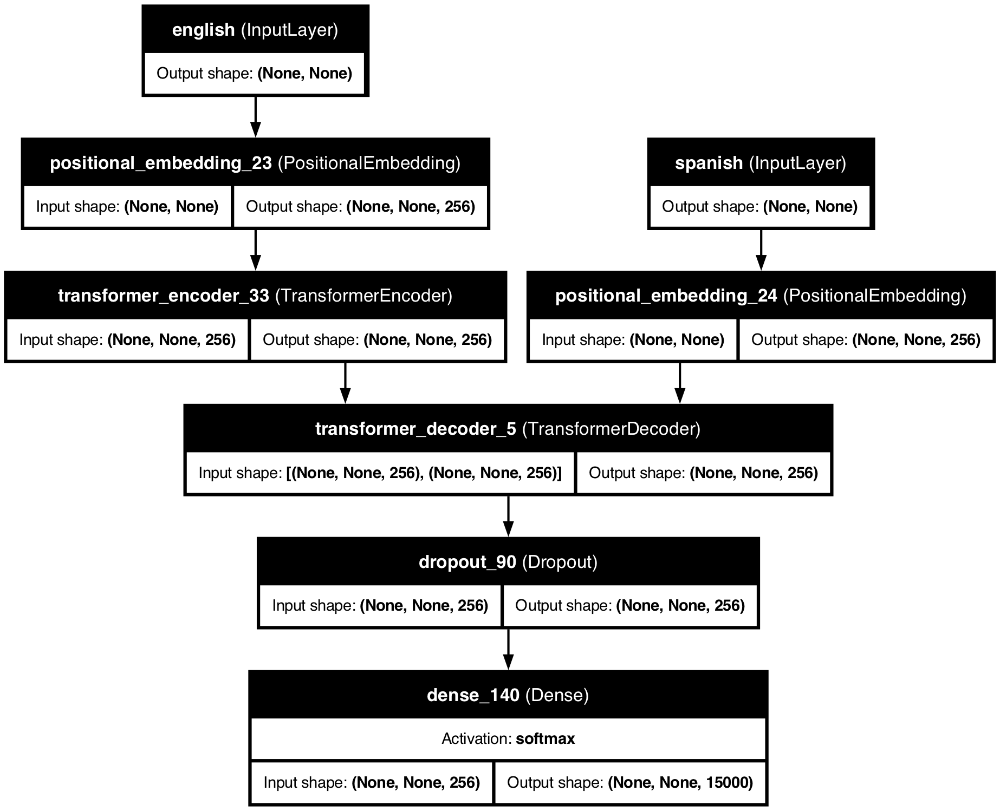

In [173]:
# end-to-end transformer
embed_dim = 256
dense_dim = 2048
num_heads = 8

encoder_inputs = keras.Input(shape=(None,), dtype="int64", name="english")
x = PositionalEmbedding(sequence_length, vocab_size, embed_dim)(encoder_inputs)
encoder_outputs = TransformerEncoder(embed_dim, dense_dim, num_heads)(x)

decoder_inputs = keras.Input(shape=(None,), dtype="int64", name="spanish")
x = PositionalEmbedding(sequence_length, vocab_size, embed_dim)(decoder_inputs)
x = TransformerDecoder(embed_dim, dense_dim, num_heads)(x, encoder_outputs)
x = layers.Dropout(0.5)(x)
decoder_outputs = layers.Dense(vocab_size, activation="softmax")(x)
transformer = keras.Model([encoder_inputs, decoder_inputs], decoder_outputs, name="transformer")

transformer.compile(optimizer="rmsprop",
                   loss="sparse_categorical_crossentropy",
                   metrics=["accuracy"])

transformer.summary()
keras.utils.plot_model(transformer, "ch11_transformer.png", 
                       show_shapes=True, 
                       show_layer_names=True,
                       show_layer_activations=True,
                       dpi=150)

Epoch 1/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 478s 363ms/step - accuracy: 0.7127 - loss: 2.2053 - val_accuracy: 0.8046 - val_loss: 1.2211
Epoch 2/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 475s 365ms/step - accuracy: 0.8161 - loss: 1.1716 - val_accuracy: 0.8546 - val_loss: 0.8789
Epoch 3/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 497s 381ms/step - accuracy: 0.8545 - loss: 0.8869 - val_accuracy: 0.8697 - val_loss: 0.7689
Epoch 4/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 451s 346ms/step - accuracy: 0.8698 - loss: 0.7694 - val_accuracy: 0.8738 - val_loss: 0.7328
Epoch 5/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 449s 345ms/step - accuracy: 0.8797 - loss: 0.6982 - val_accuracy: 0.8778 - val_loss: 0.7189
Epoch 6/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 451s 346ms/step - accuracy: 0.8877 - loss: 0.6442 - val_accuracy: 0.8813 - val_loss: 0.6919
Epoch 7/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 451s 346ms/step - accuracy: 0.8928 - loss: 0.6093 - val_accuracy: 0.8838 - val_loss: 0.6845
Epoch 8/30
1302/1302 ━━━━━━━━━━━━━━━━━━━━ 451s 346ms/step - ac

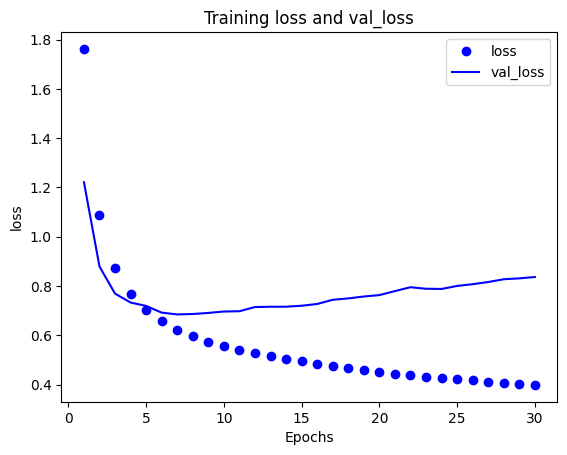

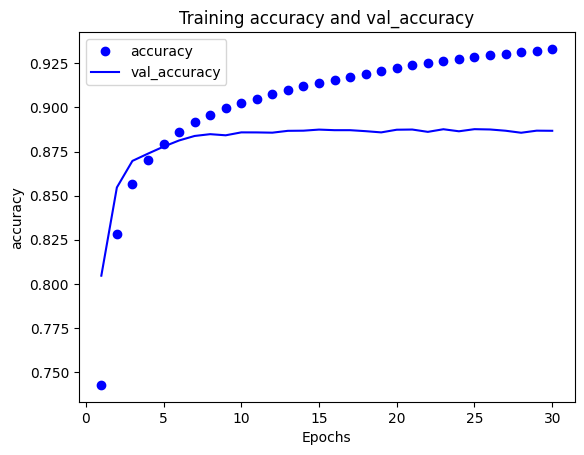

In [174]:
# Train the model
callbacks = [
    keras.callbacks.ModelCheckpoint("ch11_seq2seq_transformer.keras", save_best_only=True)
]

history = transformer.fit(train_ds, epochs=30, validation_data=val_ds, callbacks=callbacks)

# plot training history of loss and accuracy
plot_training_history(history, "loss", "val_loss")
plot_training_history(history, "accuracy", "val_accuracy")

In [177]:
# Translating new sentences with our Transformer model
import numpy as np
spa_vocab = target_vectorization.get_vocabulary()
spa_index_lookup = dict(zip(range(len(spa_vocab)), spa_vocab))
max_decoded_sentence_length = 20

model = keras.models.load_model("ch11_seq2seq_transformer.keras", 
                                custom_objects={
                                    "TransformerEncoder": TransformerEncoder, 
                                    "TransformerDecoder": TransformerDecoder, 
                                    "PositionalEmbedding":  PositionalEmbedding})

def decode_sequence(input_sequence):
    tokenized_input_sentence = source_vectorization([input_sentence])
    decoded_sentence = "[start]"
    for i in range(max_decoded_sentence_length):
        tokenized_target_sentence = target_vectorization(
            [decoded_sentence])[:, :-1]
        predictions = model(
            [tokenized_input_sentence, tokenized_target_sentence]
        )
        sampled_token_index = np.argmax(predictions[0, i, :])
        sampled_token = spa_index_lookup[sampled_token_index]
        decoded_sentence += " " + sampled_token
        if sampled_token == "[end]":
            break
    return decoded_sentence

test_eng_texts = [pair[0] for pair in test_pairs]
for _ in range(2):
    input_sentence = random.choice(test_eng_texts)
    print("-")
    print(input_sentence)
    print(decode_sequence(input_sentence))

-
I can't read French.
[start] no puedo leer francés [end]
-
What do you think of this plan?
[start] qué crees que crees en este plan [end]


# CH12 Generative deep learning

## 12.1 Text generation

### 12.1.4 Implementing text generation

In [19]:
# creating a dataset form text file
import tensorflow as tf
from tensorflow import keras

dataset = keras.utils.text_dataset_from_directory(
    directory="../datasets/imdb/aclImdb", label_mode=None, batch_size=256)
dataset = dataset.map(lambda x: tf.strings.regex_replace(x, "<be />", " "))

print(f"Dataset length: {len(dataset)}")

for inputs in dataset:
    print(f"Input shape: {inputs.shape}")
    break
# prepare a TextVectorization layer
from tensorflow.keras.layers import TextVectorization

sequence_length = 100
vocab_size = 15000
text_vectorization = TextVectorization(
    max_tokens=vocab_size,
    output_mode="int",
    output_sequence_length=sequence_length
)
text_vectorization.adapt(dataset)

Found 50006 files belonging to 1 classes.
Dataset length: 196
Input shape: (256,)


In [20]:
# setup language model dataset, the targets are the same input samples offest by one word
def prepare_lm_dataset(text_batch):
    vectorized_sequence = text_vectorization(text_batch)
    x = vectorized_sequence[:, :-1]
    y = vectorized_sequence[:, 1:]
    return x, y

lm_dataset = dataset.map(prepare_lm_dataset, num_parallel_calls=4)

In [25]:
# a simple tranformer-based language model
from tensorflow.keras import layers
embed_dim = 256
latent_dim = 2048
num_heads = 2

inputs = keras.Input(shape=(None,), dtype="int64")
x = PositionalEmbedding(sequence_length, vocab_size, embed_dim)(inputs)
x = TransformerDecoder(embed_dim, latent_dim, num_heads)(x, x)
outputs = layers.Dense(vocab_size, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)
model.compile(optimizer="rmsprop", loss="sparse_categorical_crossentropy")
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, None)]               0         []                            
                                                                                                  
 positional_embedding_1 (Po  (None, None, 256)            3865600   ['input_4[0][0]']             
 sitionalEmbedding)                                                                               
                                                                                                  
 transformer_decoder (Trans  (None, None, 256)            2104576   ['positional_embedding_1[0][0]
 formerDecoder)                                                     ',                            
                                                                     'positional_embedding_1

In [26]:
# a text-generation callback with different temperature setting
import numpy as np

tokens_index = dict(enumerate(text_vectorization.get_vocabulary()))

def sample_next(predictions, temperature=1.0):
    predictions = np.asarray(predictions).astype("float64")
    predictions = np.log(predictions) / temperature
    exp_preds = np.exp(predictions)
    predictions = exp_preds / np.sum(exp_preds)
    probas = np.random.multinomial(1, predictions, 1)
    return np.argmax(probas)

class TextGenerator(keras.callbacks.Callback):
    def __init__(self, 
                prompt,
                generate_length,
                mode_input_length,
                temperatures=(1.,),
                print_freq=1):
        self.prompt = prompt
        self.generate_length = generate_length
        self.mode_input_length = mode_input_length
        self.temperatures = temperatures
        self.print_freq = print_freq

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.print_freq != 0:
            return

        for temperature in self.temperatures:
            print("== Generating with temperature", temperature)
            sentence = self.prompt
            for i in range(self.generate_length):
                tokenized_sentence = text_vectorization([sentence])
                predictions = self.model(tokenized_sentence)
                next_token = sample_next(predictions[0, i, :])
                sampled_token = tokens_index[next_token]
                sentence += " " + sampled_token
            print(sentence)

prompt = "This movie"
text_gen_callback = TextGenerator(
    prompt,
    generate_length=50,
    mode_input_length=sequence_length,
    temperatures=(0.2, 0.5, 0.7, 1., 1.5)
)

model.fit(lm_dataset, epochs=20, callbacks=text_gen_callback)

Epoch 1/20
196/196 [==============================] - ETA: 0s - loss: 5.7743== Generating with temperature 0.2
This movie ridiculous script almost sports several veterans music background dr eddie calling drives humorbr political assignment singh costs included yet enough little shame harmless positive assistant waybr walls robert our richards plenty hoot silent honestly pulling endured his overseas georgia computer da version carpenter lock spoiler fun portrayal stuff sophisticated ingrid
== Generating with temperature 0.5
This movie theme wellwritten affected analyze leads mass outside audiences that soso drag number episodes making discovered tasteless captain heiress afraid nam golden every alien half hasnt laughable expecting soap silly however pm already casting robinson karen off rings reality speaking also childhood musical nerd price chloe insane stranger side barbara movement
== Generating with temperature 0.7
This movie effectively injustice my youve philosophy  move willy b

## 12.2 DeepDream

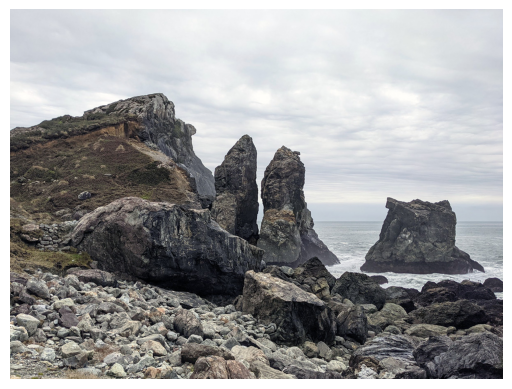

In [2]:
# Get test image
from tensorflow import keras
import matplotlib.pyplot as plt

base_image_path = keras.utils.get_file(
    "coast.jpg", origin="https://img-datasets.s3.amazonaws.com/coast.jpg")

plt.axis("off")
plt.imshow(keras.utils.load_img(base_image_path))

In [3]:
# Instantiating a pretrained InceptionV3 model
from tensorflow.keras.applications import inception_v3
model = inception_v3.InceptionV3(weights="imagenet", include_top=False)

model.summary()

2024-05-13 20:18:36.878381: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2
2024-05-13 20:18:36.878405: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2024-05-13 20:18:36.878411: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2024-05-13 20:18:36.878486: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-05-13 20:18:36.878772: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


87910968/87910968 [==============================] - 2s 0us/step
Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, None, None, 32)       96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activatio

In [4]:
# Configure the contribution of each layer to the DeepDream loss
layer_settings = {
    "mixed4": 1.0,
    "mixed5": 1.5,
    "mixed6": 2.0,
    "mixed7": 2.5,
}

outputs_dict = dict([
    (layer.name, layer.output) 
    for layer in [model.get_layer(name)
                 for name in layer_settings.keys()]
])

feature_extractor = keras.Model(inputs=model.inputs, outputs=outputs_dict)

In [5]:
# The deepDream loss
def compute_loss(input_image):
    features = feature_extractor(input_image)
    loss = tf.zeros(shape=())
    for name in features.keys():
        coeff = layer_settings[name]
        activation = features[name]
        loss += coeff + tf.reduce_mean(tf.square(activation[:, 2:-2, 2:-2, :]))
    return loss

In [6]:
# The DeepDream gradient ascent process
import tensorflow as tf

@tf.function
def gradient_ascent_step(image, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(image)
        loss = compute_loss(image)
    grads = tape.gradient(loss, image)
    grads = tf.math.l2_normalize(grads)
    image += learning_rate * grads
    return loss, image

def gradient_ascent_loop(image, iterations, learning_rate, max_loss=None):
    for i in range(iterations):
        loss, image = gradient_ascent_step(image, learning_rate)
        if max_loss is not None and loss > max_loss:
            break
        print(f"... Loss valut at stop {i}: {loss:.2f}")
    return image

In [7]:
# Image processing utilities
import numpy as np

def preprocess_image(image_path):
    img = keras.utils.load_img(image_path)
    img = keras.utils.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = keras.applications.inception_v3.preprocess_input(img)
    return img

def deprocess_image(img):
    img = img.reshape((img.shape[1], img.shape[2], 3))
    img /= 2.0
    img += 0.5
    img *= 255.
    img = np.clip(img, 0, 255).astype("uint8")
    return img

In [10]:
step = 20
num_octave = 3
octave_scale = 1.4
iterations = 30
max_loss = 15.

original_img = preprocess_image(base_image_path)
original_shape = original_img.shape[1:3]

successive_shapes = [original_shape]
for i in range(1, num_octave):
    shape = tuple([int(dim / (octave_scale ** i)) for dim in original_shape])
    successive_shapes.append(shape)
successive_shapes = successive_shapes[::-1]

shrunk_original_img = tf.image.resize(original_img, successive_shapes[0])

img = tf.identity(original_img)
for i, shape in enumerate(successive_shapes):
    print(f"Processing octave {i} with shape {shape}")
    img = tf.image.resize(img, shape)
    img = gradient_ascent_loop(img, iterations=iterations, learning_rate=step, max_loss=max_loss)
    upscaled_shrunk_original_img = tf.image.resize(shrunk_original_img, shape)
    same_size_original = tf.image.resize(original_img, shape)
    lost_detial = same_size_original - upscaled_shrunk_original_img
    img += lost_detial
    shrunk_original_img = tf.image.resize(original_img, shape)

keras.utils.save_img("dream.png", deprocess_image(img.numpy()))

Processing octave 0 with shape (459, 612)


2024-05-13 20:36:49.264582: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


... Loss valut at stop 0: 7.53
... Loss valut at stop 1: 7.71
... Loss valut at stop 2: 7.97
... Loss valut at stop 3: 8.25
... Loss valut at stop 4: 8.52
... Loss valut at stop 5: 8.78
... Loss valut at stop 6: 9.05
... Loss valut at stop 7: 9.32
... Loss valut at stop 8: 9.62
... Loss valut at stop 9: 9.90
... Loss valut at stop 10: 10.19
... Loss valut at stop 11: 10.47
... Loss valut at stop 12: 10.78
... Loss valut at stop 13: 11.06
... Loss valut at stop 14: 11.37
... Loss valut at stop 15: 11.65
... Loss valut at stop 16: 11.93
... Loss valut at stop 17: 12.20
... Loss valut at stop 18: 12.48
... Loss valut at stop 19: 12.77
... Loss valut at stop 20: 13.02
... Loss valut at stop 21: 13.31
... Loss valut at stop 22: 13.59
... Loss valut at stop 23: 13.86
... Loss valut at stop 24: 14.12
... Loss valut at stop 25: 14.39
... Loss valut at stop 26: 14.61
... Loss valut at stop 27: 14.88
Processing octave 1 with shape (642, 857)
... Loss valut at stop 0: 8.04
... Loss valut at stop 

## 12.3 Neural style transfer

In [64]:
# Get the style and content images
from tensorflow import keras

base_image_path = keras.utils.get_file(
    "sf.jpg", origin="https://img-datasets.s3.amazonaws.com/sf.jpg")
style_reference_image_path = keras.utils.get_file(
    "starry_night.jpg", origin="https://img-datasets.s3.amazonaws.com/starry_night.jpg")

original_width, original_height = keras.utils.load_img(base_image_path).size
img_height = 400
img_width = round(original_width * img_height / original_height)  # resize dimension

In [84]:
# Auxiliary functions to load, preprocess and postprocess the images for VGG19
import numpy as np

def preprocess_image(image_path):
    img = keras.utils.load_img(image_path, target_size=(img_height, img_width))
    img = keras.utils.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = keras.applications.vgg19.preprocess_input(img)
    return img

def deprocess_image(img):
    img = img.reshape((img_height, img_width, 3))
    img[:, :, 0] += 103.939
    img[:, :, 1] += 116.779
    img[:, :, 2] += 123.68
    img = img[:, :, ::-1]

    #  # Check for NaN values
    # nan_mask = np.isnan(img)
    # if nan_mask.any():
    #     print("Warning: NaN values detected after channel reversal:")
    #     print(np.where(nan_mask))  # Print indices of NaN values

    # # Check for negative values
    # neg_mask = img < 0
    # if neg_mask.any():
    #     print("Warning: Negative values detected after channel reversal:")
    #     print(np.where(neg_mask))  # Print indices of negative values
    
    img = np.clip(img, 0, 255).astype("uint8")
    return img

base_image = preprocess_image(base_image_path)
style_reference_image = preprocess_image(style_reference_image_path)
combination_image = tf.Variable(preprocess_image(base_image_path))

In [85]:
# Use a pretrained VGG19 model to create a feature extractor
model = keras.applications.vgg19.VGG19(weights="imagenet", include_top=False)
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])
feature_extractor = keras.Model(inputs=model.inputs, outputs=outputs_dict)
feature_extractor.summary()

Model: "model_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0   

In [86]:
# calcualte content loss function, and style loss function
def content_loss(base_img, combination_img):
    return tf.reduce_sum(tf.square(combination_img - base_img))

def gram_matrix(x):
    x = tf.transpose(x, (2, 0, 1))
    features = tf.reshape(x, (tf.shape(x)[0], -1))
    gram = tf.matmul(features, tf.transpose(features))
    return gram

def style_loss(style_img, combination_img):
    S = gram_matrix(style_img)
    C = gram_matrix(combination_img)
    channels = 3
    size = img_height * img_width
    return tf.reduce_sum(tf.square(S - C)) / (4.0 * (channels  ** 2) * (size ** 2))

def total_variation_loss(x):
    a = tf.square(
        x[:, : img_height - 1, : img_width - 1, :] - x[:, 1:, : img_width - 1, :]
    )
    b = tf.square(
        x[:, : img_height - 1, : img_width - 1, :] - x[:, : img_height - 1, 1:, :]
    )
    return tf.reduce_sum(tf.pow(a + b, 1.25))

In [87]:
# Define the final loss that the model will minimize
style_layer_names = [
    "block1_conv1",
    "block2_conv1",
    "block3_conv1",
    "block4_conv1",
    "block5_conv1",
]
content_layer_name = "block5_conv2"
total_variation_weight = 1e-6
style_weight = 1e-6
content_weight = 2.5e-8

def compute_loss(combination_image, base_image, style_reference_image):
    input_tensor = tf.concat(
        [base_image, style_reference_image, combination_image], axis=0
    )
    features = feature_extractor(input_tensor)
    loss = tf.zeros(shape=())
    layer_features = features[content_layer_name]
    base_img_features = layer_features[0, :, :, :]
    combination_features = layer_features[2, :, :, :]
    loss = loss + content_weight * content_loss(base_img_features, combination_features)
    for layer_name in style_layer_names:
        layer_featuers = features[layer_name]
        style_reference_features = layer_featuers[1, :, :, :]
        combination_features = layer_featuers[2, :, :, :]
        style_loss_value = style_loss(style_reference_features, combination_features)
        loss += (style_weight / len(style_layer_names)) * style_loss_value

    loss += total_variation_weight * total_variation_loss(combination_image)
    return loss

In [88]:
# setup the gradient-descent process
import tensorflow as tf

@tf.function
def compute_loss_and_grads(combination_image, base_image, style_reference_image):
    with tf.GradientTape() as tape:
        loss = compute_loss(combination_image, base_image, style_reference_image)
    grads = tape.gradient(loss, combination_image)
    return loss, grads

optimizer = keras.optimizers.legacy.SGD(
    keras.optimizers.schedules.ExponentialDecay(
        initial_learning_rate=100.0, decay_steps=100, decay_rate=0.96
    )
)

base_image = preprocess_image(base_image_path)
style_reference_image = preprocess_image(style_reference_image_path)
combination_image = tf.Variable(preprocess_image(base_image_path))

iterations = 4000
for i in range(1, iterations + 1):
    loss, grads = compute_loss_and_grads(combination_image, base_image, style_reference_image)
    optimizer.apply_gradients([(grads, combination_image)])
    if i % 100 == 0:
        print(f"Iteration {i}: loss={loss:.2f}")
        img = deprocess_image(combination_image.numpy())
        fname = f"combination_image_at_iteration_{i}.png"
        keras.utils.save_img(fname, img)

Iteration 100: loss=8137.15
Iteration 200: loss=6651.84
Iteration 300: loss=6062.16
Iteration 400: loss=5741.23
Iteration 500: loss=5535.03
Iteration 600: loss=5389.21
Iteration 700: loss=5279.75
Iteration 800: loss=5194.02
Iteration 900: loss=5124.94
Iteration 1000: loss=5068.06
Iteration 1100: loss=5020.24
Iteration 1200: loss=4979.46
Iteration 1300: loss=4944.22
Iteration 1400: loss=4913.38
Iteration 1500: loss=4886.25
Iteration 1600: loss=4862.18
Iteration 1700: loss=4840.65
Iteration 1800: loss=4821.34
Iteration 1900: loss=4803.91
Iteration 2000: loss=4788.12
Iteration 2100: loss=4773.84
Iteration 2200: loss=4760.83
Iteration 2300: loss=4748.89
Iteration 2400: loss=4737.90
Iteration 2500: loss=4727.73
Iteration 2600: loss=4718.29
Iteration 2700: loss=4709.56
Iteration 2800: loss=4701.48
Iteration 2900: loss=4693.94
Iteration 3000: loss=4686.93
Iteration 3100: loss=4680.40
Iteration 3200: loss=4674.28
Iteration 3300: loss=4668.53
Iteration 3400: loss=4663.13
Iteration 3500: loss=46

## 12.4 Generaing images with variational autoencoders

In [107]:
# VAE encoder network
# from tensorflow import keras
# from tensorflow.keras import layers

# latent_dim = 2

# encoder_inputs = keras.Input(shape=(28, 28, 1))
# x = layers.Conv2D(32, 3, activation="relu", strides=2, padding="same")(encoder_inputs)
# x = layers.Conv2D(64, 3, activation="relu", strides=2, padding="same")(x)
# x = layers.Flatten()(x)
# x = layers.Dense(16, activation="relu")(x)
# z_mean = layers.Dense(latent_dim, name="z_mean")(x)
# z_log_var = layers.Dense(latent_dim, name="z_log_var")(x)
# encoder = keras.Model(encoder_inputs, [z_mean, z_log_var], name="encoder")

# encoder.summary()


from tensorflow import keras
from tensorflow.keras import layers

latent_dim = 2

encoder_inputs = keras.Input(shape=(28, 28, 1))
x = layers.Conv2D(32, 3, activation="relu", strides=2, padding="same")(encoder_inputs)
x = layers.Conv2D(64, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Flatten()(x)
x = layers.Dense(16, activation="relu")(x)
z_mean = layers.Dense(latent_dim, name="z_mean")(x)
z_log_var = layers.Dense(latent_dim, name="z_log_var")(x)
encoder = keras.Model(encoder_inputs, [z_mean, z_log_var], name="encoder")

In [108]:
# Latent-space-sampling layer
# import tensorflow as tf

# class Sampler(layers.Layer):
#     def call(self, z_mean, z_log_var):
#         batch_size = tf.shape(z_mean)[0]
#         z_size = tf.shape(z_mean)[1]
#         epsilon = tf.random.normal(shape=(batch_size, z_size))
#         return z_mean + tf.exp(0.5 * z_log_var) * epsilon


import tensorflow as tf

class Sampler(layers.Layer):
    def call(self, z_mean, z_log_var):
        batch_size = tf.shape(z_mean)[0]
        z_size = tf.shape(z_mean)[1]
        epsilon = tf.random.normal(shape=(batch_size, z_size))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

In [109]:
# VAE decoder network, mapping latent space points to images
# latent_inputs = keras.Input(shape=(latent_dim,))
# x = layers.Dense(7 * 7 * 64, activation="relu")(latent_inputs)
# x = layers.Reshape((7, 7, 64))(x)
# x = layers.Conv2DTranspose(64, 3, activation="relu", strides=2, padding="same")(x)
# x = layers.Conv2DTranspose(32, 3, activation="relu", strides=2, padding="same")(x)
# decoder_outputs = layers.Conv2D(1, 3, activation="sigmoid", padding="same")(x)
# decoder = keras.Model(latent_inputs, decoder_outputs, name="decoder")

# decoder.summary()


latent_inputs = keras.Input(shape=(latent_dim,))
x = layers.Dense(7 * 7 * 64, activation="relu")(latent_inputs)
x = layers.Reshape((7, 7, 64))(x)
x = layers.Conv2DTranspose(64, 3, activation="relu", strides=2, padding="same")(x)
x = layers.Conv2DTranspose(32, 3, activation="relu", strides=2, padding="same")(x)
decoder_outputs = layers.Conv2D(1, 3, activation="sigmoid", padding="same")(x)
decoder = keras.Model(latent_inputs, decoder_outputs, name="decoder")

In [110]:
# VAE model with custom train_step
# class VAE(keras.Model):
#     def __init__(self, encoder, decoder, **kwargs):
#         super().__init__(**kwargs)
#         self.encoder = encoder
#         self.decoder = decoder
#         self.sampler = Sampler()
#         self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
#         self.reconstruction_loss_tracker = keras.metrics.Mean(name="reconstruction_loss")
#         self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")

#     @property
#     def metrics(self):
#         return [self.total_loss_tracker, self.reconstruction_loss_tracker, self.kl_loss_tracker]

#     def train_step(self, data):
#         with tf.GradientTape() as tape:
#             z_mean, z_log_var = self.encoder(data)
#             z = self.sampler(z_mean, z_log_var)
#             reconstruction = decoder(z)
#             reconstruction_loss = tf.reduce_mean(
#                 tf.reduce_mean(keras.losses.binary_crossentropy(data, reconstruction), axis=(1, 2))
#             )
#             kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
#             total_loss = reconstruction_loss + tf.reduce_mean(kl_loss)
#         grads = tape.gradient(total_loss, self.trainable_weights)
#         self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
#         self.total_loss_tracker.update_state(total_loss)
#         self.reconstruction_loss_tracker.update_state(reconstruction_loss)
#         self.kl_loss_tracker.update_state(kl_loss)
#         return {
#             "total_loss": self.total_loss_tracker.result(),
#             "reconstruction_loss": self.reconstruction_loss_tracker.result(),
#             "kl_loss": self.kl_loss_tracker.result()
#         }


class VAE(keras.Model):
    def __init__(self, encoder, decoder, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.sampler = Sampler()
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = keras.metrics.Mean(
            name="reconstruction_loss")
        self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [self.total_loss_tracker,
                self.reconstruction_loss_tracker,
                self.kl_loss_tracker]

    def train_step(self, data):
        with tf.GradientTape() as tape:
            z_mean, z_log_var = self.encoder(data)
            z = self.sampler(z_mean, z_log_var)
            reconstruction = decoder(z)
            reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                    keras.losses.binary_crossentropy(data, reconstruction),
                    axis=(1, 2)
                )
            )
            kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
            total_loss = reconstruction_loss + tf.reduce_mean(kl_loss)
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {
            "total_loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
        }

In [111]:
# Train the VAE
# import numpy as np

# (x_train, _), (x_test, _) = keras.datasets.mnist.load_data()
# mnist_digits = np.concatenate([x_train, x_test], axis=0)
# mnist_digits = np.expand_dims(mnist_digits, -1).astype("float32") / 255

# vae = VAE(encoder, decoder)
# vae.compile(optimizer=keras.optimizers.legacy.Adam(), run_eagerly=True)
# vae.fit(mnist_digits, epochs=30, batch_size=128)


import numpy as np

(x_train, _), (x_test, _) = keras.datasets.mnist.load_data()
mnist_digits = np.concatenate([x_train, x_test], axis=0)
mnist_digits = np.expand_dims(mnist_digits, -1).astype("float32") / 255

vae = VAE(encoder, decoder)
vae.compile(optimizer=keras.optimizers.Adam(), run_eagerly=True)
vae.fit(mnist_digits, epochs=30, batch_size=128)

Epoch 1/30
547/547 [==============================] - 29s 52ms/step - total_loss: 204.2504 - reconstruction_loss: 200.4222 - kl_loss: 3.8281
Epoch 2/30
547/547 [==============================] - 28s 52ms/step - total_loss: 167.4451 - reconstruction_loss: 163.5557 - kl_loss: 3.8894
Epoch 3/30
547/547 [==============================] - 28s 52ms/step - total_loss: 161.9295 - reconstruction_loss: 158.1501 - kl_loss: 3.7793
Epoch 4/30
547/547 [==============================] - 29s 52ms/step - total_loss: 159.0146 - reconstruction_loss: 155.1855 - kl_loss: 3.8291
Epoch 5/30
547/547 [==============================] - 29s 52ms/step - total_loss: 157.2153 - reconstruction_loss: 153.3732 - kl_loss: 3.8420
Epoch 6/30
547/547 [==============================] - 29s 52ms/step - total_loss: 155.9330 - reconstruction_loss: 152.0609 - kl_loss: 3.8721
Epoch 7/30
547/547 [==============================] - 29s 53ms/step - total_loss: 155.0004 - reconstruction_loss: 151.1446 - kl_loss: 3.8560
Epoch 8/30
54

1/1 [==============================] - 0s 10ms/step


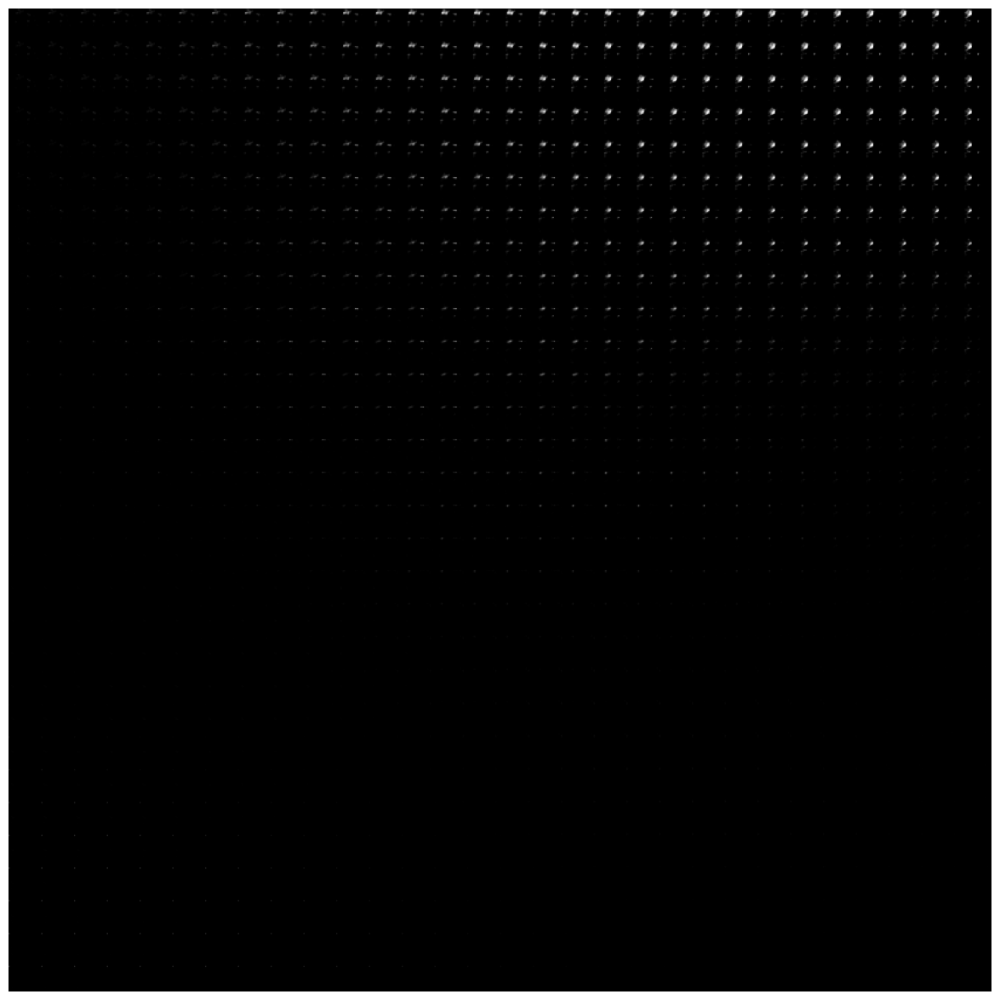

In [113]:
# Sampling a grid of images from the 2D latent space
# import matplotlib.pyplot as pyplotlt

# n = 30
# digit_size = 28
# figure = np.zeros((digit_size * n, digit_size * n))

# grid_x = np.linspace(-1, 1, n)
# grid_y = np.linspace(-1, 1, n)[::-1]

# for i, yi in enumerate(grid_y):
#     for j, xi in enumerate(grid_x):
#         z_sample = np.array([[xi, yi]])
#         x_decoded = vae.decoder.predict(z_sample)
#         digit = x_decoded[0].reshape(digit_size, digit_size)
#         figure[
#             i * digit_size : (i + 1) * digit_size,
#             j * digit_size : (j + 1) * digit_size
#         ] = digit

# plt.figure(figsize=(15, 15))
# start_range = digit_size // 2
# end_range = n * digit_size + start_range
# pixel_range = np.arange(start_range, end_range, digit_size)
# sample_range_x = np.round(grid_x, 1)
# sample_range_y = np.round(grid_y, 1)
# plt.xticks(pixel_range, sample_range_x)
# plt.yticks(pixel_range, sample_range_y)
# plt.xlabel("z[0]")
# plt.ylabel("z[1]")
# plt.axis("off")
# plt.imshow(figure, cmap="Greys_r")


import matplotlib.pyplot as plt

n = 30
digit_size = 28
figure = np.zeros((digit_size * n, digit_size * n))

grid_x = np.linspace(-1, 1, n)
grid_y = np.linspace(-1, 1, n)[::-1]

for i, yi in enumerate(grid_y):
    for j, xi in enumerate(grid_x):
        z_sample = np.array([[xi, yi]])
        x_decoded = vae.decoder.predict(z_sample)
        digit = x_decoded[0].reshape(digit_size, digit_size)
        figure[
            i * digit_size : (i + 1) * digit_size,
            j * digit_size : (j + 1) * digit_size,
        ] = digit

plt.figure(figsize=(15, 15))
start_range = digit_size // 2
end_range = n * digit_size + start_range
pixel_range = np.arange(start_range, end_range, digit_size)
sample_range_x = np.round(grid_x, 1)
sample_range_y = np.round(grid_y, 1)
plt.xticks(pixel_range, sample_range_x)
plt.yticks(pixel_range, sample_range_y)
plt.xlabel("z[0]")
plt.ylabel("z[1]")
plt.axis("off")
plt.imshow(figure, cmap="Greys_r")

## 12.5 Generative adversarial networks

In [114]:
!pip install gdown
!mkdir ../datasets/celeba_gan
!gdown --id 1O7m1010EJjLE5QxLZiM9Fpjs7Oj6e684 -O ../datasets/celeba_gan/data.zip
!unzip -qq ../datasets/celeba_gan/data.zip -d ../datasets/celeba_gan

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 1.1 MB/s eta 0:00:00 MB/s eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.3/78.3 kB 3.5 MB/s eta 0:00:00
/Volumes/App/micromamba/envs/jupyter_py31014_tf2161_GPU/lib/python3.10/site-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1O7m1010EJjLE5QxLZiM9Fpjs7Oj6e684
From (redirected): https://drive.google.com/uc?id=1O7m1010EJjLE5QxLZiM9Fpjs7Oj6e684&confirm=t&uuid=09d4790e-9fc7-4ac3-89d0-8902298a0a82
To: /Volumes/App/jupyter/datasets/celeba_gan/data.zip
100%|██████████████████████████████████████| 1.44G/1.44G [01:06<00:00, 21.6MB/s]


In [2]:
# create a dataset form a directory of images
from tensorflow import keras

dataset = keras.utils.image_dataset_from_directory(
    "../datasets/celeba_gan",
    label_mode=None,
    image_size=(64, 64), 
    batch_size=32,
    smart_resize=True)

# rescale image to [0-1] range
dataset = dataset.map(lambda x: x / 255.)

Found 202599 files belonging to 1 classes.


(32, 64, 64, 3)


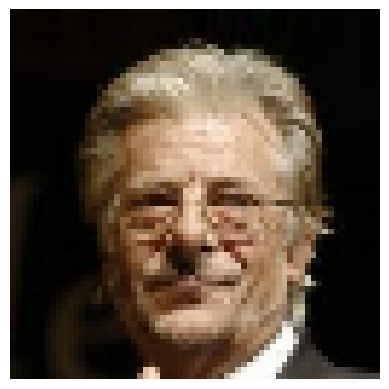

In [7]:
# display a sample image
import matplotlib.pyplot as plt

for batch in dataset.take(1):
    print(batch.shape)

for img_batch in dataset:
    img = img_batch[0]
    img = (img.numpy() * 255).astype("int32")
    plt.axis("off")
    plt.imshow(img)
    # plt.imshow((x.numpy() * 255).astype("int32")[0])
    break

In [119]:
# The GAN discriminator network
from tensorflow.keras import layers

discriminator = keras.Sequential(
    [
        keras.Input(shape=(64, 64, 3)),
        layers.Conv2D(64, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2D(128, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2D(128, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Flatten(),
        layers.Dropout(0.2),
        layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator",
)

discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_102 (Conv2D)         (None, 32, 32, 64)        3136      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_103 (Conv2D)         (None, 16, 16, 128)       131200    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_104 (Conv2D)         (None, 8, 8, 128)         262272    
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 8, 8, 128)         0         
                                                                 
 flatten_3 (Flatten)         (None, 8192)            

In [120]:
# GAN generator network
latent_dim = 128

generator = keras.Sequential(
    [
        keras.Input(shape=(latent_dim,)),
        layers.Dense(8 * 8 *128),
        layers.Reshape((8, 8, 128)),
        layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2DTranspose(512, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(alpha=0.2),
        layers.Conv2D(3, kernel_size=5, padding="same", activation="sigmoid"),
    ],
    name="generator",
)

generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 8192)              1056768   
                                                                 
 reshape_2 (Reshape)         (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose_4 (Conv2D  (None, 16, 16, 128)       262272    
 Transpose)                                                      
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_transpose_5 (Conv2D  (None, 32, 32, 256)       524544    
 Transpose)                                                      
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 32, 32, 256)       0 

In [136]:
# The GAN model
import tensorflow as tf

class GAN(keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_loss_metric = keras.metrics.Mean(name="d_loss")
        self.g_loss_metric = keras.metrics.Mean(name="g_loss")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(GAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        generated_images = self.generator(random_latent_vectors)
        combined_images = tf.concat([generated_images, real_images], axis=0)
        labels = tf.concat(
            [tf.ones((batch_size, 1)), tf.zeros((batch_size, 1))],
            axis=0
        )
        labels += 0.05 * tf.random.uniform(tf.shape(labels))

        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            d_loss = self.loss_fn(labels, predictions)
        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        random_latent_vectors = tf.random.normal(
            shape=(batch_size, self.latent_dim)
        )
        
        misleading_labels = tf.zeros((batch_size, 1))

        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)
        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        return {"d_loss": self.d_loss_metric.result(),
                "g_loss": self.g_loss_metric.result()}

In [8]:
# A callback that samples generated images during training
class GANMonitor(keras.callbacks.Callback):
    def __init__(self, num_img=3, latent_dim=128):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(shape=(self.num_img, self.latent_dim))
        generated_images = self.model.generator(random_latent_vectors)
        generated_images *= 255
        generated_images.numpy()

        if epoch % 10 == 0:
            for i in range(self.num_img):
                img = keras.utils.array_to_img(generated_images[i])
                img.save(f"generated_img_{epoch:03d}_{i}.png")
                break

In [139]:
# Compiling and training the GAN
epochs = 10

gan = GAN(discriminator=discriminator, generator=generator, latent_dim=latent_dim)

gan.compile(
    d_optimizer=keras.optimizers.legacy.Adam(learning_rate=0.0001),
    g_optimizer=keras.optimizers.legacy.Adam(learning_rate=0.0001),
    loss_fn=keras.losses.BinaryCrossentropy(),
)

gan.fit(
    dataset, epochs=epochs,
    callbacks=[GANMonitor(num_img=10, latent_dim=latent_dim)]
)

Epoch 1/10
6332/6332 [==============================] - 5616s 887ms/step - d_loss: 0.6832 - g_loss: 0.9784
Epoch 2/10
6332/6332 [==============================] - 5521s 872ms/step - d_loss: 0.7142 - g_loss: 0.8458
Epoch 3/10
6332/6332 [==============================] - 5522s 872ms/step - d_loss: 0.7182 - g_loss: 0.8263
Epoch 4/10
6332/6332 [==============================] - 5523s 872ms/step - d_loss: 0.7204 - g_loss: 0.8231
Epoch 5/10
6332/6332 [==============================] - 5522s 872ms/step - d_loss: 0.7173 - g_loss: 0.8105
Epoch 6/10
6332/6332 [==============================] - 5523s 872ms/step - d_loss: 0.7191 - g_loss: 0.8121
Epoch 7/10
6332/6332 [==============================] - 5520s 872ms/step - d_loss: 0.7166 - g_loss: 0.8059
Epoch 8/10
6332/6332 [==============================] - 5522s 872ms/step - d_loss: 0.7200 - g_loss: 0.8109
Epoch 9/10
6332/6332 [==============================] - 5528s 873ms/step - d_loss: 0.7232 - g_loss: 0.8032
Epoch 10/10
6332/6332 [==============

# CH13 Best practices for the real world

### 13.1.1 Hyperparameter optimization

In [26]:
# install kkeras-tuner
!pip install keras-tuner -q
# !pip install keras-tuner[bayesian]

In [4]:
# a kerastuner model-building function
from tensorflow import keras
from tensorflow.keras import layers

def build_model(hp):
    units = hp.Int(name="units", min_value=16, max_value=64, step=16)
    model = keras.Sequential([
        layers.Dense(units, activation="relu"),
        layers.Dense(10, activation="softmax")
    ])
    optimizer = hp.Choice(name="optimizer", values=["rmsprop", "adam"])
    model.compile(
        optimizer=optimizer,
        loss="sparse_categorical_crossentropy",
        metrics=["accuracy"]
    )
    return model

In [5]:
# Alternative way by subclassing kerasTuner HyperModel
import keras_tuner as kt

class SimpleMLP(kt.HyperModel):
    def __init__(self, num_calsses):
        self.num_calsses = num_calsses

    def build(self, hp):
        units = hp.Int(name="units", min_value=16, max_value=64, step=16)
        model = keras.Sequential([
            layers.Dense(units, activation="relu"),
            layers.Dense(self.num_calsses, activation="softmax")
        ])
        optimizer = hp.Choice(name="optimizer", values=["rmsprop", "adam"])
        model.compile(
            optimizer=optimizer,
            loss="sparse_categorical_crossentropy",
            metrics=["accuracy"]
        )
        return model

In [6]:
tuner = kt.BayesianOptimization(
    build_model,
    objective="val_accuracy",
    max_trials=100,
    executions_per_trial=12,
    directory="mnist_kt_test",
    overwrite=True,
)

tuner.search_space_summary()

Search space summary
Default search space size: 2
units (Int)
{'default': None, 'conditions': [], 'min_value': 16, 'max_value': 64, 'step': 16, 'sampling': 'linear'}
optimizer (Choice)
{'default': 'rmsprop', 'conditions': [], 'values': ['rmsprop', 'adam'], 'ordered': False}


In [7]:
# launch the search
(x_train, y_train), (x_test, y_test) = keras.datasets.mnist.load_data()
x_train = x_train.reshape((-1, 28 * 28)).astype("float32") / 255
x_test = x_test.reshape((-1, 28 * 28)).astype("float32") / 255
x_train_full = x_train[:]
y_train_full = y_train[:]
num_val_samples = 10000
x_train, x_val = x_train[:-num_val_samples], x_train[-num_val_samples:]
y_train, y_val = y_train[:-num_val_samples], y_train[-num_val_samples:]
callbacks = [
    keras.callbacks.EarlyStopping(monitor="val_loss", patience=5),
]

tuner.search(
    x_train, y_train,
    batch_size=128,
    epochs=100,
    validation_data=(x_val, y_val),
    callbacks=callbacks,
    verbose=2,
)

Trial 100 Complete [00h 08m 23s]
val_accuracy: 0.9751499891281128

Best val_accuracy So Far: 0.9757250001033148
Total elapsed time: 12h 36m 17s


In [ ]:
# query the best hyperparameter confibgurations
top_n = 4
best_hps = tuner.get_best_hyperparameters(top_n)

In [ ]:
# estimat the best number of epochs
def get_best_epoch(hp):
    model = build_model(hp)
    callbacks = [
        keras.EarlyStopping(
            monitor="val_loss", mode="min", patience=10
        )
    ]

    history = model.fit(
        x_train, y_train,
        validation_data=(x_val, y_val),
        epochs=100,
        batch_size=128,
        callbacks=callbacks
    )
    val_loss_per_epoch = history.history["val_loss"]
    best_epoch = val_loss_per_epoch.index(min(val_loss_per_epoch)) + 1
    print(f"Best epoch: {best_epoch}")
    return best_epoch

In [ ]:
# Train on the full dataset with learning hyper paprameters
def get_best_trained_model(hp):
    best_epoch = get_best_epoch(hp)
    model.fit(
        x_train_full, y_train_full,
        batch_size=128, epochs=int(best_epoch * 1.2)
    )
    return model

best_models = []
for hp in best_hps:
    model = get_best_trained_model(hp)
    model.evaluate(x_test, y_train_full)
    best_modelsmo.append(model)


## Shortcut, use tuner to reload the top-performaing models saved during hp training
# best_models = tuner.get_best_modesl(top_n)

### 13.1.2 Model ensembling

In [ ]:
# Ensemble the classifiers by averaging the predictions at inference time
preds_a = model_a.predict(x_val)
preds_b = model_b.predict(x_val)
preds_c = model_c.predict(x_val)
preds_d = model_d.predict(x_val)
final_preds = 0.25 * (preds_a + preds_b + preds_c + preds_c)                   # equal weights
final_preds = 0.5 * preds_a + 0.25 * preds_b + 0.1 * preds_c + 0.15 * preds_c  # weighted average, where the weights are learned on validatioan data

### 13.2.1 Mixed precision to speedup training on GPU

In [ ]:
from tensorflow import keras
keras.mixed_precision.set_global_policy("mixed_float16")